# load data

In [1]:
%load_ext autoreload
# %autoreload 2

%matplotlib inline

import dask
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import seawater as sw
%aimport xarray
import xarray as xr

# import hvplot.xarray

%aimport dcpy
%aimport pump

# import facetgrid

mpl.rcParams["savefig.dpi"] = 300
mpl.rcParams["savefig.bbox"] = "tight"
mpl.rcParams["figure.dpi"] = 120

xr.set_options(keep_attrs=False)

import distributed
import dask_jobqueue
          
from distributed import performance_report

print(dask.__version__)
print(distributed.__version__)
print(xr.__version__)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
2.9.1
2.9.1
0.14.0+145.ga834dde4


In [2]:
if "client" in locals():
    client.close()
    cluster.close()

env = {"OMP_NUM_THREADS": "3",
       "NUMBA_NUM_THREADS": "3"}
cluster = distributed.LocalCluster(
    n_workers=12,   
    threads_per_worker=1, 
    env=env
                  
)
#cluster = dask_jobqueue.SLURMCluster(
#    cores=1, processes=1, memory="25GB", walltime="02:00:00", project="NCGD0011"
#)
#cluster = dask_jobqueue.PBSCluster(
#    cores=9, processes=9, memory="108GB", walltime="02:00:00", project="NCGD0043",
#    env_extra=env,
#)

client = distributed.Client(cluster)
cluster

In [ ]:
# cluster.adapt(minimum_jobs=1, maximum_jobs=12, wait_count=300)

In [3]:
gcm1 = pump.model(
    "../glade/TPOS_MITgcm_1_hb/HOLD_NC_LINKS/", name="gcm1", full=True, budget=False,
)
# gcm1.tao.load()
# gcm1.tao = xr.merge([gcm1.tao, pump.calc.get_tiw_phase(gcm1.tao.v)])
gcm1.surface["zeta"] = xr.open_dataset(
    gcm1.dirname + "obs_subset/surface_zeta.nc"
).zeta
# gcm1.surface = gcm1.surface.chunk({"time": 1})
# gcm1.surface["zeta"] = gcm1.surface.v.differentiate("longitude") - gcm1.surface.u.differentiate("latitude")

Reading all files took 53.975971937179565 seconds


In [4]:
gcm1.tao["mld"] = pump.calc.get_mld(gcm1.tao.dens)
gcm1.tao["dcl"] = pump.calc.get_dcl_base_Ri(gcm1.tao)

# remake surface file

In [4]:
ds = xr.open_mfdataset(
    "../glade/TPOS_MITgcm_1_hb/HOLD/Day_[0-9][0-9][0-9][0-9].nc",
    engine="h5netcdf",
    coords="minimal",
    compat="override",
    combine="by_coords",
    chunks={"depth": 1},
    parallel=True,
)

In [5]:
ds = ds.chunk({"depth":1, "time": 24})

In [6]:
surface = ds.isel(depth=0)

In [7]:
surface.load()

<xarray.Dataset>
Dimensions:          (latitude: 480, longitude: 1500, time: 2947)
Coordinates:
  * latitude         (latitude) float32 -12.0 -11.949896 ... 11.949896 12.0
    depth            float32 -0.5
  * longitude        (longitude) float32 -170.0 -169.94997 ... -95.05003 -95.0
  * time             (time) datetime64[ns] 1995-09-01 ... 1997-01-04T12:00:00
Data variables:
    theta            (time, latitude, longitude) float32 28.838287 ... 27.546913
    u                (time, latitude, longitude) float32 -0.2352903 ... 0.06463741
    v                (time, latitude, longitude) float32 -0.05014921 ... -0.013393667
    w                (time, latitude, longitude) float32 nan nan nan ... nan nan
    salt             (time, latitude, longitude) float32 34.7925 ... 33.598953
    KPP_diffusivity  (time, latitude, longitude) float32 nan nan nan ... nan nan
Attributes:
    title:              daily snapshot from 1/20 degree Equatorial Pacific MI...
    easting:            longitude
   

In [49]:
import xfilter

filt = xfilter.lowpass(
    gcm1.tao.v,
    coord="time",
    freq=1 / 10,
    cycles_per="D",
    num_discard=0,
)

In [8]:
surface.to_netcdf("../glade/TPOS_MITgcm_1_hb/HOLD/obs_subset/surface.nc")

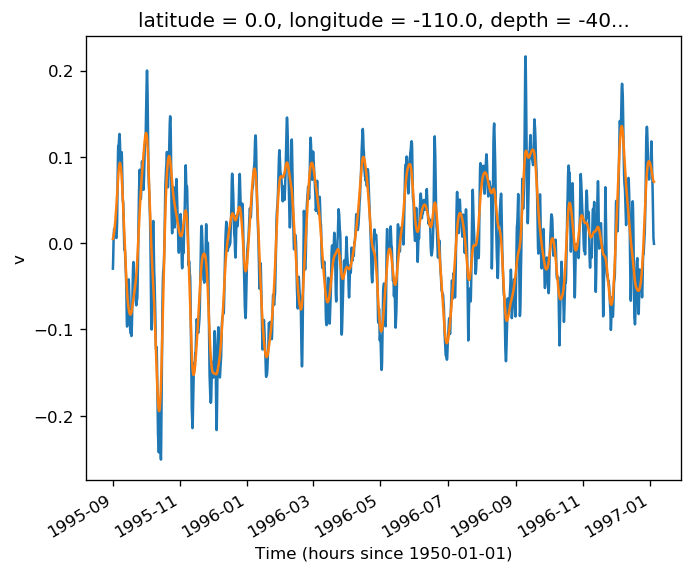

In [50]:
gcm1.tao.v.sel(longitude=-110,  method="nearest").isel(latitude=3, depth=-5).plot()
filt.sel(longitude=-110, method="nearest").isel(latitude=3, depth=-5).plot()

In [10]:
gcm1.surface = gcm1.surface.chunk({"time": 100})
gcm1.surface["zeta"] = gcm1.surface.v.differentiate("longitude") - gcm1.surface.u.differentiate("latitude")

In [76]:
gcm1.surface.zeta.to_netcdf(gcm1.dirname + '/obs_subset/surface_zeta.nc')

/glade/u/home/dcherian/pump/pump/calc.py:359: UserWarning: Secondary peaks detected!
  warnings.warn("Secondary peaks detected!")
/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)
/glade/u/home/dcherian/pump/pump/calc.py:359: UserWarning: Secondary peaks detected!
  warnings.warn("Secondary peaks detected!")


<xarray.Dataset>
Dimensions:    (time: 2947)
Coordinates:
    latitude   float64 0.0
    longitude  float64 -140.0
  * time       (time) datetime64[ns] 1995-09-01 ... 1997-01-04T12:00:00
    variable   <U1 'v'
Data variables:
    tiw_phase  (time) float32 nan nan nan nan nan nan ... nan nan nan nan nan
    period     (time) float32 nan nan nan nan nan ... 19.0 19.0 19.0 19.0 19.0

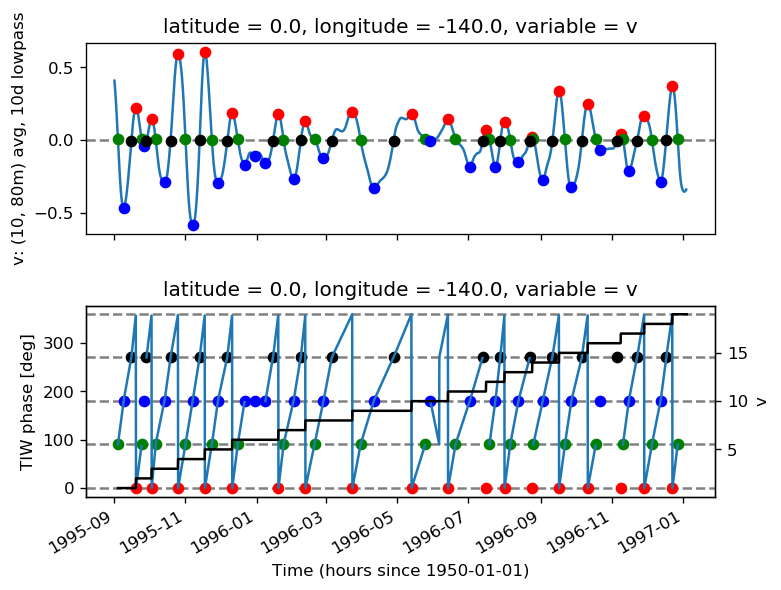

In [6]:
tao0140 = gcm1.tao.sel(latitude=0, longitude=-140)
tao0140 = xr.merge([pump.calc.get_tiw_phase(tao0140.v), tao0140])
surf140 = gcm1.surface.sel(longitude=-140, method="nearest") #.sel(time=slice(None, "1996-01-01"))

pump.calc.get_tiw_phase(tao0140.v, debug=True)

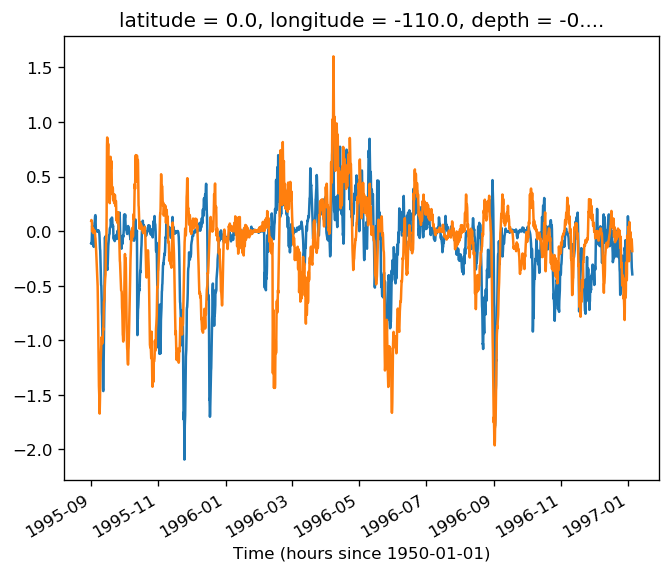

In [33]:
tao = gcm1.tao.sel(latitude=2, longitude=-110)
T = tao.theta.isel(depth=0)
v = tao.v.isel(depth=0)

(v*(T-T.mean('time'))).plot()
#v.plot()
# (T-T.mean("time")).plot()

tao = gcm1.tao.sel(latitude=0, longitude=-110)
T = tao.theta.isel(depth=0)
v = tao.v.isel(depth=0)

(v*(T-T.mean('time'))).plot()
#v.plot()
# (T-T.mean("time")).plot()

# groupby plotting

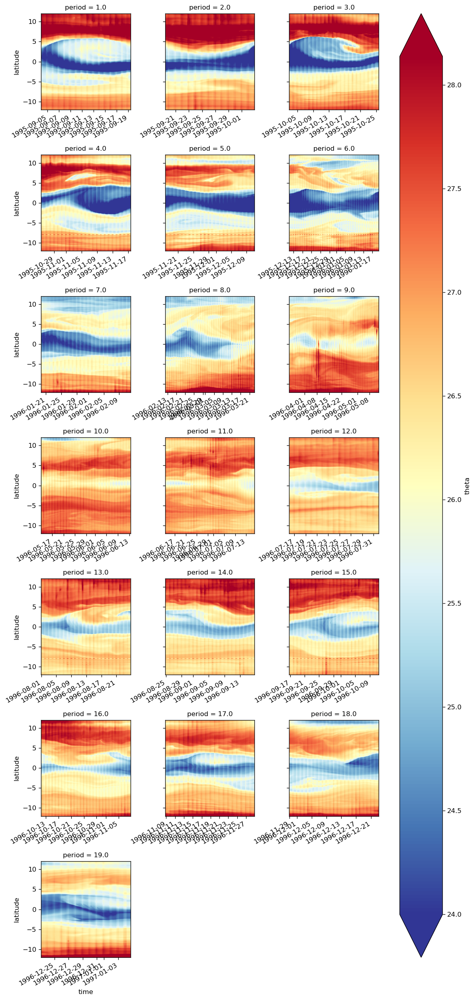

In [25]:
obj = surf140.theta.groupby(tao0140.period)

from xarray import DataArray, Dataset

dim = obj._group_dim
fg = xr.plot.FacetGrid(data=obj, col="period", col_wrap=3, sharex=False, sharey=True)


def map_dataarray_groupby(self, func, x, y, **kwargs):
    from xarray.plot.utils import _process_cmap_cbar_kwargs, _infer_xy_labels
    from xarray.core.utils import peek_at

    if kwargs.get("cbar_ax", None) is not None:
        raise ValueError("cbar_ax not supported by FacetGrid.")

    cmap_params, cbar_kwargs = _process_cmap_cbar_kwargs(
        func, self.data._obj.values, **kwargs
    )

    self._cmap_extend = cmap_params.get("extend")

    # Order is important
    func_kwargs = {
        k: v
        for k, v in kwargs.items()
        if k not in {"cmap", "colors", "cbar_kwargs", "levels"}
    }
    func_kwargs.update(cmap_params)
    func_kwargs.update({"add_colorbar": False, "add_labels": False})

    # Get x, y labels for the first subplot
    x, y = _infer_xy_labels(
        darray=peek_at(self.data._iter_grouped())[0],
        x=x,
        y=y,
        imshow=func.__name__ == "imshow",
        rgb=kwargs.get("rgb", None),
    )

    for (_, subset), ax in zip(self.data, self.axes.flat):
        mappable = func(subset, x=x, y=y, ax=ax, **func_kwargs)
        self._mappables.append(mappable)

    self._finalize_grid(x, y)

    if kwargs.get("add_colorbar", True):
        self.add_colorbar(**cbar_kwargs)

    return self


map_dataarray_groupby(
    fg, xr.plot.pcolormesh, x="time", y="latitude", cmap=mpl.cm.RdYlBu_r, robust=True
)

# Phase average

In [7]:
surf140 = surf140.chunk({"time": 100})

In [16]:
grouped = surf140.where(tao0140.period.isin([1, 3, 4])).groupby_bins(tao0140.tiw_phase, bins=np.arange(0, 360, 5))
avg_surf = grouped.mean()

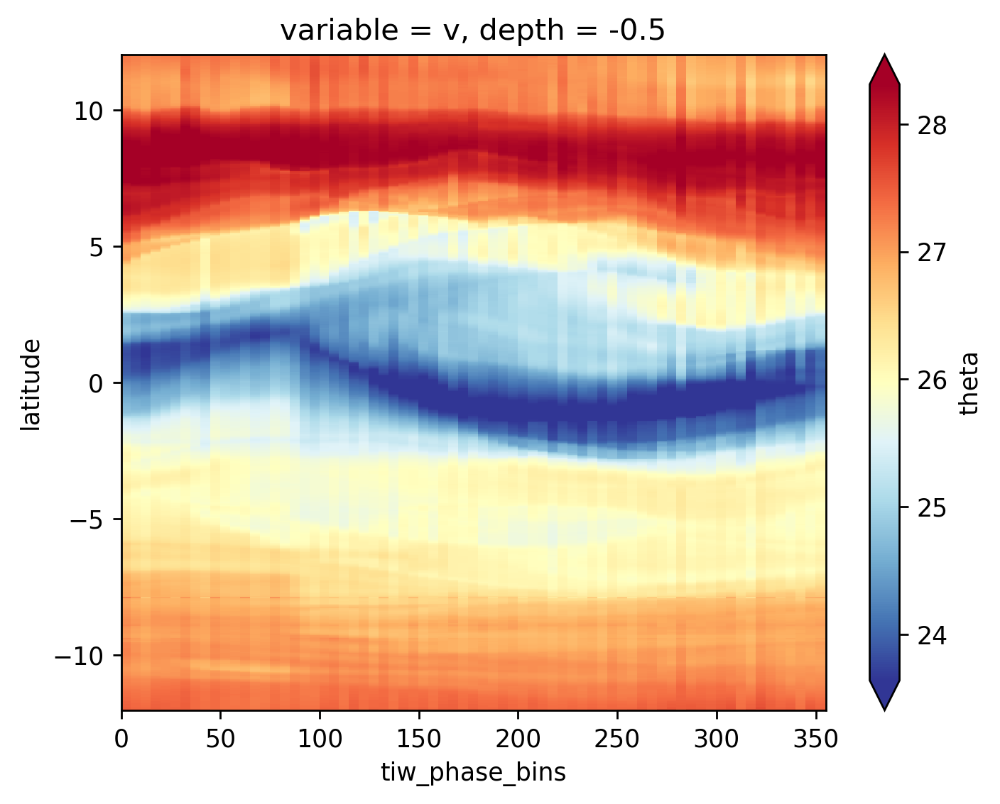

In [85]:
avg_surf.theta.plot(x="tiw_phase_bins", cmap=mpl.cm.RdYlBu_r, robust=True)

# time compositing

In [83]:
tao110 = gcm1.tao.sel(longitude=-110, latitude=0)

In [6]:
subset = surf110.where(tao110.period.isin([4, 5, 6]), drop=True)

grouped = subset.groupby_bins(subset.tiw_phase, bins=np.arange(0, 360, 5))
avg_surf = grouped.mean()

NameError: name 'surf110' is not defined

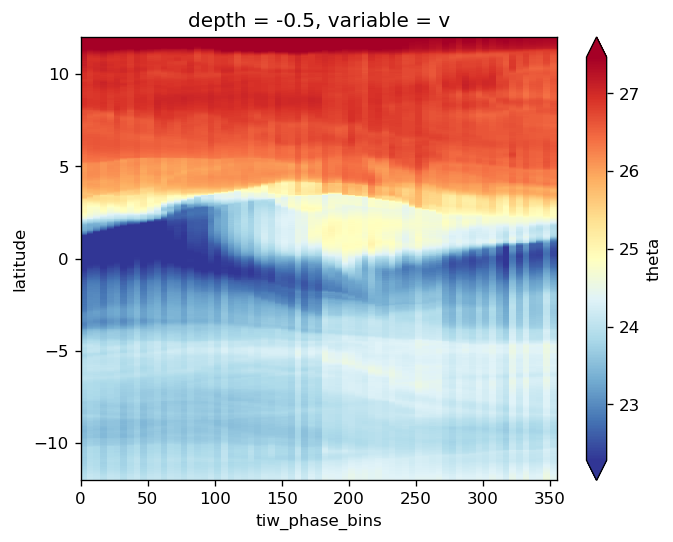

In [354]:
avg_surf.theta.plot(y="latitude", robust=True, cmap=mpl.cm.RdYlBu_r)

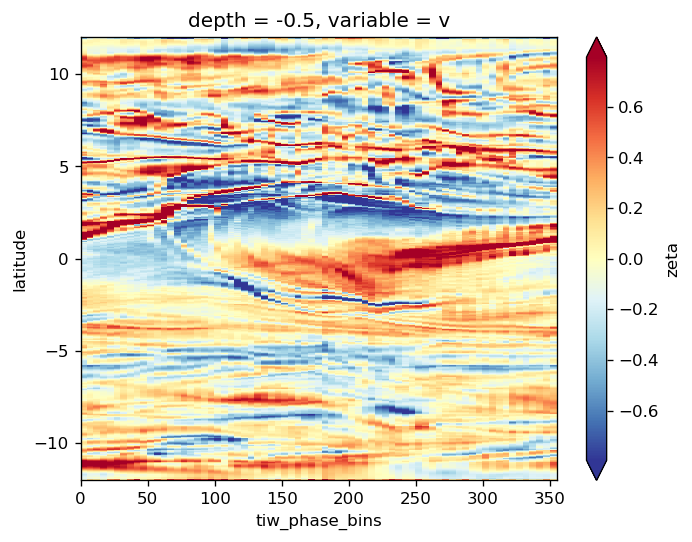

In [355]:
avg_surf.zeta.plot(y="latitude", robust=True, cmap=mpl.cm.RdYlBu_r)

# surface compositing

In [109]:
sst = surf.theta.groupby("period").mean("time")

/gpfs/u/home/dcherian/python/xarray/xarray/core/common.py:664: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, the dimension order of these coordinates will be restored as well unless you specify restore_coord_dims=False.
  self, group, squeeze=squeeze, restore_coord_dims=restore_coord_dims


/gpfs/u/home/dcherian/python/xarray/xarray/core/common.py:674: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, the dimension order of these coordinates will be restored as well unless you specify restore_coord_dims=False.
  self, group, squeeze=squeeze, restore_coord_dims=restore_coord_dims


<IPython.core.display.Javascript object>


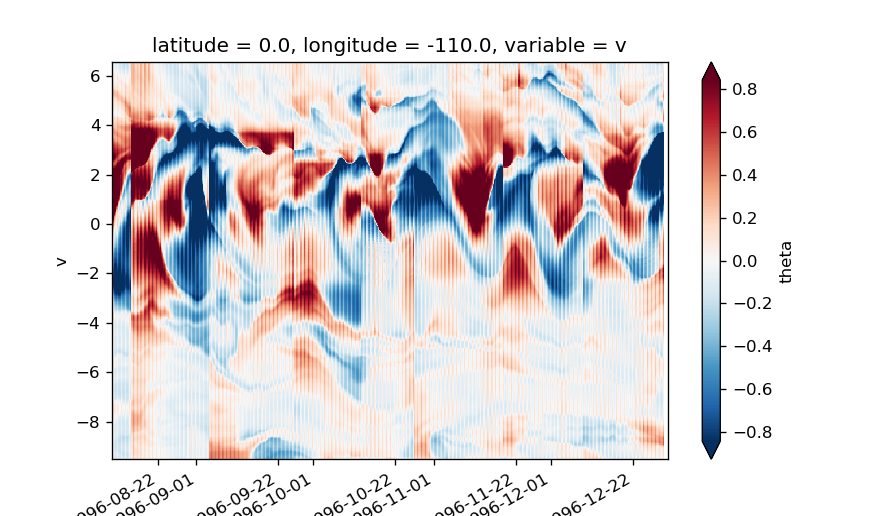

In [58]:
grouped = surf.theta.where(~np.isnan(surf.theta.period), drop=True).groupby("period")
(grouped - grouped.mean("time")).reindex(time=surf.time).plot(x="time", robust=True)

In [4]:
surf = gcm1.surface.theta.sel(longitude=-110, method="nearest").assign_coords(
    gcm1.tao[["tiw_phase", "period"]].sel(longitude=-110, latitude=0, drop=True).variables
)

In [5]:
surf = surf.chunk({"latitude": 20})

In [6]:
tanom = surf.groupby("period") - surf.groupby("period").mean()

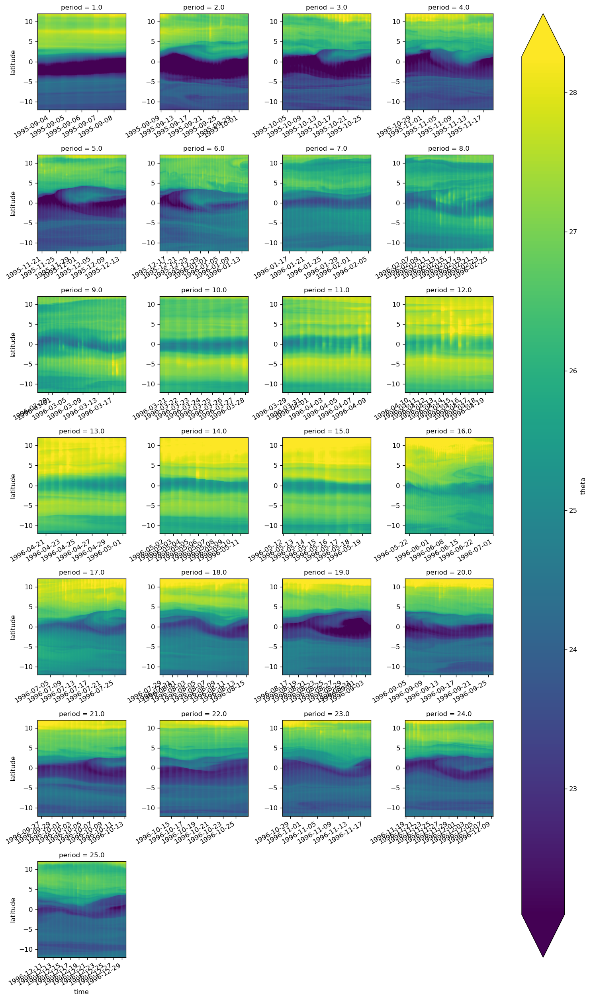

In [7]:
surf.groupby(gcm1.tao.period.sel(longitude=-110, latitude=0)).plot(
    col="period", col_wrap=4, x="time", robust=True
)

In [5]:
gcm1.surface =  gcm1.surface.assign_coords(
    gcm1.tao[["tiw_phase", "period"]].sel(longitude=-110, latitude=0, drop=True).variables
)

KeyError: 'tiw_phase'

In [73]:
obj = gcm1.surface.theta.chunk({"latitude": 60, "longitude": 100})

In [4]:
obj = gcm1.surface.theta.sel(latitude=0, longitude=-110, method="nearest")

In [68]:
gcm1.surface = gcm1.surface.chunk({"latitude": 120, "longitude": 500, "time": 1})

In [102]:
filtufunc = pump.utils.lowpass(gcm1.surface.theta.chunk({"time": None}).fillna(0), "time", freq=0.4, cycles_per="D", use_overlap=False)
filtover = pump.utils.lowpass(gcm1.surface.theta.fillna(0), "time", freq=0.4, cycles_per="D", use_overlap=True)

In [86]:
cluster.scale(24)

In [103]:
dcpy.util.dask_len(filtufunc)

35425

In [77]:
filtered = pump.utils.lowpass(
    gcm1.surface.chunk({"time"L ,
    "time",
    freq=0.5,
    cycles_per="D",
)

## surface variables

In [4]:
sst = gcm1.surface.theta.sel(longitude=[-110, -125, -140], method="nearest")
ssz = gcm1.surface.zeta.sel(longitude=[-110, -125, -140], method="nearest")
sstz = xr.merge([sst, ssz]).load()

/gpfs/u/home/dcherian/python/xarray/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


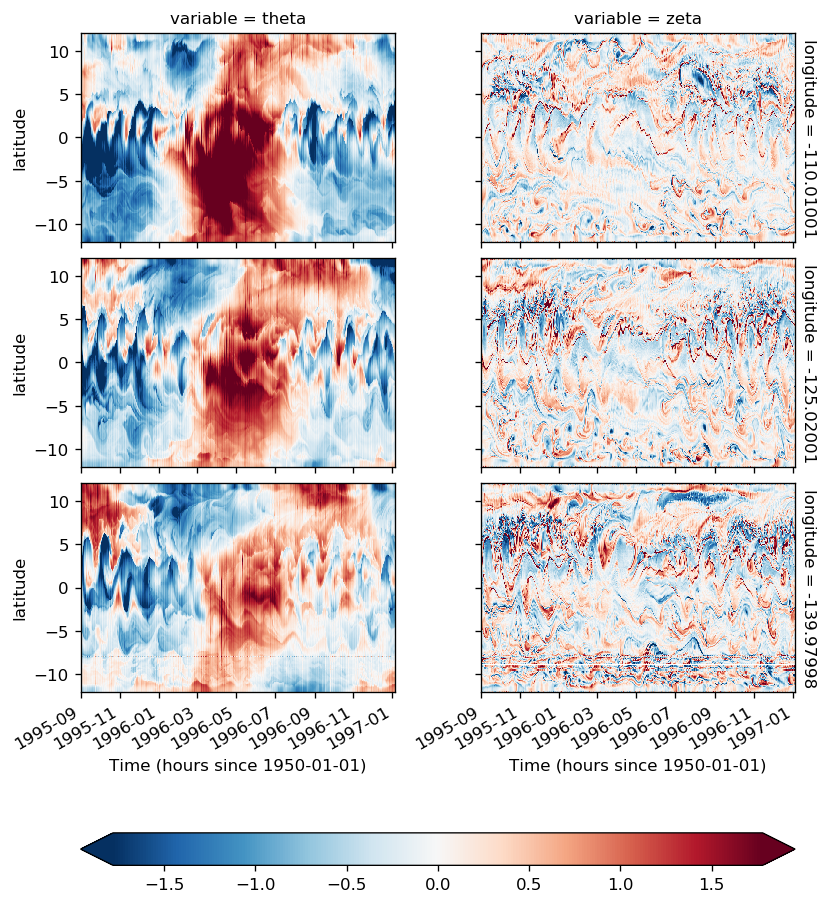

In [10]:
(sstz - sstz.mean("time")).to_array().plot(
    row="longitude",
    col="variable",
    robust=True,
    x="time",
    cbar_kwargs={"orientation": "horizontal"},
)

## look at surface anomalies

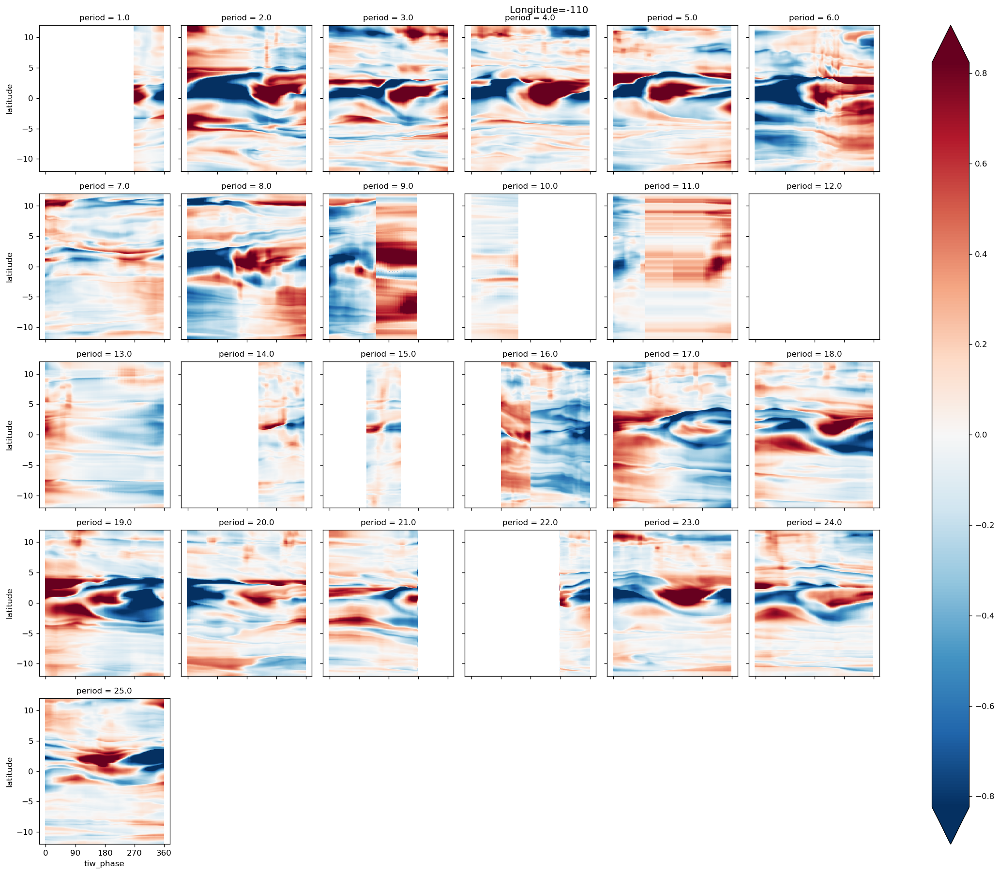

In [15]:
%matplotlib inline


def plot_tiw_sst_anom(longitude, x="tiw_phase", y="latitude"):

    tao = gcm1.tao.sel(longitude=longitude, latitude=0, drop=True)
    Tsmooth = (
        sst.sel(longitude=longitude, method="nearest").chunk(
            {"latitude": 20, "time": None}
        )
        .rolling(time=6, center=True)
        .mean(allow_lazy=True)
        .compute()
    ).assign_coords(tao[["tiw_phase", "period"]].variables)
    Tsmooth["tiw_phase"] = Tsmooth.tiw_phase.interpolate_na("time")

    grouped = Tsmooth.groupby("period")

    (
        (grouped - grouped.mean("time"))
        .groupby("period")
        .plot(
            col="period",
            col_wrap=6,
            x=x,
            y=y,
            robust=True,
            sharey=True,
            sharex=True,
            xticks=[0, 90, 180, 270, 360],
        )
    )
    plt.gcf().suptitle(f"Longitude={longitude}", y=1)


plot_tiw_sst_anom(-110)

## KPP mixing layer depth


Looks like the best way to detect it from the diffusivity. I pick the K value at one grid point below the surface $K_{-1}$. and find the shallowest depth where $K ≤ K_{-1} / 3$

In [190]:
sub = gcm1.full.sel(longitude=-110, time="1995-12-05 00:00", method='nearest')[["u", 'v', 'dens']].load()

JobQueueCluster.scale_down was called with a number of worker greater than what is already running or pending.


In [191]:
sub_diff = (gcm1.full.KPP_diffusivity.sel(time="1995-12-05 00:00", method='nearest', longitude=-110).load())

In [ ]:
gcm1

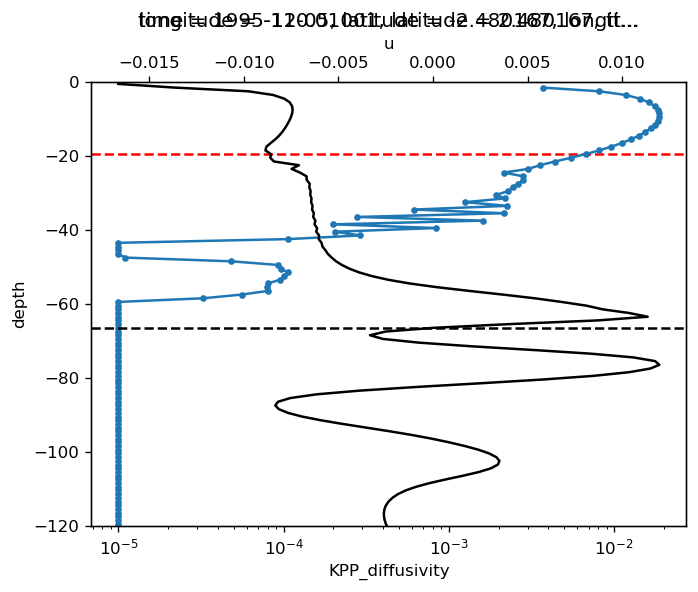

In [203]:
pump.calc.kpp_diff_depth(sub_diff.sel(latitude=2.5, method="nearest"), debug=True)
ax = plt.gca().twiny()
#sub.u.sel(latitude=-2.5, method="nearest").differentiate("depth").plot(ax=ax,y="depth")
# (-1 * sub.dens.sel(latitude=-2.5, method="nearest").differentiate("depth")).plot(ax=ax, color='k', y="depth")
(sub.u.sel(latitude=-2.5, method="nearest").differentiate("depth")).plot(ax=ax, color='k', y="depth")
mld_rib = pump.calc.get_kpp_mld(sub.sel(latitude=-2.5, method="nearest"))
dcpy.plots.liney(mld_rib, color='k')

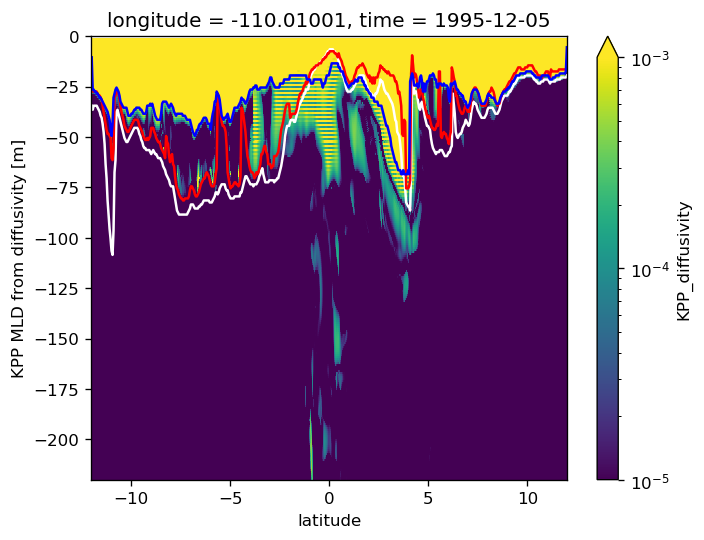

In [49]:
sub_diff.sel(depth=slice(0, -220)).plot(vmax=1e-3, norm=mpl.colors.LogNorm())

pump.calc.get_kpp_mld(sub).plot(color='w', label="KPP Ric depth")
pump.calc.get_mld(sub.dens).plot(color='r', label="Δρ depth")
pump.calc.kpp_diff_depth(sub_diff).plot(color='b', label="K depth")

### KPP mixing layer depth & deep cycle

Looks like we do see the shear mixing scheme kick in on a daily timescale beneath a descending convecting layer.

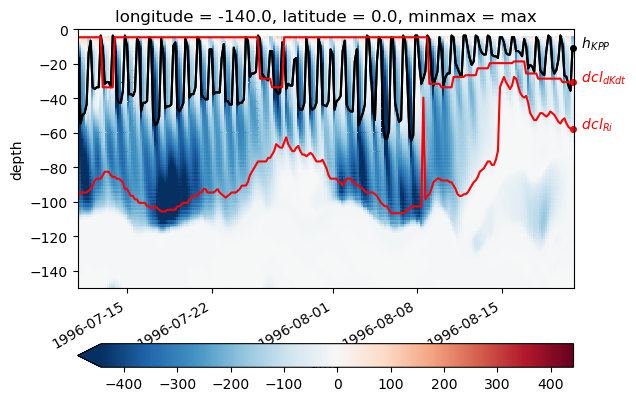

In [264]:
%matplotlib inline

def plot_annotate(data, label, **kwargs):
    h = data.plot(**kwargs)
    dcpy.plots.annotate_end(h[0], label)


subset = gcm1.tao.sel(latitude=0, longitude=-140).sel(
    time=slice("1996-07-11", "1996-08-20")
)
K = subset.KPP_diffusivity.rolling(depth=4).mean()
dcl = pump.calc.get_dcl_base_dKdt(
    np.abs(K), threshold=0.25
)
kpp_mld = pump.calc.kpp_diff_depth(subset.KPP_diffusivity)

subset.Jq.rolling(depth=4).mean().plot(
    y="depth",
    ylim=[-150, 0],
    robust=True,
    cmap=mpl.cm.RdBu_r,
    center=0,
    cbar_kwargs={"orientation": "horizontal"},
)
h = kpp_mld.plot(x="time", color="k")
plot_annotate(kpp_mld, "$h_{KPP}$", x="time", color="k")
plot_annotate(subset.dcl_base_Ri, "$dcl_{Ri}$", x="time", color="r")
plot_annotate(dcl, "$dcl_{dKdt}$", x="time", color="r")

In [278]:
K.sel(time=slice("1996-07-15", "1996-07-22")).time.dt.floor("D")

<xarray.DataArray 'floor' (time: 48)>
array(['1996-07-15T00:00:00.000000000', '1996-07-15T00:00:00.000000000',
       '1996-07-15T00:00:00.000000000', '1996-07-15T00:00:00.000000000',
       '1996-07-15T00:00:00.000000000', '1996-07-15T00:00:00.000000000',
       '1996-07-16T00:00:00.000000000', '1996-07-16T00:00:00.000000000',
       '1996-07-16T00:00:00.000000000', '1996-07-16T00:00:00.000000000',
       '1996-07-16T00:00:00.000000000', '1996-07-16T00:00:00.000000000',
       '1996-07-17T00:00:00.000000000', '1996-07-17T00:00:00.000000000',
       '1996-07-17T00:00:00.000000000', '1996-07-17T00:00:00.000000000',
       '1996-07-17T00:00:00.000000000', '1996-07-17T00:00:00.000000000',
       '1996-07-18T00:00:00.000000000', '1996-07-18T00:00:00.000000000',
       '1996-07-18T00:00:00.000000000', '1996-07-18T00:00:00.000000000',
       '1996-07-18T00:00:00.000000000', '1996-07-18T00:00:00.000000000',
       '1996-07-19T00:00:00.000000000', '1996-07-19T00:00:00.000000000',
       '1996-07-19T00:00:00.000000000', '1996-07-19T00:00:00.000000000',
       '1996-07-19T00:00:00.000000000', '1996-07-19T00:00:00.000000000',
       '1996-07-20T00:00:00.000000000', '1996-07-20T00:00:00.000000000',
       '1996-07-20T00:00:00.000000000', '1996-07-20T00:00:00.000000000',
       '1996-07-20T00:00:00.000000000', '1996-07-20T00:00:00.000000000',
       '1996-07-21T00:00:00.000000000', '1996-07-21T00:00:00.000000000',
       '1996-07-21T00:00:00.000000000', '1996-07-21T00:00:00.000000000',
       '1996-07-21T00:00:00.000000000', '1996-07-21T00:00:00.000000000',
       '1996-07-22T00:00:00.000000000', '1996-07-22T00:00:00.000000000',
       '1996-07-22T00:00:00.000000000', '1996-07-22T00:00:00.000000000',
       '1996-07-22T00:00:00.000000000', '1996-07-22T00:00:00.000000000'],
      dtype='datetime64[ns]')
Coordinates:
    latitude   float64 0.0
    longitude  float64 -140.0
  * time       (time) datetime64[ns] 1996-07-15 ... 1996-07-22T20:00:00

In [ ]:
dcl = pump.calc.get_dcl_base_dKdt(
    K.sel(time=slice("1996-07-15", "1996-07-22")), threshold=0.25, debug=True
)

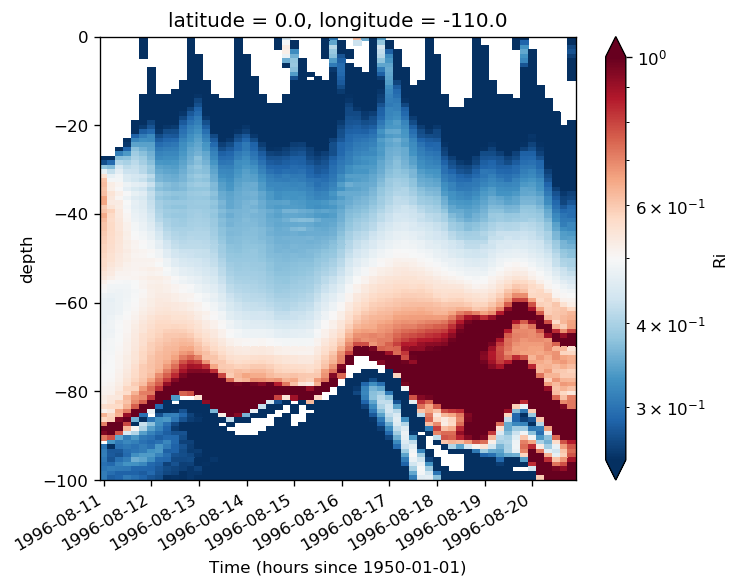

In [157]:
subset.Ri.plot(x="time", norm=mpl.colors.LogNorm(0.25, 1), ylim=[-100,0])

### dK/dt based deep cycle depth

Hmmm.... the Ri thing seems OK enough

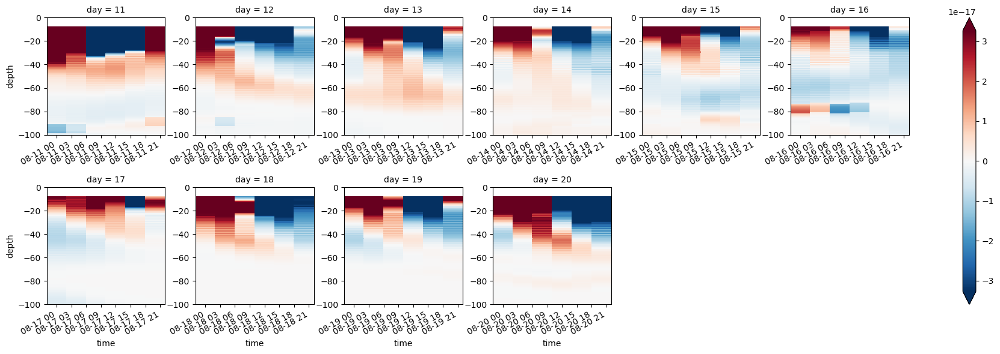

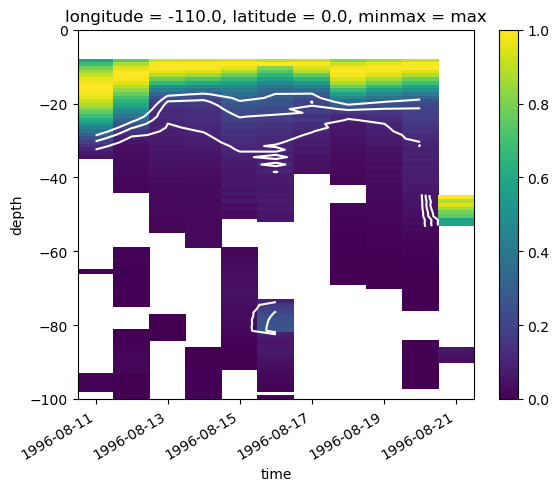

In [232]:
(amp / amp.max("depth")).plot(y="depth", robust=True, ylim=(-100, 0), vmin=0, vmax=1)
(amp / amp.max("depth")).plot.contour(
    y="depth", colors="w", ylim=(-100, 0), levels=[0.1, 0.2, 0.3]
)

/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/matplotlib/colors.py:1110: RuntimeWarning: invalid value encountered in less_equal
  mask |= resdat <= 0


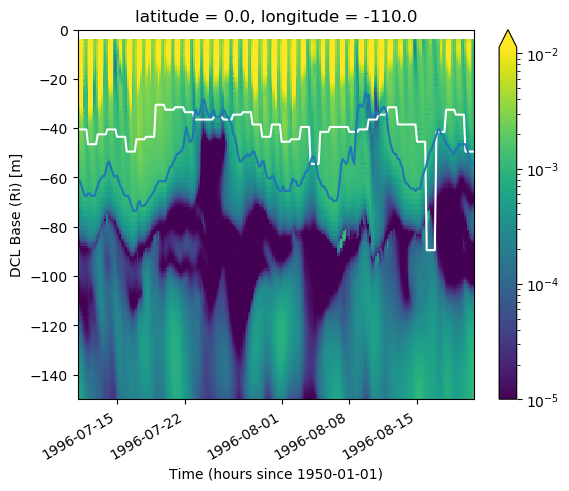

In [242]:
K = subset.KPP_diffusivity.rolling(depth=4).mean()
dcl = pump.calc.get_dcl_base_dKdt(K)
K.plot(x="time", robust=True, norm=mpl.colors.LogNorm())
dcl.plot(color="w")
subset.dcl_base_Ri.plot(ylim=(-150, 0))

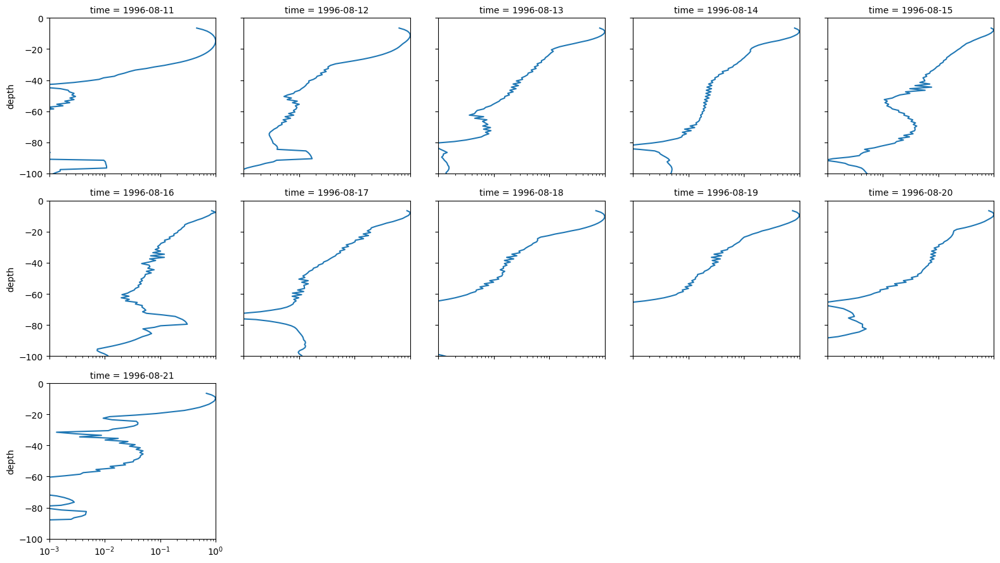

In [211]:
(amp_cleaned / amp_cleaned.max("depth")).plot(
    col="time", col_wrap=5, y="depth", ylim=[-100, 0], xscale="log", xlim=[1e-3, 1]
)

## compute composite

In [10]:
model = gcm1
longitude = -110

anomalize_fields = ["u", "v", "theta", "salt", "sst"]
anomalize_over = ["time"]  # and depth?

# def model_composite(model, longitude, periods):

# TODO: xfilter this
surf = (
    model.surface[["theta", "zeta"]]
    .sel(longitude=longitude, method="nearest")
    .rolling(time=12)
    .mean(allow_lazy=True)
).load()  # this is needed for y reference so might as well compute

surf["tiw_phase"], surf["period"] = pump.calc.get_tiw_phase_sst(surf.theta)
periods = [2, 3, 4, 5, 6,] # 17, 19, 23, 24
#surf["period"] = model.tao.period.sel(latitude=0, longitude=longitude).compute()
#surf["tiw_phase"] = model.tao.tiw_phase.sel(latitude=0, longitude=longitude).compute().interpolate_na("time")
surf = surf.set_coords(["period", "tiw_phase"])
yref = pump.composite.get_y_reference(surf.theta, periods=periods, debug=False)
surf = surf.assign_coords(yref=yref).drop("depth")

/gpfs/u/home/dcherian/python/xarray/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


In [12]:
tao = model.tao.sel(longitude=longitude, latitude=0)

full = model.full.sel(longitude=longitude, method="nearest").assign_coords(
    longitude=longitude,
    yref=surf.yref.compute(),
    period=surf.period.compute(),
    tiw_phase=surf.tiw_phase.compute(),
)

if model.budget is not None:
    full["Jq"] = model.budget.Jq.sel(
        longitude=longitude, method="nearest"
    ).assign_coords({"longitude": longitude})

    
subset_fields = ["Jq", "theta", "dens", "u", "v", "w", "KPP_diffusivity"]
# needed for apply_ufunc later
full = full[subset_fields]

full["sst"] = surf.theta
full["ssvor"] = surf.zeta

Lessons:
1. Δρ MLD depth might not be so bad as an upper bound
2. EUC_max at equator (duh) makes sense as a good deep bound
3. Mixing at 2N is elevated when the cold front arrives.

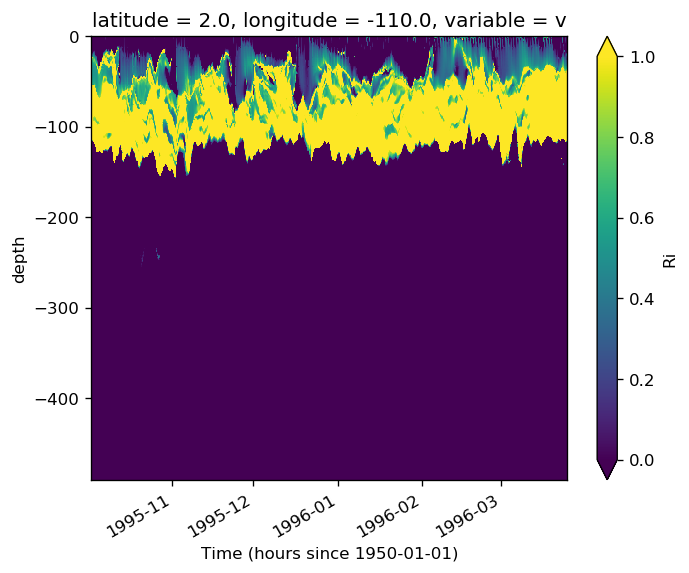

In [111]:
subset.sel(**region).Ri.plot(x="time", robust=True, vmax=1, vmin=0)

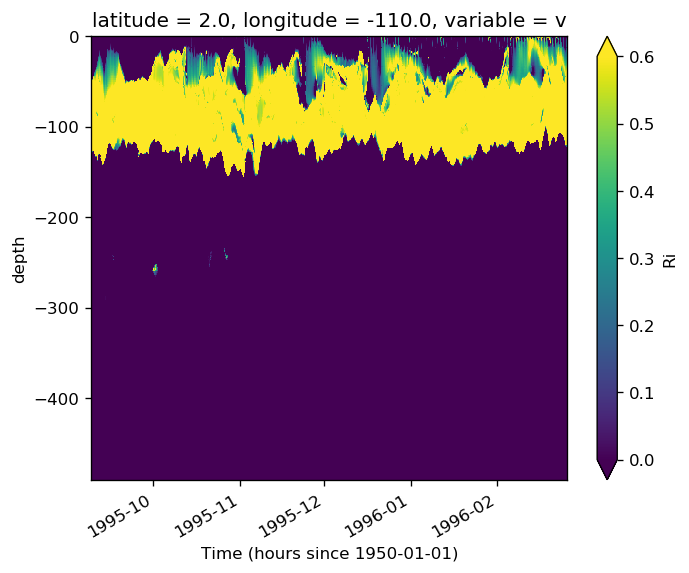

In [261]:
subset.Ri.sel(**region).plot(x="time", vmin=0, vmax=0.6)

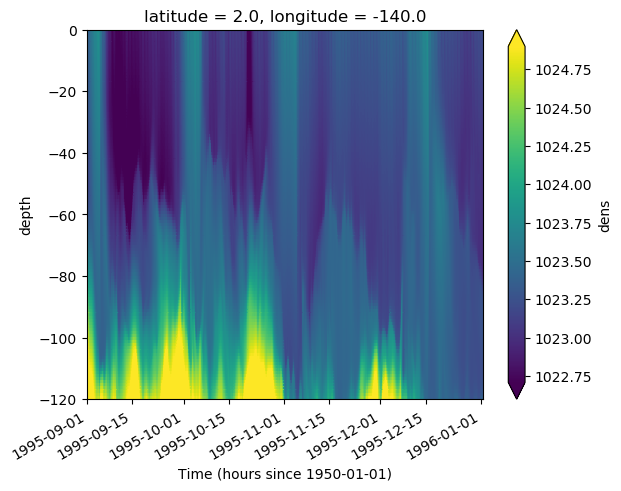

In [259]:
gcm1.tao.dens.sel(
    depth=slice(0, -120), time=slice(None, "1996-01-01"), latitude=2, longitude=-140
).plot(x="time", robust=True)

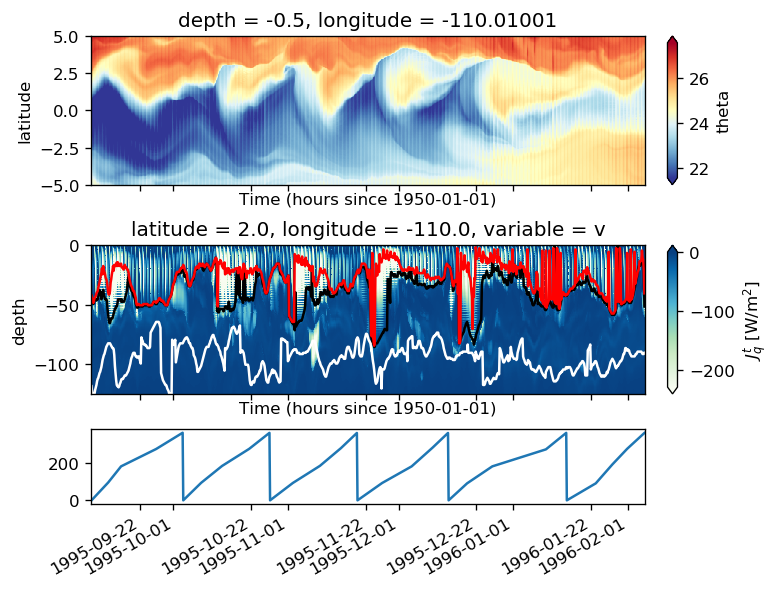

In [135]:
%matplotlib inline

pump.plot.plot_jq_sst(gcm1, lon=-110, periods=range(2,8), lat=3)
f.savefig("../images/tiw-110-mixing-periods-2345.png")

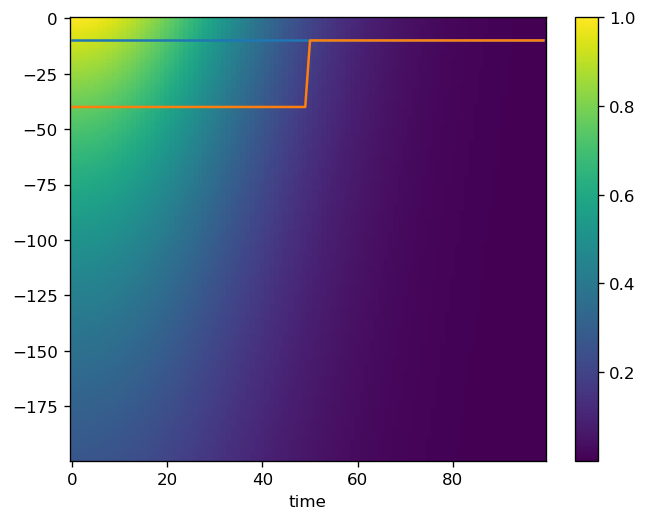

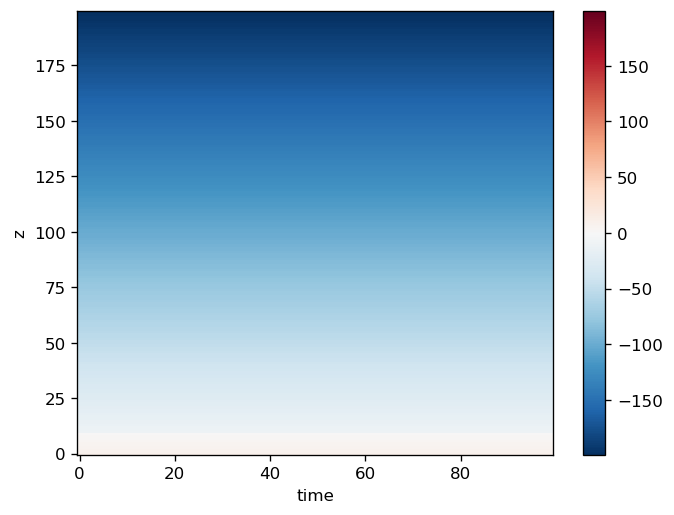

In [66]:
t = xr.DataArray(np.arange(100), dims=["time"])
z = xr.DataArray(-1*np.arange(0, 200.0), dims=["z"])
field = np.exp(-(t/40)**2+z/150).assign_coords(z=z, time=t)
mld = -10 * xr.ones_like(t)
dcl = -40 * xr.ones_like(t)
dcl[50:] = -10

field.plot(x="time", zorder=-10)
mld.plot()
dcl.plot()

znew = xr.full_like(z, fill_value=np.nan)
znew = xr.where(z > mld, z-mld, z)

plt.figure()
znew.plot()

In [169]:
T = subset.pipe(lambda x: x - x.mean("time")).sel(depth=slice(-10)).mean("depth")

T.plot(x="time", robust=True)

ValueError: dimensions or multi-index levels ['depth'] do not exist

### explore vertical reference frame

In [27]:
full = full.set_coords("mld")

In [28]:
subset = full.Jq.where(full.period.isin([2, 3]), drop=True).sel(latitude=0, method="nearest").load()

ValueError: Could not find dependent ('concatenate-1b799f6ffc8d416a5e1ec6ca81f5f186', 220, 0, 1, 2).  Check worker logs

In [33]:
mld_subset = mld.where(mld.period.isin([2,3])).sel(latitude=0, method="nearest")

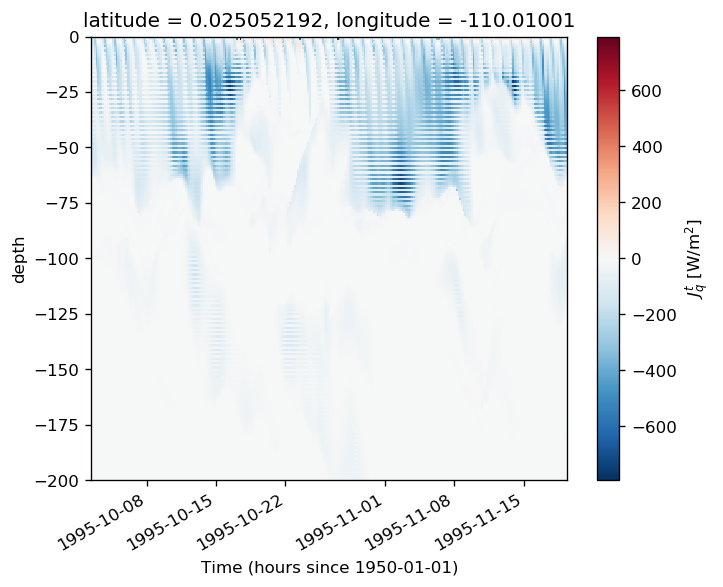

In [22]:
subset.sel(depth=slice(0, -200)).plot(x="time")

/gpfs/u/home/dcherian/python/xarray/xarray/core/common.py:664: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, the dimension order of these coordinates will be restored as well unless you specify restore_coord_dims=False.
  self, group, squeeze=squeeze, restore_coord_dims=restore_coord_dims
/glade/u/home/dcherian/python/xfilter/xfilter/xfilter.py:175: UserWarning: The 'gappy' kwarg is now deprecated.
  warnings.warn("The 'gappy' kwarg is now deprecated.")


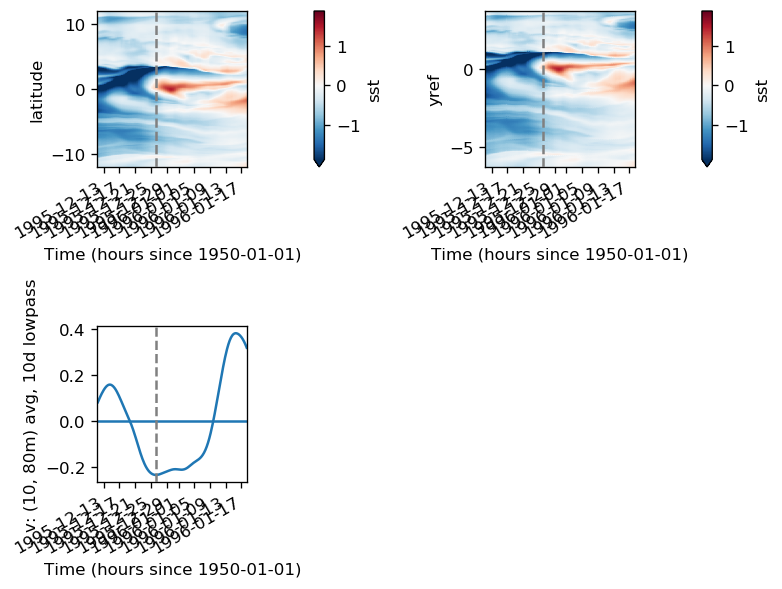

In [98]:
pump.composite.test_composite_algorithm(full, tao, period=5, debug=False)

## further compositing

In [25]:
full = full.sel(depth=slice(0, -250)).chunk({"depth": None, "latitude": "auto", "time": 48})
# calculate MLD before daily filter
mld = pump.calc.get_mld(full.dens)
kpp_mld = pump.calc.get_kpp_mld(full)
kpp_diff_depth = pump.calc.kpp_diff_depth(full.KPP_diffusivity)
full = full.assign(mld=mld, kpp_mld=kpp_mld, kpp_diff_depth=kpp_diff_depth)

In [100]:
#filtered = full.copy(deep=True)
# .chunk({"time": None, "latitude": None, "depth": 5}).pipe(
#    pump.utils.lowpass, "time", freq=0.5, cycles_per="D"
#)

# subset to periods
full_subset = full.where(full.period.isin(periods), drop=True)

anomalize_fields = ["u", "v", "w", "theta", "salt", "sst"]
to_anomalize = []
for var in full_subset.data_vars:
    if var in anomalize_fields:
        to_anomalize.append(var)

full_subset["uz"] = full_subset.u.differentiate("depth")
full_subset["vz"] = full_subset.v.differentiate("depth")

if len(to_anomalize) > 0:
    means = full_subset[to_anomalize].groupby("period").mean(anomalize_over[0])
    anomalies = full_subset.groupby("period") - means
    full_subset = full_subset.assign(anomalies)
    
full_subset["wT"] = full_subset.w * full_subset.theta

In [101]:
# depth masking

# NOTE: these depths are negative
# full_subset["mld_depth"] = kpp_diff_depth
full_subset["mld_depth"] = mld
full_subset = full_subset.assign_coords(euc_max=tao.euc_max.reset_coords(drop=True))
masked = full_subset.copy()
depth_mask = (
    (masked.depth < masked.mld_depth) & (masked.depth > full_subset.euc_max)
).sel(depth=slice(0, -250))

for var in subset_fields:
    masked[var] = (
        full_subset[var].sel(depth=slice(0, -250)).where(depth_mask).mean("depth")
    )

# composite = model_composite(gcm1, -110, [5, 6])

In [81]:
dask.config.set(fuse_ave_width=10)

## single period images

In [27]:
p = full.where(full.period == 5, drop=True)
p["uz"] = p.u.differentiate("depth")
p["vz"] = p.v.differentiate("depth")

In [68]:
masked.Jq.load()

JobQueueCluster.scale_down was called with a number of worker greater than what is already running or pending.
JobQueueCluster.scale_down was called with a number of worker greater than what is already running or pending.


<xarray.DataArray 'Jq' (time: 895, latitude: 480)>
array([[-1.82363449, -1.79802843, -1.5902785 , ..., -2.93373322,
        -2.91159303,         nan],
       [-1.94964   , -1.80525469, -1.05023166, ..., -2.9250608 ,
        -2.91538393, -2.8971814 ],
       [-2.06606231, -1.62287225, -0.62342455, ..., -2.93574442,
        -3.05707785, -2.89194324],
       ...,
       [-2.23249162, -2.89254245, -2.82554901, ..., -2.85028037,
        -2.81443659, -2.83772281],
       [-2.24564543, -2.85735422, -2.82522369, ..., -2.84632142,
        -2.82359037, -2.88193586],
       [-2.39699863, -2.87838157, -2.89696535, ..., -2.88710673,
        -2.8675533 , -2.88754213]])
Coordinates:
    longitude  float32 -110.01001
  * latitude   (latitude) float32 -12.0 -11.949896 -11.899791 ... 11.949896 12.0
    variable   <U1 'v'
    yref       (time, latitude) float32 -4.4166665 -4.4 ... 6.517241 6.551724
    tiw_phase  (time) float64 0.0 3.462 6.923 10.38 ... 346.7 350.0 353.3 356.7
    period     (time) float64 2.0 2.0 2.0 2.0 2.0 2.0 ... 8.0 8.0 8.0 8.0 8.0
  * time       (time) datetime64[ns] 1995-09-08T20:00:00 ... 1996-02-26

In [113]:
masked.KPP_diffusivity.load()

ERROR:dask_jobqueue.core:Unknown job_id: 3744660 for worker tcp://10.12.205.22:41210
ERROR:dask_jobqueue.core:Unknown job_id: 3744661 for worker tcp://10.12.205.19:38321
ERROR:dask_jobqueue.core:Unknown job_id: 3744663 for worker tcp://10.12.205.20:46438
ERROR:dask_jobqueue.core:Unknown job_id: 3744662 for worker tcp://10.12.205.20:43655


<xarray.DataArray 'KPP_diffusivity' (time: 895, latitude: 480)>
array([[2.16934641e-05, 2.61296118e-05, 2.82781384e-05, ...,
        1.00861098e-05, 1.00000025e-05,            nan],
       [1.48696772e-05, 1.85600911e-05, 2.78046755e-05, ...,
        1.00070320e-05, 1.00000025e-05, 1.00000025e-05],
       [1.13437463e-05, 1.74175802e-05, 3.36634293e-05, ...,
        1.00000016e-05, 1.16432275e-05, 1.00000025e-05],
       ...,
       [6.87011983e-04, 7.26291182e-05, 2.74807735e-05, ...,
        1.00413317e-05, 1.01499318e-05, 4.15229733e-05],
       [7.19422009e-04, 7.32370318e-05, 1.49488033e-05, ...,
        1.32856512e-05, 1.35556911e-05, 6.10679344e-05],
       [6.43753272e-04, 1.12700991e-05, 1.30987291e-05, ...,
        1.08987988e-05, 1.04452229e-05, 6.66509441e-05]], dtype=float32)
Coordinates:
    longitude  float32 -110.01001
  * latitude   (latitude) float32 -12.0 -11.949896 -11.899791 ... 11.949896 12.0
    variable   <U1 'v'
    yref       (time, latitude) float32 -4.4166665 -4.4 ... 6.517241 6.551724
    tiw_phase  (time) float64 0.0 3.462 6.923 10.38 ... 346.7 350.0 353.3 356.7
    period     (time) float64 2.0 2.0 2.0 2.0 2.0 2.0 ... 8.0 8.0 8.0 8.0 8.0
  * time       (time) datetime64[ns] 1995-09-08T20:00:00 ... 1996-02-26

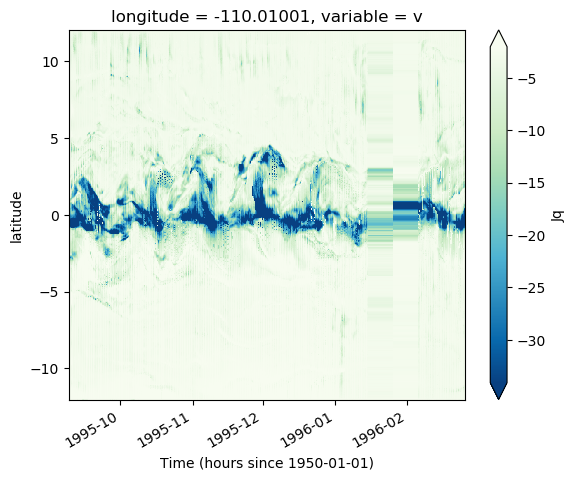

In [119]:
masked.Jq.plot(x="time", robust=True, cmap=mpl.cm.GnBu_r)

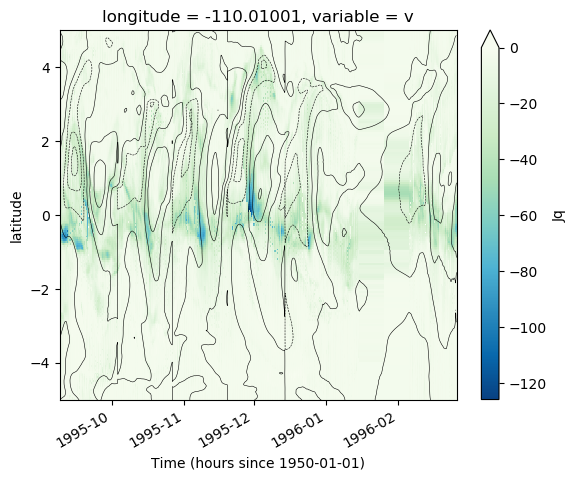

In [112]:
masked.Jq.plot(x="time", robust=False, vmax=0, cmap=mpl.cm.GnBu_r)
masked.sst.plot.contour(colors='k', x="time", levels=10, linewidths=0.4, ylim=[-5, 5])

In [167]:
# subset = gcm1.full[["KPP_diffusivity"]].where(full.period == 5, drop=True)
kpp_mld = pump.calc.kpp_diff_depth(gcm1.tao.KPP_diffusivity)

In [171]:
min_mld = xr.where(gcm1.tao.mld > kpp_mld, gcm1.tao.mld, kpp_mld)

/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/matplotlib/colors.py:1110: RuntimeWarning: invalid value encountered in less_equal
  mask |= resdat <= 0


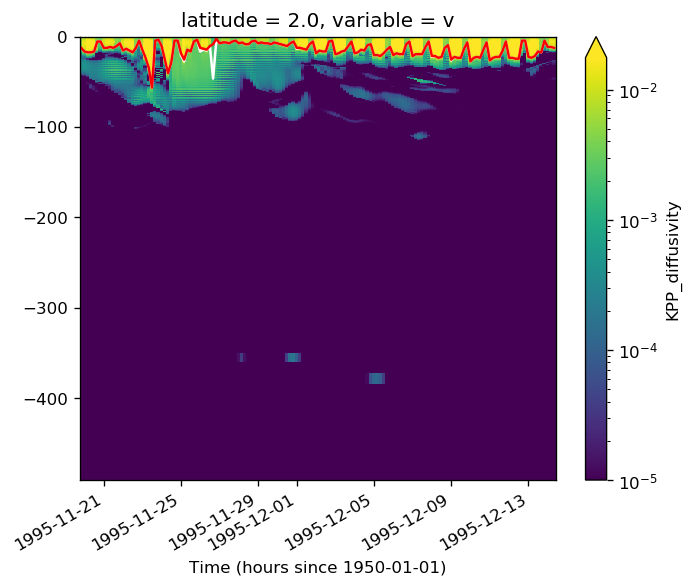

In [172]:
gcm1.tao.KPP_diffusivity.sel(longitude=-110, latitude=2).where(
    full.period == 5, drop=True
).plot(x="time", norm=mpl.colors.LogNorm(), robust=True)
kpp_mld.sel(longitude=-110, latitude=2).where(
    full.period == 5, drop=True
).plot(color='w')
min_mld.sel(longitude=-110, latitude=2).where(
    full.period == 5, drop=True
).plot(color='r')

In [98]:
def phi_s(zeta, zetas, a, c):

    if zeta >= 0:  # unstable
        phi = 1.0 + 5 * zeta
    else:
        if zeta > zetas:
            phi = (1.0 - 16 * zeta) ** (-1 / 2)
        else:
            phi = (a - c * zeta) ** (-1 / 3)

    return phi


ustar = sqrt(sqrt(WVSURF^2+WUSURF^2));
# similarity profile constants
zetas = -1.0
zetam = -0.2
cs = 24.0 * (1.0 - 16.0 * zetas) ** (0.50)
cm = 12.0 * (1.0 - 16.0 * zetam) ** (-0.25)

κ = 0.4  # von karman
ε = 0.1  # nondim extent of surface layer
Ric = 0.3  # critical bulk Ri
βT = -0.2  # from Bill Smyth
Cv = 1.5  # from Bill Smyth
a_s = cs * zetas + (1.0 - 16.0 * zetas) ** (1.50)
am = cm * zetam + (1.0 - 16.0 * zetam) ** (0.75)

w_s = κ * ustar / phi_s(zeta, zeta_s, a_s, cs)

Vt2 = Cv * np.sqrt(-βT) / Ric / κ ** 2 * 1 / np.sqrt(cs * ε) * d * N * ws

# Vtc = Cv*sqrt(-betaT)/(sqrt(cs*epsilon)*Ric*vonKar*vonKar);

NameError: name 'ustar' is not defined

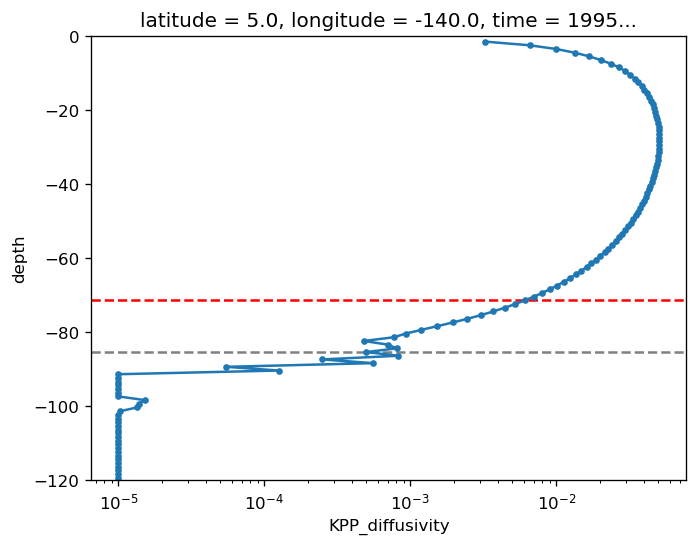

In [155]:
subset = gcm1.tao.sel(latitude=5, longitude=-140, time="1995-11-16 16:00")

pump.calc.kpp_diff_depth(subset.KPP_diffusivity, debug=True)
dcpy.plots.liney(subset.mld)

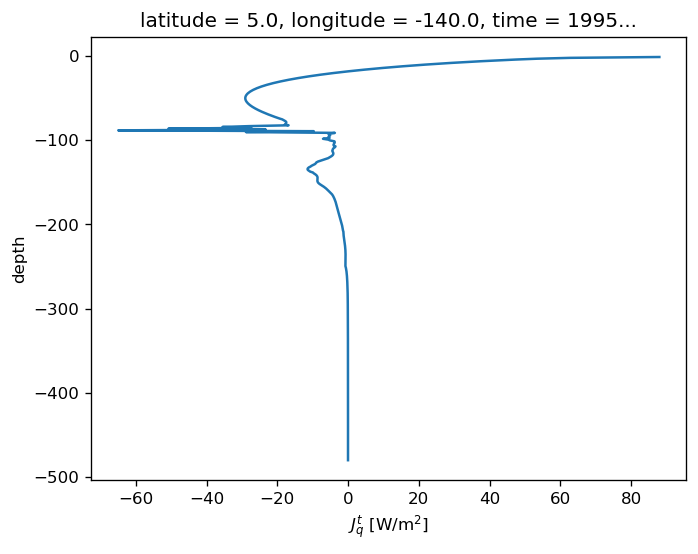

JobQueueCluster.scale_down was called with a number of worker greater than what is already running or pending.


In [156]:
subset.Jq.plot(y="depth")

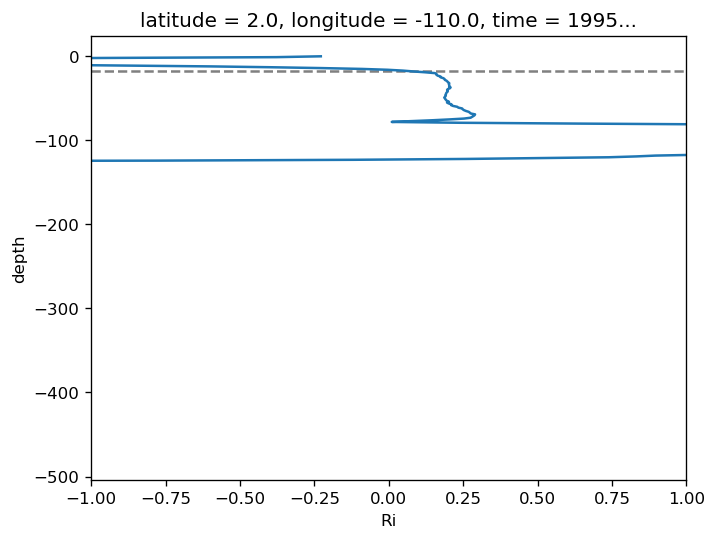

In [122]:
subset.Ri.plot(y="depth", xlim=[-1, 1])

JobQueueCluster.scale_down was called with a number of worker greater than what is already running or pending.
JobQueueCluster.scale_down was called with a number of worker greater than what is already running or pending.
JobQueueCluster.scale_down was called with a number of worker greater than what is already running or pending.
Unknown job_id: 3744589 for worker tcp://10.12.205.18:43702


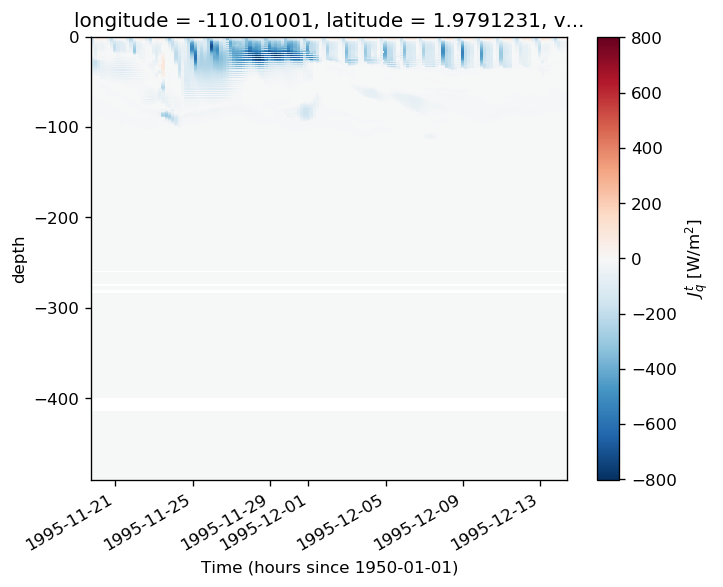

In [77]:
.sel(latitude=2, method="nearest").plot(x="time")

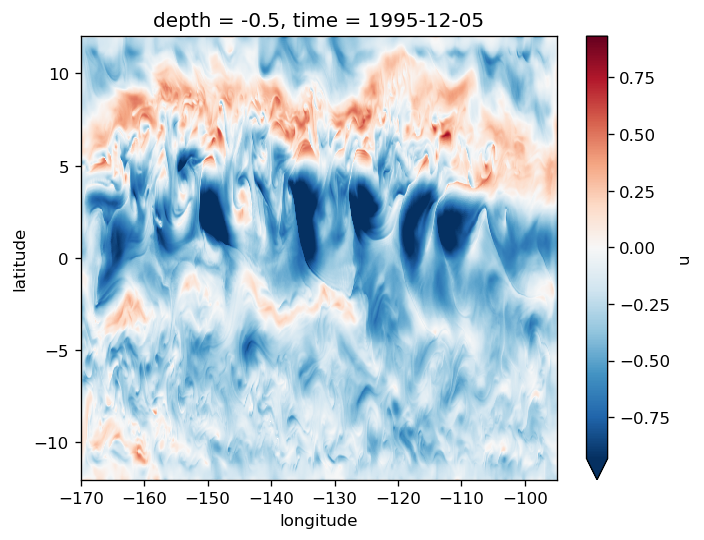

In [124]:
gcm1.surface.u.sel(time="1995-12-05 00:00", method="nearest").plot(robust=True)

JobQueueCluster.scale_down was called with a number of worker greater than what is already running or pending.
JobQueueCluster.scale_down was called with a number of worker greater than what is already running or pending.


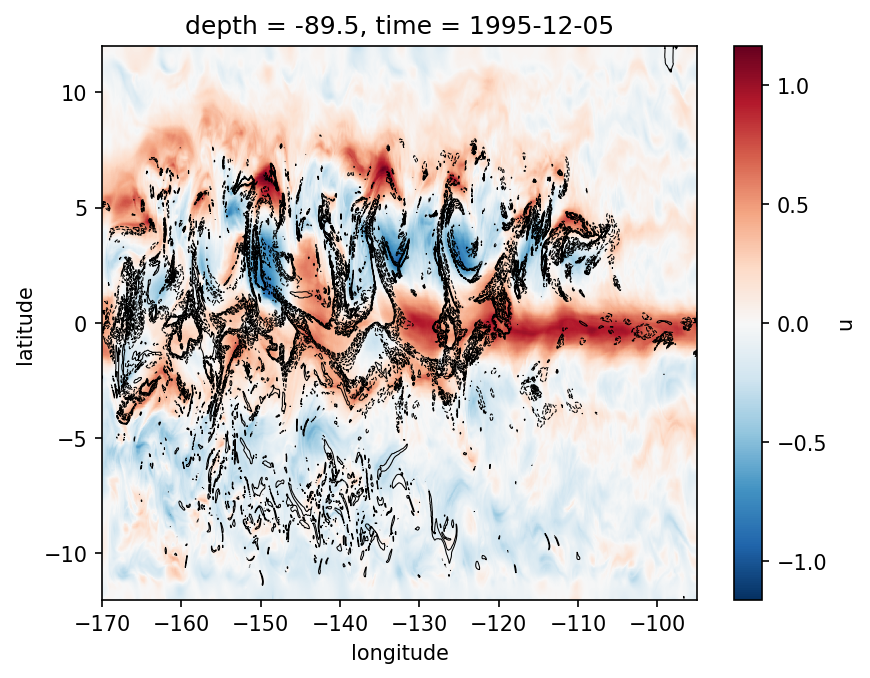

JobQueueCluster.scale_down was called with a number of worker greater than what is already running or pending.


In [240]:
gcm1.full.u.sel(**region).sel(depth=-90, method="nearest").plot()
gcm1.budget.Jq.sel(**region).sel(depth=-90, method="nearest").plot.contour(levels=12, robust=True, linewidths=0.5, colors='k')

In [195]:
p.kpp_diff_depth

AttributeError: 'Dataset' object has no attribute 'kpp_diff_depth'

In [33]:
p.u.load(); p.Jq.load(); p.mld.load();

In [ ]:
region = dict(time="1995-12-05 00:00", method="nearest")

(p.Jq
 .sel(**region)
 .plot(y="depth", ylim=[ -500, 0], xlim=[-6, 6], robust=True, cmap=mpl.cm.GnBu))
(p.mld.sel(**region).plot(color='r', x="latitude"))
(p.kpp_diff_depth.sel(**region).plot(color='g', x="latitude"))
(p.u.sel(**region).plot.contour(levels=20, colors='k'))
# (p.dens.sel(**region).plot.contour(levels=24, ylim=[-500, 0], colors='w', y="depth"))

JobQueueCluster.scale_down was called with a number of worker greater than what is already running or pending.
JobQueueCluster.scale_down was called with a number of worker greater than what is already running or pending.


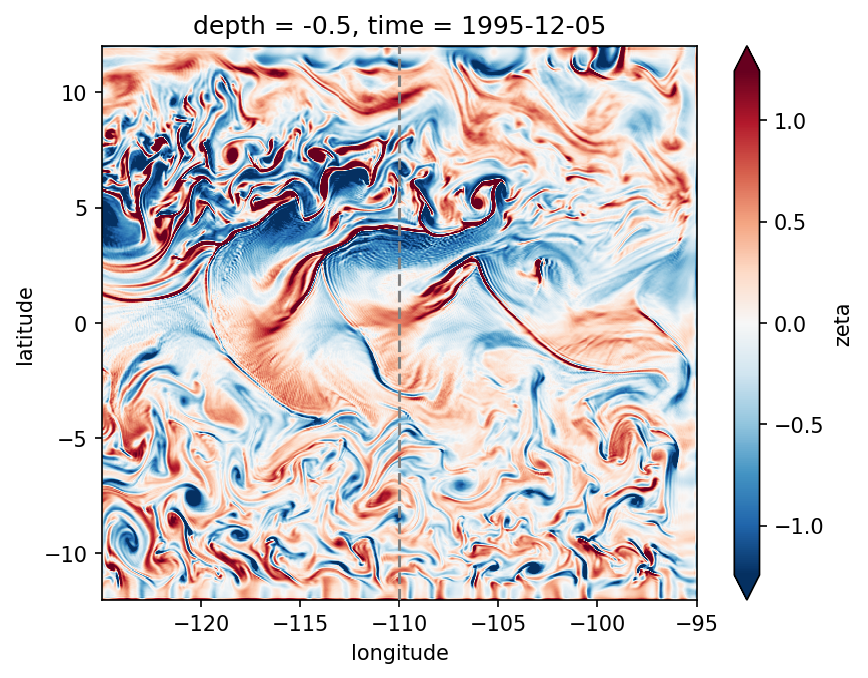

In [176]:
gcm1.surface.zeta.sel(**region).sel(longitude=slice(-125, -95)).plot(robust=True)
dcpy.plots.linex(-110, zorder=10)

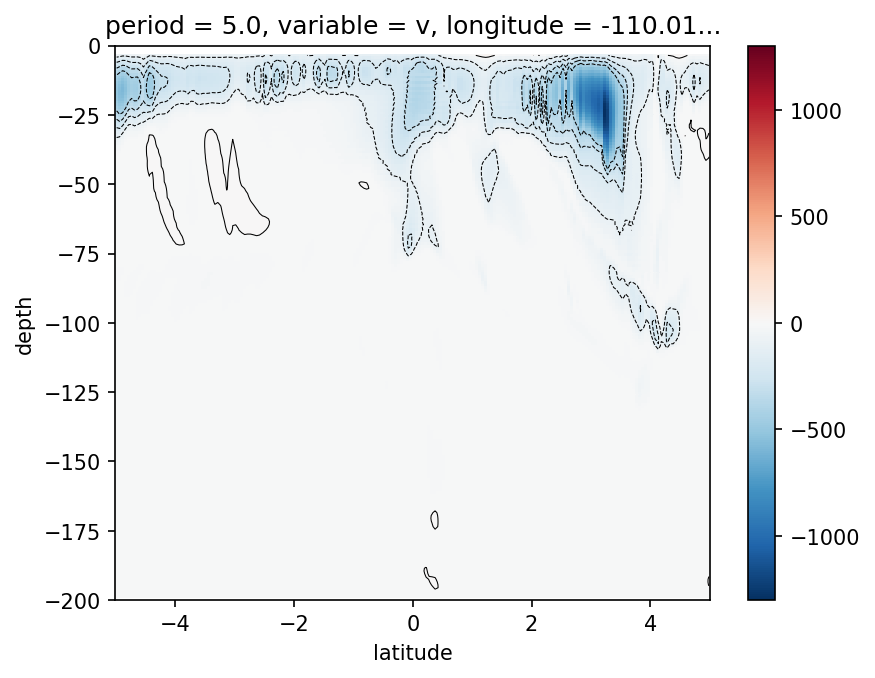

In [177]:
J = p.Jq.sel(**region).sel(depth=slice(0, -200), latitude=slice(-5, 5)).rolling(depth=4, center=True).mean()
J.plot(y="depth")
J.plot.contour(colors='k', levels=5, linewidths=0.5, robust=True)

### shears

(-250, 0)

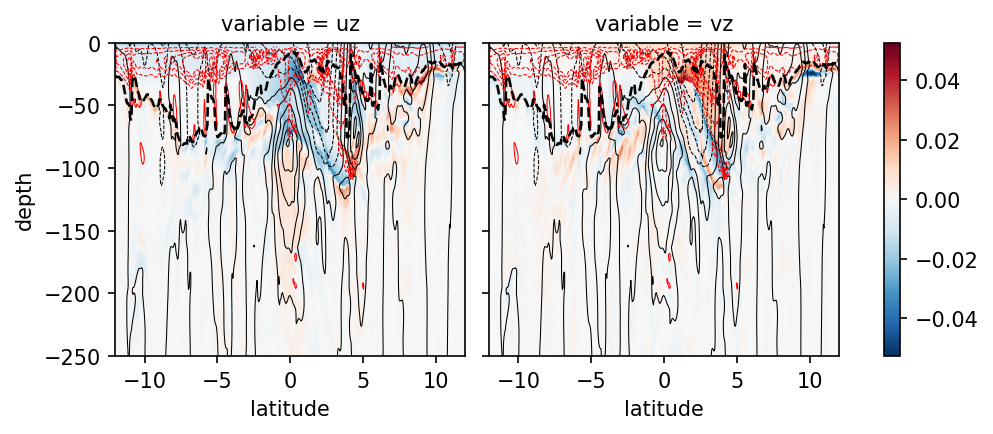

In [179]:
mpl.rcParams["figure.dpi"] = 150
# p.uz.sel(**region).plot(robust=True, ylim=[-500, 0])
fg = p[["uz", "vz"]].to_array().sel(**region).plot(col="variable", ylim=[-500, 0])
J = p.Jq.sel(**region).sel(depth=slice(0, -200)).rolling(depth=4, center=True).mean()

for ax in fg.axes.flat:
    p.u.sel(**region).plot.contour(ax=ax, levels=12, colors='k', linewidths=0.5, add_labels=False)
    J.plot.contour(colors='r', levels=5, linewidths=0.5, robust=True, ax=ax, add_labels=False)
    p.mld.sel(**region).plot(ls="--", lw=1.25, color='k', ax=ax, _labels=False)
    
ax.set_ylim([-250, 0])
# p.Jq.sel(**region).rolling(depth=4).mean().plot.contour(levels=20, robust=True, colors='k')

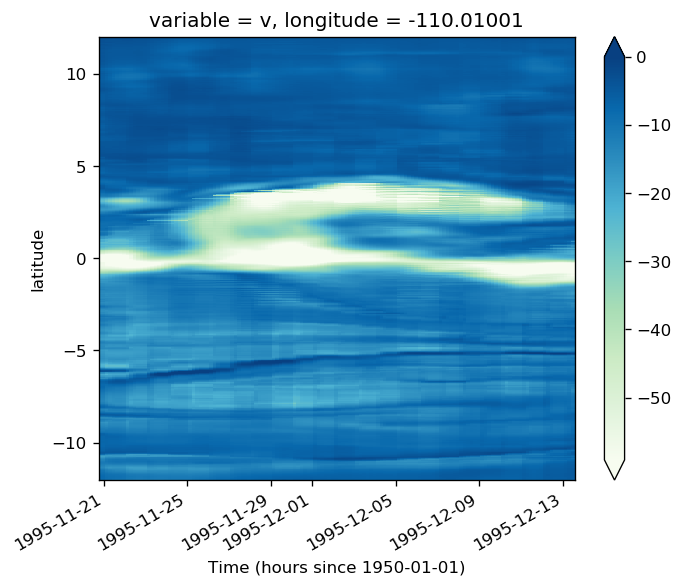

In [64]:
(p.Jq
 .mean("depth")
 .rolling(time=12,center=True).mean()
 .dropna("time")
 .plot(x="time", robust=True, cmap=mpl.cm.GnBu, vmax=0))

In [18]:
cluster.close()

distributed.client - ERROR - Failed to reconnect to scheduler after 10.00 seconds, closing client
distributed.utils - ERROR - 
Traceback (most recent call last):
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/distributed/utils.py", line 662, in log_errors
    yield
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/distributed/client.py", line 1290, in _close
    await gen.with_timeout(timedelta(seconds=2), list(coroutines))
concurrent.futures._base.CancelledError
distributed.utils - ERROR - 
Traceback (most recent call last):
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/distributed/utils.py", line 662, in log_errors
    yield
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/distributed/client.py", line 1019, in _reconnect
    await self._close()
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/distributed/client.py", line 1290, 

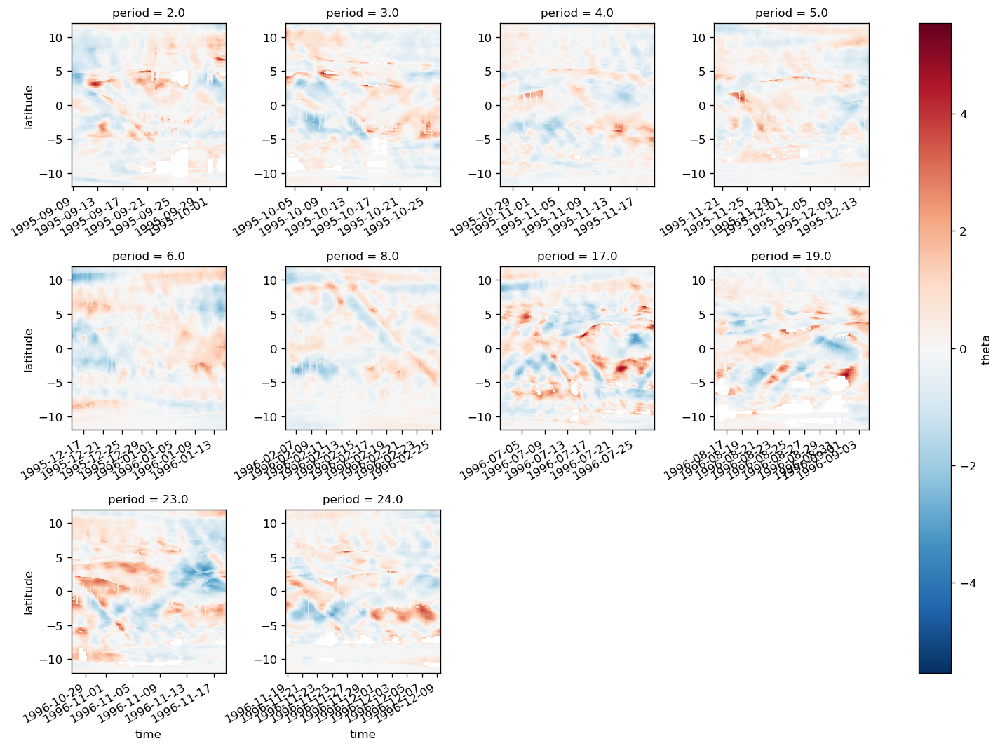

In [47]:
full.theta.groupby("period").plot(col="period", col_wrap=4, x="time")

## actually composite

In [103]:
masked.yref.load()

<xarray.DataArray 'yref' (time: 749, latitude: 480)>
array([[-3.056818 , -3.0454545, -3.0340908, ...,  7.4285703,  7.4642854,
         7.4999995],
       [-3.056818 , -3.0454545, -3.0340908, ...,  7.4285703,  7.4642854,
         7.4999995],
       [-3.056818 , -3.0454545, -3.0340908, ...,  7.4285703,  7.4642854,
         7.4999995],
       ...,
       [-3.8333335, -3.818182 , -3.8030303, ...,  5.209302 ,  5.232558 ,
         5.2558136],
       [-3.8333335, -3.818182 , -3.8030303, ...,  5.209302 ,  5.232558 ,
         5.2558136],
       [-3.8333335, -3.818182 , -3.8030303, ...,  5.209302 ,  5.232558 ,
         5.2558136]], dtype=float32)
Coordinates:
  * time       (time) datetime64[ns] 1995-10-02T12:00:00 ... 1996-02-04T04:00:00
    tiw_phase  (time) float64 0.0 1.875 3.75 5.625 ... 343.6 347.7 351.8 355.9
    yref       (time, latitude) float32 -3.056818 -3.0454545 ... 5.2558136
  * latitude   (latitude) float32 -12.0 -11.949896 -11.899791 ... 11.949896 12.0
    period     (time) float64 2.0 2.0 2.0 2.0 2.0 2.0 ... 6.0 6.0 6.0 6.0 6.0
    longitude  float32 -110.01001
    euc_max    (time) float64 -84.5 -83.5 -82.5 -82.5 ... -89.5 -89.5 -89.5

In [104]:
mld_comp2 = pump.composite.make_composite(masked.chunk({"latitude": None}))

/gpfs/u/home/dcherian/python/xarray/xarray/core/common.py:664: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, the dimension order of these coordinates will be restored as well unless you specify restore_coord_dims=False.
  self, group, squeeze=squeeze, restore_coord_dims=restore_coord_dims
distributed.scheduler - ERROR - Workers don't have promised key: ['tcp://10.12.205.11:38892'], ('xarray-period-bed0002bc7abd172ef39cab33b6b6526', 0)
NoneType: None
distributed.scheduler - ERROR - Workers don't have promised key: ['tcp://10.12.205.11:38892'], ('xarray-period-bed0002bc7abd172ef39cab33b6b6526', 0)
NoneType: None
distributed.scheduler - ERROR - Workers don't have promised key: ['tcp://10.12.205.11:38892'], ('xarray-period-bed0002bc7abd172ef39cab33b6b6526', 0)
NoneType: None
distributed.scheduler - ERROR - Workers don't have promised key: ['tcp://10.12.205.11:38892'], ('xarray-period-bed0002bc7abd172ef39cab33b6b6526', 0)
NoneType: None
distributed.sch

In [106]:
mld_comp2.Jq.load()

<xarray.Dataset>
Dimensions:         (period: 5, tiw_phase_bins: 71, yref: 800)
Coordinates:
  * tiw_phase_bins  (tiw_phase_bins) object (0, 5] (5, 10] ... (350, 355]
    longitude       float32 -110.01001
  * yref            (yref) float64 -4.0 -3.99 -3.98 -3.97 ... 3.97 3.98 3.99
  * period          (period) float64 2.0 3.0 4.0 5.0 6.0
    mean_lat        (yref) float64 -12.0 -12.0 -12.0 -12.0 ... 7.275 7.29 7.305
Data variables:
    avg_full        (tiw_phase_bins, yref) float64 -0.7301 -0.6899 ... -9.999
    dev             (tiw_phase_bins, yref) float64 0.01982 0.01669 ... 5.923
    err             (tiw_phase_bins, yref) float64 0.008864 0.007466 ... 2.649
    avg             (tiw_phase_bins, yref) float64 -0.7301 -0.6899 ... -9.999
Attributes:
    name:     Jq

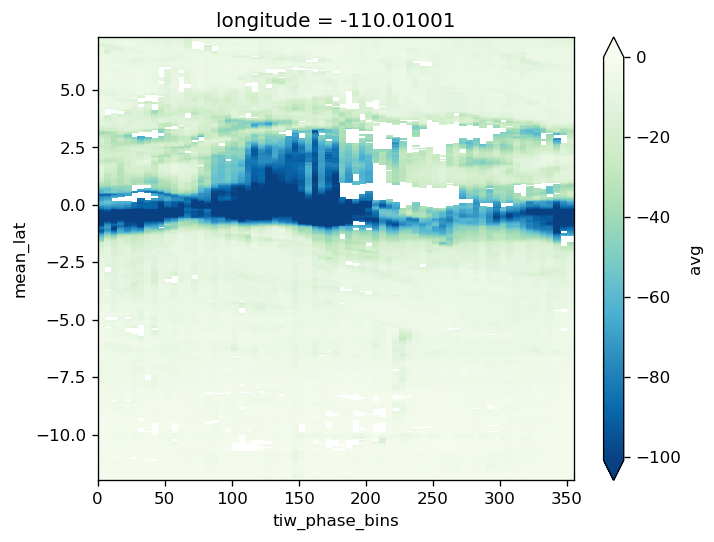

In [108]:
mld_comp2.plot("Jq", filter=True, cmap=mpl.cm.GnBu_r, vmax=0)

In [209]:
kpp_comp = pump.composite.make_composite(masked.chunk({"latitude": None}))

/gpfs/u/home/dcherian/python/xarray/xarray/core/common.py:665: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, the dimension order of these coordinates will be restored as well unless you specify restore_coord_dims=False.
  self, group, squeeze=squeeze, restore_coord_dims=restore_coord_dims


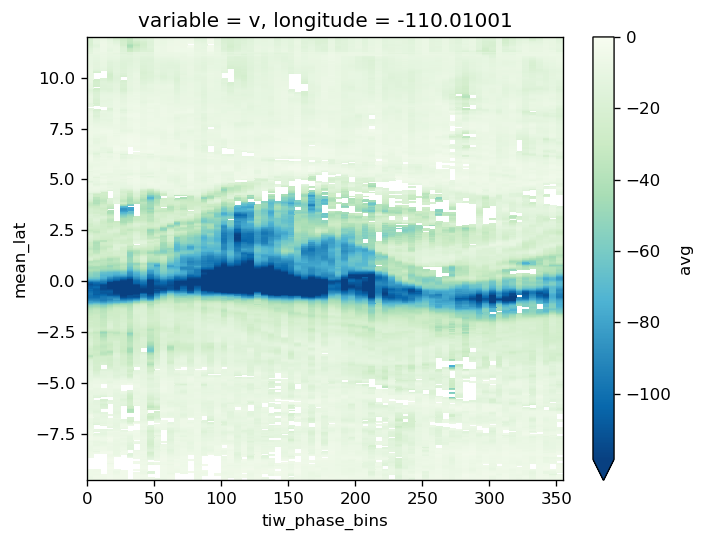

In [213]:
kpp_comp.plot("Jq", filter=True, cmap=mpl.cm.GnBu_r, vmax=0)

In [207]:
mld_comp = comp

In [143]:
masked["mld_depth"] = masked.mld_depth.persist()

In [93]:
cluster.adapt(maximum=64)

In [149]:
comp.load(["sst", "ssvor", "Jq"])

Difference between KPP MLD and Δρ MLD is small [O(10 W/m²)]

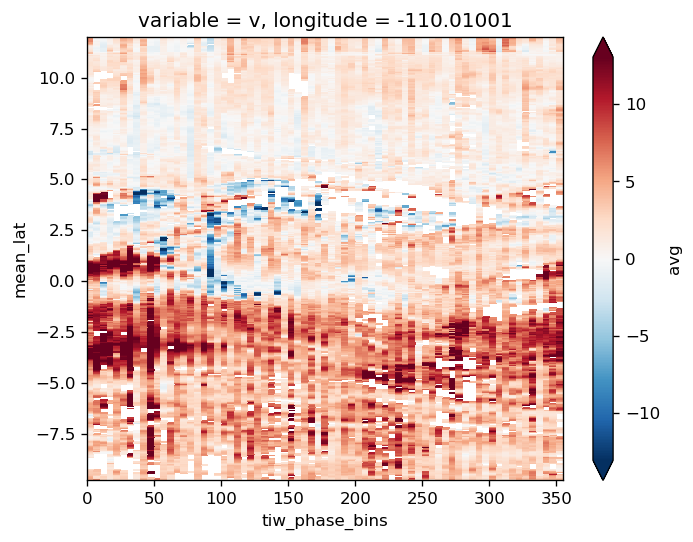

In [218]:
(mld_comp.data["Jq"].avg - kpp_comp.data["Jq"].avg).plot(x="tiw_phase_bins", y="mean_lat", robust=True)

<IPython.core.display.Javascript object>


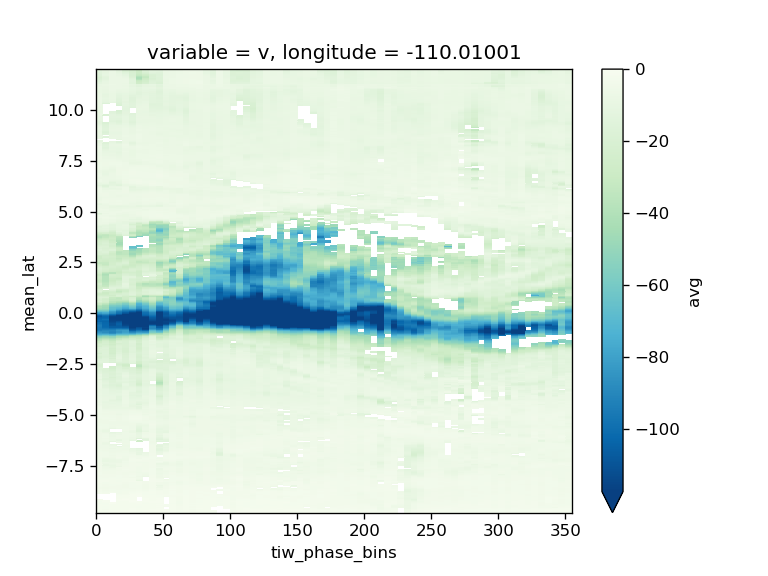

In [152]:
comp.plot("Jq", filter=True, cmap=mpl.cm.GnBu_r, vmax=0)

In [40]:
ds = xr.Dataset()
ds["uz"] = comp.uz.avg_full
ds["vz"] = comp.vz.avg_full

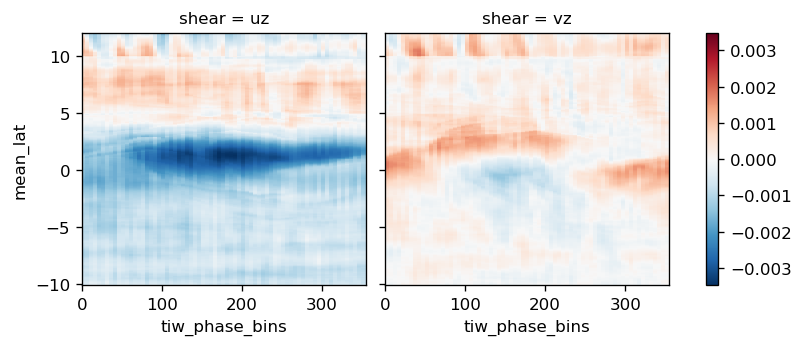

In [43]:
ds.to_array("shear").mean("depth").plot(
    col="shear", x="tiw_phase_bins", y="mean_lat", robust=False
)

In [218]:
sub = gcm1.tao.v.sel(longitude=-110, depth=slice(-10, -80), time=slice(None, "1996-03-01")).mean("depth")

In [ ]:
dcpy.ts.PlotSpectrum(sub, coord="time")

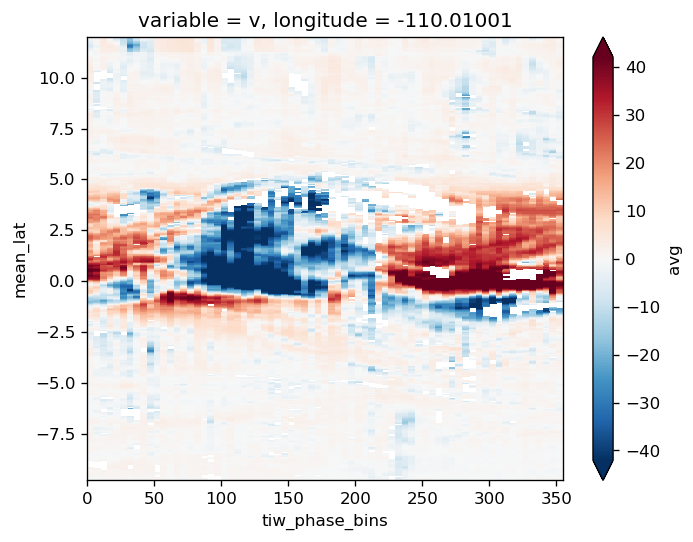

In [171]:
(comp.Jq.avg - comp.Jq.avg.mean("tiw_phase_bins")).plot(y='mean_lat', x="tiw_phase_bins", robust=True)

In [202]:
comp.load("mld")

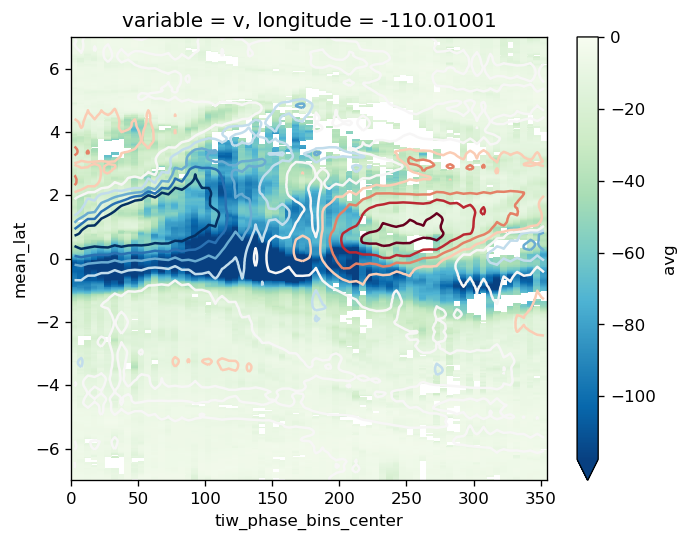

In [195]:
comp.plot("Jq", filter=True, vmax=0, cmap=mpl.cm.GnBu_r)
comp.overlay_contours("sst")
plt.ylim([-7, 7])
f.savefig("images/tiw-composite-Jq-110.png")

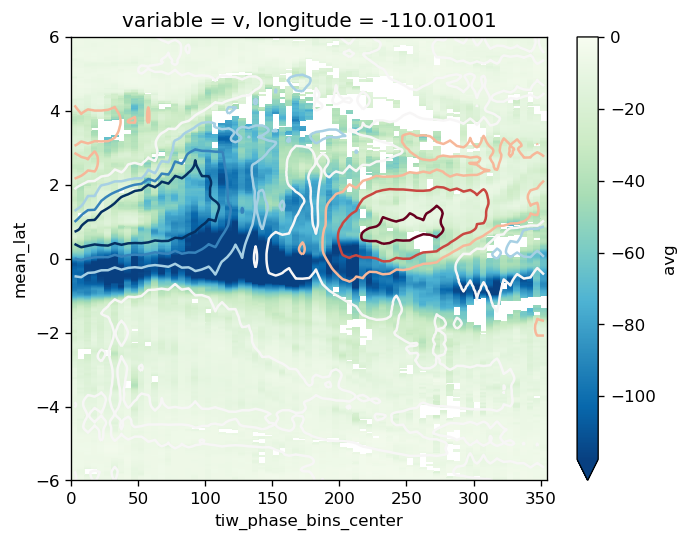

JobQueueCluster.scale_down was called with a number of worker greater than what is already running or pending.


In [182]:
%matplotlib inline

kwargs = dict(x="tiw_phase_bins", y="mean_lat", ylim=[-6,6])
comp.Jq.avg.plot(robust=True, vmax=0, cmap=mpl.cm.GnBu_r, **kwargs)
comp.sst.avg_full.plot.contour(**kwargs, linewidths=1.5, robust=True)

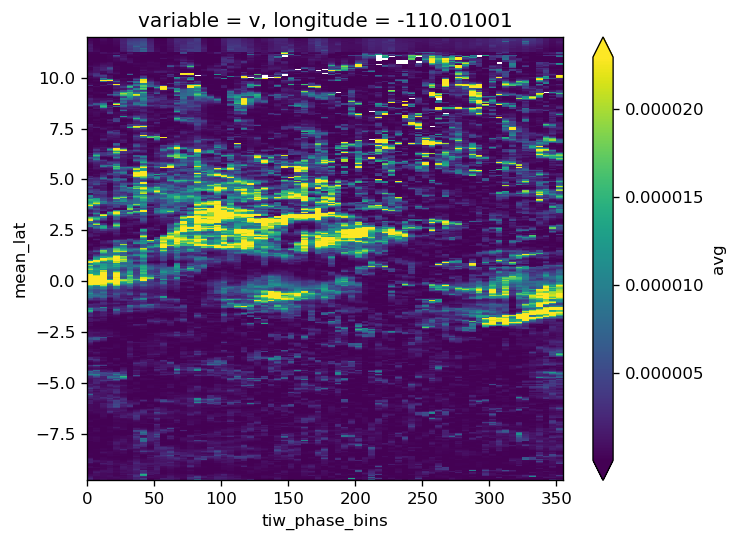

In [164]:
(comp.vz.avg**2)..mean("depth").plot(x="tiw_phase_bins", robust=True, y="mean_lat")

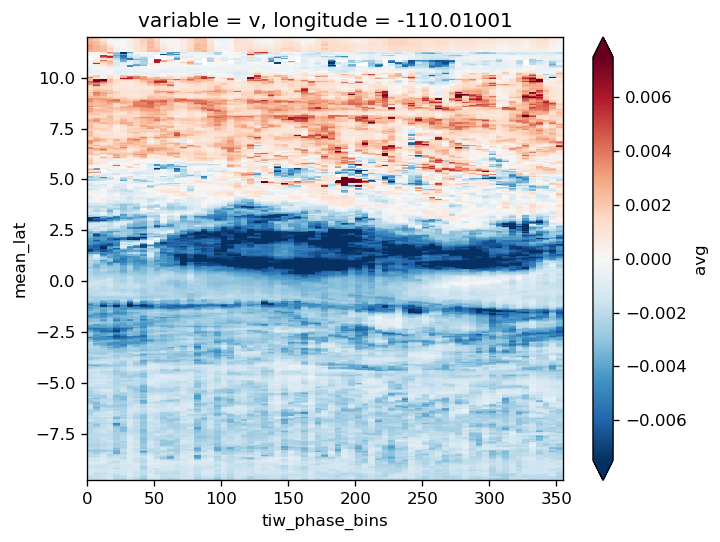

In [162]:
(comp.uz**2).mean("depth").avg.plot(x="tiw_phase_bins", robust=True, y="mean_lat")

In [156]:
comp.load(["uz", "vz", "u", "v"])

JobQueueCluster.scale_down was called with a number of worker greater than what is already running or pending.
JobQueueCluster.scale_down was called with a number of worker greater than what is already running or pending.


In [235]:
cluster.adapt(minimum=2, maximum=64, wait_count=300)

In [248]:
composite_backup = composite

This next figure is back from when I was using a Δρ MLD criterion. Note the large numbers!

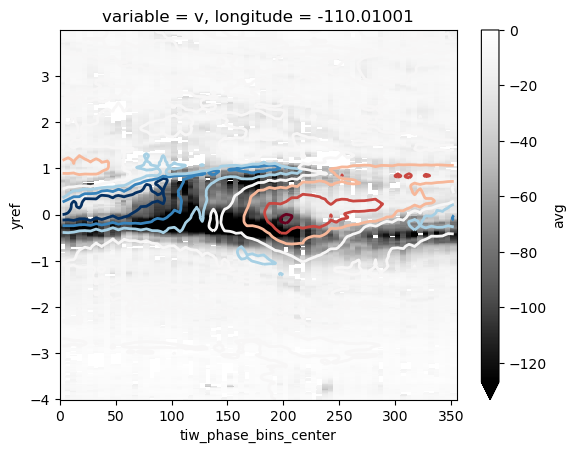

In [261]:
composite["Jq"].avg.plot(y="yref", robust=True, vmax=0, cmap=mpl.cm.Greys_r)
composite["sst"].avg_full.plot.contour(y="yref", linewidths=2, robust=True)

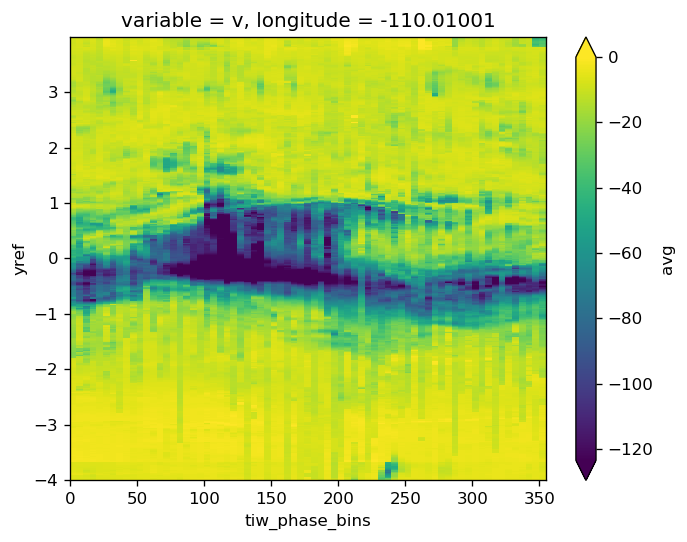

In [252]:
composite_backup["Jq"].mean("depth").avg.plot(y="yref", robust=True, vmax=0)

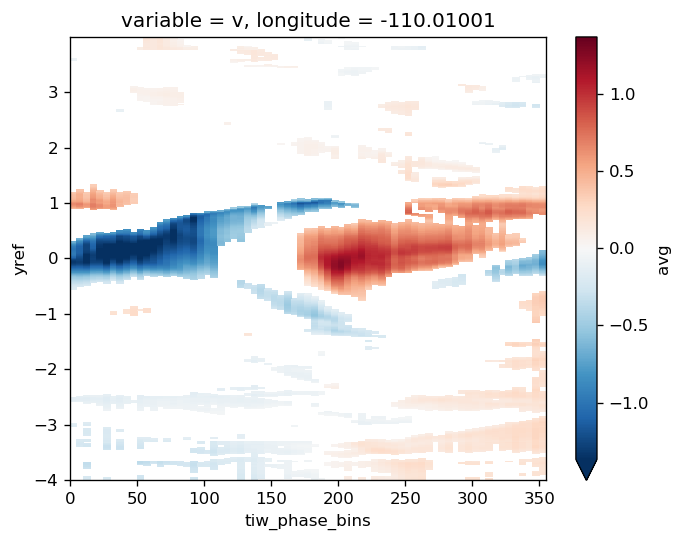

In [23]:
tanom = (full_subset.theta.groupby("period") - means.theta)
tanom

/gpfs/u/home/dcherian/python/xarray/xarray/core/common.py:674: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, the dimension order of these coordinates will be restored as well unless you specify restore_coord_dims=False.
  self, group, squeeze=squeeze, restore_coord_dims=restore_coord_dims


<xarray.DataArray 'theta' (time: 340, depth: 345, latitude: 480)>
dask.array<transpose, shape=(340, 345, 480), dtype=float32, chunksize=(1, 322, 480)>
Coordinates:
    variable   <U1 'v'
    longitude  float32 -110.01001
  * depth      (depth) float64 -0.5 -1.5 -2.5 ... -5.666e+03 -5.766e+03
  * latitude   (latitude) float32 -12.0 -11.949896 -11.899791 ... 11.949896 12.0
  * time       (time) datetime64[ns] 1995-11-19T20:00:00 ... 1996-01-15T08:00:00
    tiw_phase  (time) float32 0.0 2.3076923 4.6153846 ... 354.70587 357.35294
    period     (time) float32 5.0 5.0 5.0 5.0 5.0 5.0 ... 6.0 6.0 6.0 6.0 6.0
    yref       (time, latitude) float32 dask.array<chunksize=(148, 480), meta=np.ndarray>

In [31]:
full.yref.where(full.period.isin([5, 6])).mean("time").compute()

<xarray.DataArray 'yref' (latitude: 480)>
array([-5.07444763e+00, -5.05424070e+00, -5.03398991e+00, -5.01376867e+00,
       -4.99351597e+00, -4.97330904e+00, -4.95305824e+00, -4.93281269e+00,
       -4.91259956e+00, -4.89234066e+00, -4.87212706e+00, -4.85187674e+00,
       -4.83163261e+00, -4.81141853e+00, -4.79117393e+00, -4.77094555e+00,
       -4.75070000e+00, -4.73048496e+00, -4.71024084e+00, -4.68999243e+00,
       -4.66978216e+00, -4.64953375e+00, -4.62930393e+00, -4.60906029e+00,
       -4.58884478e+00, -4.56860161e+00, -4.54835320e+00, -4.52814102e+00,
       -4.50787783e+00, -4.48766708e+00, -4.46741867e+00, -4.44717693e+00,
       -4.42696095e+00, -4.40671301e+00, -4.38648558e+00, -4.36623907e+00,
       -4.34602594e+00, -4.32577991e+00, -4.30553913e+00, -4.28531837e+00,
       -4.26507807e+00, -4.24484396e+00, -4.22460127e+00, -4.20438385e+00,
       -4.18414402e+00, -4.16389751e+00, -4.14367962e+00, -4.12342262e+00,
       -4.10320377e+00, -4.08296251e+00, -4.06271696e+00, 

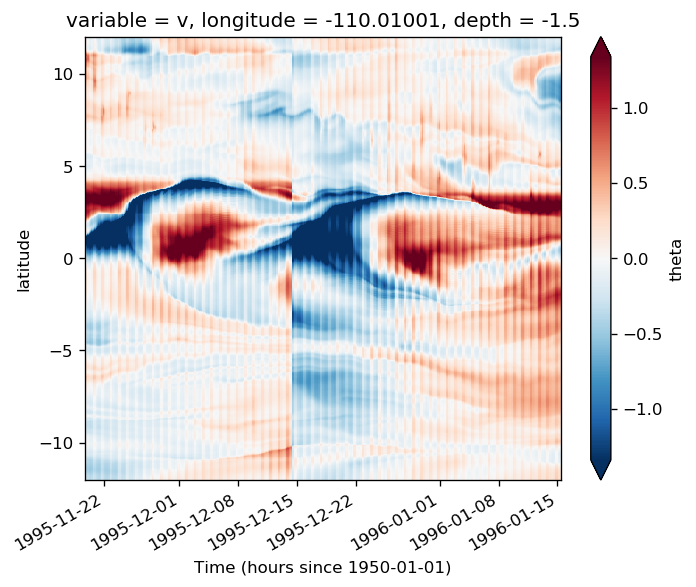

In [27]:
tanom.isel(depth=1).plot(x="time", robust=True)

In [5]:
grouped = masked[["u", "v", "salt", "theta"]].groupby("period").mean("time")

In [15]:
composite = pump.composite.make_composite(masked)

> /glade/u/home/dcherian/pump/pump/composite.py(123)make_composite()
    121     import IPython; IPython.core.debugger.set_trace()
    122 
--> 123     phase_grouped = interped.groupby_bins("tiw_phase", np.arange(0, 360, 5))
    124     data_vars = data.data_vars
    125     composite = {name: xr.Dataset(attrs={"name": name}) for name in data_vars}

ipdb> interped
<xarray.Dataset>
Dimensions:          (depth: 345, time: 340, yref: 800)
Coordinates:
  * time             (time) datetime64[ns] 1995-11-19T20:00:00 ... 1996-01-15T08:00:00
    longitude        float32 -110.01001
    variable         <U1 'v'
    tiw_phase        (time) float32 0.0 2.3076923 ... 354.70587 357.35294
    period           (time) float32 5.0 5.0 5.0 5.0 5.0 ... 6.0 6.0 6.0 6.0 6.0
  * depth            (depth) float64 -0.5 -1.5 -2.5 ... -5.666e+03 -5.766e+03
  * yref             (yref) float64 -4.0 -3.99 -3.98 -3.97 ... 3.97 3.98 3.99
Data variables:
    theta            (time, depth, yref) float64 dask.array<chunk

BdbQuit: 

In [18]:
masked.theta.groupby("period").mean(["time"])

<xarray.DataArray 'theta' (period: 2, depth: 345, latitude: 480)>
dask.array<transpose, shape=(2, 345, 480), dtype=float32, chunksize=(1, 322, 480)>
Coordinates:
    longitude  float32 -110.01001
  * depth      (depth) float64 -0.5 -1.5 -2.5 ... -5.666e+03 -5.766e+03
  * latitude   (latitude) float32 -12.0 -11.949896 -11.899791 ... 11.949896 12.0
    variable   <U1 'v'
  * period     (period) float64 5.0 6.0

In [74]:
%prun -s cumulative composite = model_composite(gcm1, -110, [5, 6])

/gpfs/u/home/dcherian/python/xarray/xarray/core/common.py:674: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, the dimension order of these coordinates will be restored as well unless you specify restore_coord_dims=False.
  self, group, squeeze=squeeze, restore_coord_dims=restore_coord_dims


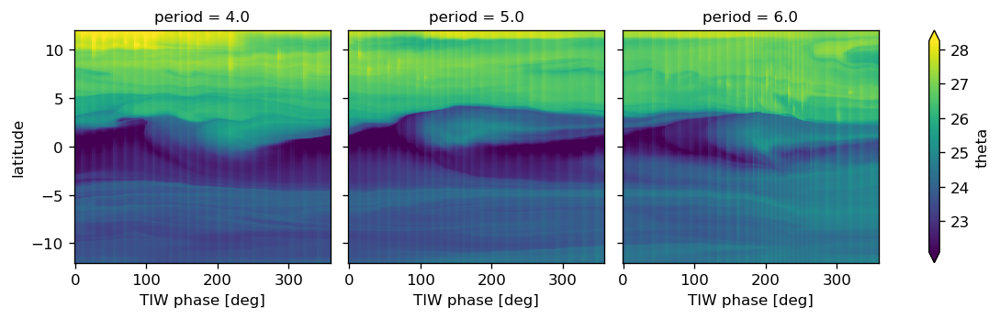

In [72]:
%matplotlib inline

period = gcm1.tao.period.sel(latitude=0, longitude=-110)
grouped = surf110.theta.groupby(period.where(period.isin([4, 5, 6])))
grouped.plot.pcolormesh(
    col="period",
    x="tiw_phase",
    robust=True,
    add_colorbar=True,
    sharex=True,
    sharey=True,
)

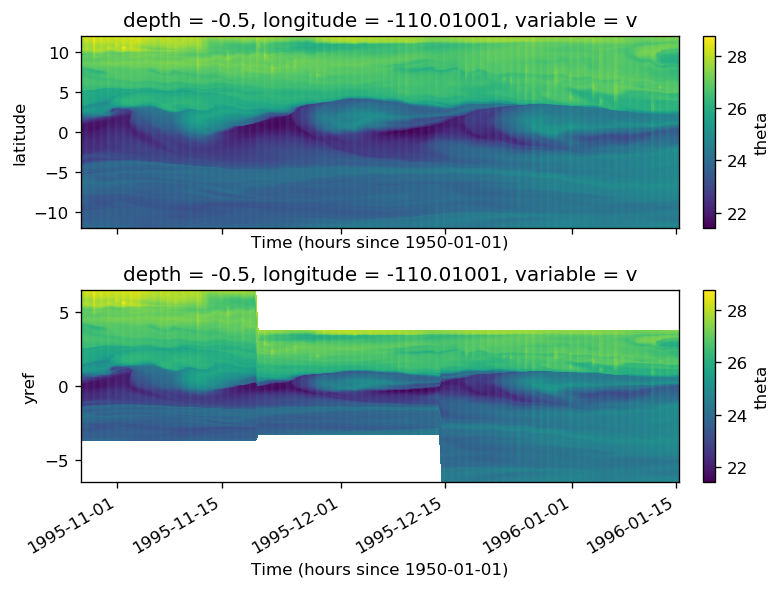

In [29]:
%matplotlib inline

subset = surf110.copy()
subset = subset.assign_coords(tmat=surf110.time.broadcast_like(surf110.theta))

f, ax = plt.subplots(2, 1, sharex=True, constrained_layout=True)
subset.theta.where(subset.period.isin([4, 5, 6]), drop=True).plot(
    x="time", y="latitude", ax=ax[0]
)
subset.theta.where(surf110.period.isin([4, 5, 6]), drop=True).plot(
    x="tmat", y="yref", ax=ax[1]
)

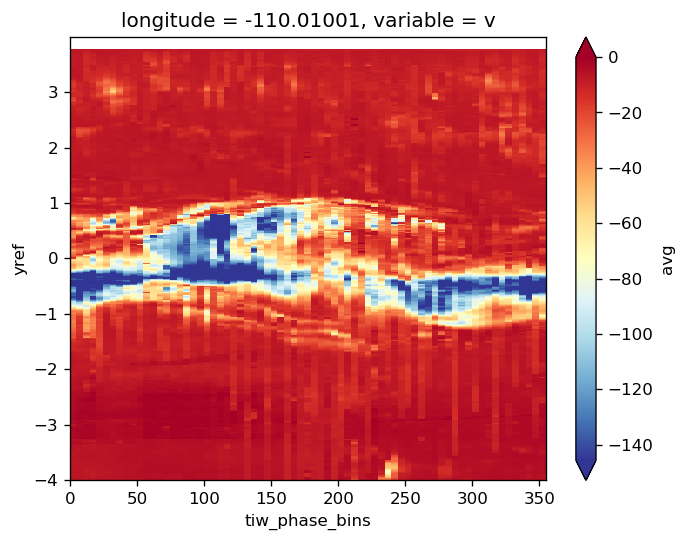

In [64]:
composite["Jq"].avg.mean("depth").plot(y="yref", vmax=0, robust=True, cmap=mpl.cm.RdYlBu_r)

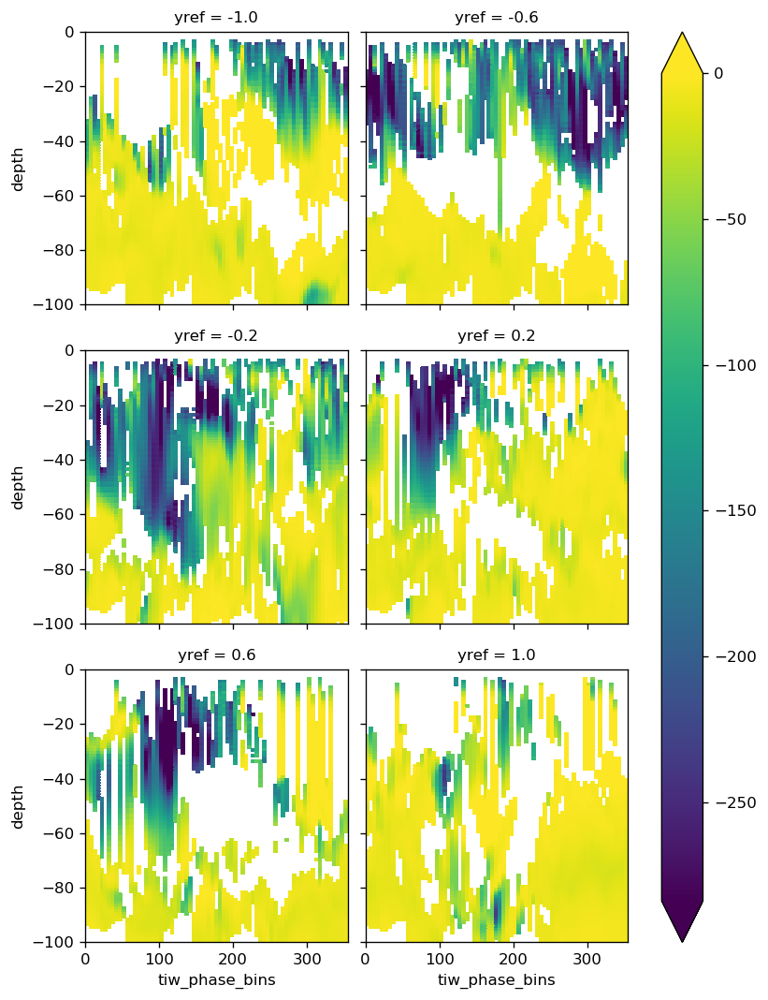

In [70]:
(
    composite["Jq"]
    .avg
    .rolling(depth=6, min_periods=4, center=True).mean()
    .sel(yref=np.linspace(-1, 1, 6), method="nearest")
    .plot(col="yref", col_wrap=2, y="depth", vmax=0, robust=True)
)

## write longitude subset to file

In [101]:
full.Jq.time.encoding

{'zlib': False,
 'shuffle': False,
 'complevel': 0,
 'fletcher32': False,
 'contiguous': True,
 'chunksizes': None,
 'source': '/glade/u/home/dcherian/pump/glade/TPOS_MITgcm_1_hb/HOLD/obs_subset/tao-budget-extract.nc',
 'original_shape': (2947,),
 'dtype': dtype('int64'),
 'units': 'hours since 1995-09-01',
 'calendar': 'proleptic_gregorian'}

In [ ]:
dcpy.dask.batch_to_zarr(full.Jq.to_dataset().chunk({"longitude": 1}),
                        dim="time",
                        file="/glade/u/home/dcherian/pump/glade/gcm1-sections-retry-Jq-2.zarr", 
                        batch_size=250)








  0%|          | 0/12 [00:00<?, ?it/s]






  8%|▊         | 1/12 [02:08<23:31, 128.35s/it]






 17%|█▋        | 2/12 [04:25<21:48, 130.87s/it]






 25%|██▌       | 3/12 [06:44<19:59, 133.32s/it]






 33%|███▎      | 4/12 [09:01<17:56, 134.53s/it]






 42%|████▏     | 5/12 [11:15<15:40, 134.39s/it]






 50%|█████     | 6/12 [13:29<13:24, 134.16s/it]






 58%|█████▊    | 7/12 [15:50<11:21, 136.31s/it]






 67%|██████▋   | 8/12 [18:21<09:23, 140.83s/it]






 75%|███████▌  | 9/12 [20:35<06:56, 138.80s/it]






 83%|████████▎ | 10/12 [22:44<04:31, 135.57s/it]






 92%|█████████▏| 11/12 [25:10<02:18, 138.71s/it]

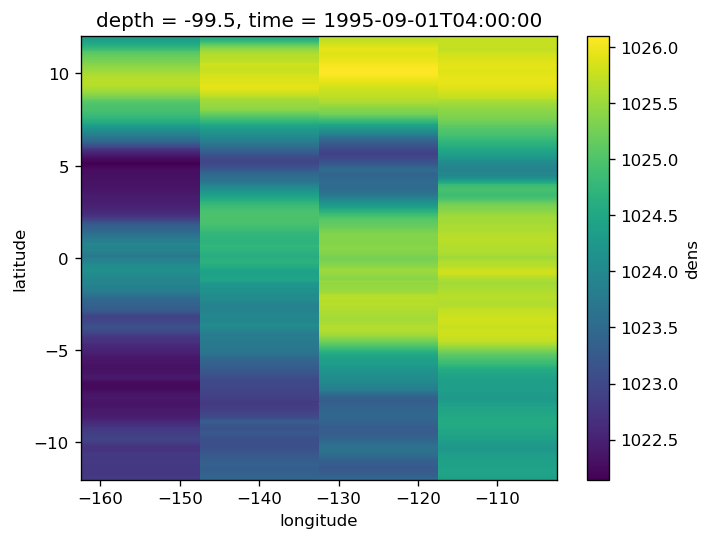

In [82]:
full1..sel(depth=-100, method="nearest").isel(time=1).plot()

In [40]:
model.read_budget()

In [56]:
del full.longitude.encoding["dtype"]

In [57]:
assert "Jq" in full

dcpy.dask.batch_to_zarr(full.chunk({"longitude": 1}), 
                        file="/glade/u/home/dcherian/pump/glade/gcm1-sections-retry.zarr",
                        dim="time",
                        batch_size=300,)



  0%|          | 0/10 [00:00<?, ?it/s]/glade/u/home/dcherian/python/xarray/xarray/core/dataset.py:1635: SerializationWarning: saving variable None with floating point data as an integer dtype without any _FillValue to use for NaNs
  append_dim=append_dim,


 10%|█         | 1/10 [08:13<1:14:05, 493.98s/it]/glade/u/home/dcherian/python/xarray/xarray/core/dataset.py:1635: SerializationWarning: saving variable None with floating point data as an integer dtype without any _FillValue to use for NaNs
  append_dim=append_dim,


 20%|██        | 2/10 [15:49<1:04:19, 482.45s/it]/glade/u/home/dcherian/python/xarray/xarray/core/dataset.py:1635: SerializationWarning: saving variable None with floating point data as an integer dtype without any _FillValue to use for NaNs
  append_dim=append_dim,


 30%|███       | 3/10 [23:52<56:17, 482.50s/it]  /glade/u/home/dcherian/python/xarray/xarray/core/dataset.py:1635: SerializationWarning: saving variable None with floating point data as an integer dtype

# consolidate compositing steps

TODO:

1. Get rid of subset_fields?

In [4]:
model = gcm1
periods = np.arange(1,9)
longitudes = [-110, -125] # -140, -155]
tslice = slice(None, "1996-03-01")
subset_fields = ["Jq", "theta", "salt", "dens", "u", "v", "w", "KPP_diffusivity", "sst", "Ri"]
anomalize_fields = ["u", "v", "w", "theta", "salt", "sst"]
anomalize_over = ["time"]

In [5]:
import xfilter

surf = (
    model.surface.sel(longitude=longitudes, method="nearest")
    .assign_coords(longitude=longitudes)
    .drop("depth")
)
tao = model.tao.sel(longitude=longitudes, latitude=0).chunk({"longitude": 1})
# tao["time"] = model.full.time

sst = surf.theta.sel(longitude=longitudes).chunk({"longitude": 1, "time": -1})
sstfilt = pump.calc.tiw_avg_filter_sst(sst, "bandpass") #.persist()

# filter out daily cycle
subdaily_sst = xfilter.lowpass(
    surf.theta.chunk({"time": -1, "latitude": 10}),
    coord="time",
    freq=2,
    cycles_per="D",
).reindex(time=tao.time)
subdaily_sst.attrs["long_name"] = "2 day filtered SST"
subdaily_sst.attrs["units"] = "C"

#surf["theta"] = (    
#    sst.pipe(xfilter.lowpass, coord="time", freq=1/7, cycles_per="D", num_discard=0, method="pad")
#)

Tx = model.surface.theta.differentiate("longitude")
Ty = model.surface.theta.differentiate("latitude")
gradT = (np.hypot(Tx, Ty)
         .sel(longitude=longitudes, method="nearest")
         .assign_coords(longitude=longitudes)
         .drop_vars("depth"))

#with performance_report("profiles/phase-period.html"):
tiw_phase, period, tiw_ptp = dask.compute(pump.calc.get_tiw_phase_sst(
    sstfilt.chunk({"longitude": 1}), 
    gradT.chunk({"longitude": 1, "time": -1})), 
)[0]

In [5]:
surf, sst, sstfilt, gradT, tiw_phase, period, tiw_ptp = model.get_quantities_for_composite(longitudes)
tao = model.tao.sel(longitude=longitudes, latitude=0).chunk({"longitude": 1})

In [6]:
from pump import composite

#with performance_report("profiles/y-reference.html"):
surf = surf.assign_coords(period=period, tiw_phase=tiw_phase, tiw_ptp=tiw_ptp)
yref, sst_ref = composite.get_y_reference(surf.theta.compute(), periods=periods, kind="warm", debug=False)
surf = surf.assign_coords(yref=yref, sst_ref=sst_ref)

In [7]:
full = xr.open_zarr("/glade/u/home/dcherian/pump/glade/gcm1-sections-retry.zarr", consolidated=True)
jq = xr.open_zarr("/glade/u/home/dcherian/pump/glade/gcm1-sections-retry-Jq-2.zarr", consolidated=True)
dens = xr.open_zarr("/glade/u/home/dcherian/pump/glade/gcm1-sections-dens.zarr", consolidated=True)
full["time"] = gcm1.tao.time
full["Jq"] = jq.Jq
assert(full.sizes["time"] == model.full.sizes["time"])
full["dens"] = dens.dens
# full
# jq = xr.open_zarr("/glade/u/home/dcherian/pump/glade/gcm1-sections-retry-Jq.zarr", consolidated=True)

In [84]:
#full = model.full.sel(longitude=longitudes, method="nearest")
#if model.budget is not None and "Jq" in model.budget:
#    full["Jq"] = model.budget.Jq.sel(longitude=longitudes, method="nearest")
#full = full.assign_coords(longitude=longitudes)

In [8]:
# needed for apply_ufunc later
valid_subset_fields = list(set(subset_fields).intersection(set(full.data_vars)))
full_subset = full[valid_subset_fields]

In [10]:
full_subset = (
    full_subset.sel(depth=slice(0, -200))
    .sel(longitude=longitudes)
    .sel(time=tslice)
    .chunk({"longitude": 1, "latitude": -1, "time": 36})
    .assign_coords(yref=yref, period=period, tiw_phase=tiw_phase,)
)
full_subset["uz"] = full_subset.u.differentiate("depth")
full_subset["vz"] = full_subset.v.differentiate("depth")
full_subset["S2"] = full_subset.uz ** 2 + full_subset.vz ** 2
full_subset["N2"] = -9.81/1025 * full_subset.dens.differentiate("depth")
full_subset["Ri"] = full_subset.N2 / full_subset.S2
full_subset["sst"] = surf.theta.sel(time=full_subset.time)  #full_subset.theta.isel(depth=0)
#if "zeta" in surf:
#    full["ssvor"] = surf.zeta

In [11]:
euc_max = tao.euc_max.reset_coords(drop=True)
mld = pump.calc.get_mld(full_subset.dens)
dcl_base = pump.calc.get_dcl_base_Ri(full_subset, mld, euc_max)

In [12]:
# kpp_mld = pump.calc.get_kpp_mld(full)
# if "KPP_diffusivity" in full:
#    kpp_diff_depth = pump.calc.kpp_diff_depth(full.KPP_diffusivity)
# else:
#    kpp_diff_depth = np.nan

# filtered = full.copy(deep=True)
# .chunk({"time": None, "latitude": None, "depth": 5}).pipe(
#    pump.utils.lowpass, "time", freq=0.5, cycles_per="D"
# )


def anomalize_single_lon(ds, to_anomalize):
    print(ds)
    if np.sum(list(ds.sizes.values())) == 0:
        return ds

    if ds.sizes["longitude"] > 1:
        raise ValueError("anomalize_single_lon received more than 1 longitude.")
    ds = ds.squeeze()
    means = ds[to_anomalize].groupby("period").mean()
    anomalies = ds.groupby("period") - means
    ds = ds.assign(anomalies).expand_dims("longitude")
    return ds


def anomalize(data, to_anomalize):
    anom = []
    for lon in data.longitude.values:
        grouped = data[to_anomalize].sel(longitude=[lon]).groupby("period")
        anom.append(grouped - grouped.mean())

    return data.assign(xr.concat(anom, "longitude"))


# calculate anomalies w.r.t period mean
to_anomalize = list(set(anomalize_fields).intersection(set(full_subset.data_vars)))
if len(to_anomalize) > 0:
    anomalized = anomalize(full_subset, to_anomalize)
    # anomalized = (full_subset.unify_chunks()
    #              .map_blocks(anomalize_single_lon,
    #                          args=[to_anomalize]))

# avoid dasky copies of "period" and "tiw_phase"
anomalized = (
    anomalized
    .assign_coords(mld=mld, dcl_base=dcl_base, dcl=np.abs(mld-dcl_base), euc_max=euc_max)
    .chunk({"latitude": -1, "time": 36})  # TODO: why isn't w chunked earlier?
    .assign_coords(full_subset.coords)
)
anomalized["wpTp"] = anomalized.w * anomalized.theta

subset = anomalized #[subset_fields]

In [13]:
depth = anomalized.depth
mld_mask = (depth >= mld) & (np.abs(mld) > 5)
dcl_mask = (depth < mld) & (depth >= dcl_base) & (np.abs(dcl_base - mld) > 5)
below_dcl_mask = (depth < dcl_base) & (depth >= euc_max) & (np.abs(dcl_base - euc_max) > 5)

masks = {"mld": mld_mask, "dcl": dcl_mask, "below_dcl": below_dcl_mask}

In [114]:
comp = pump.composite.make_composite_multiple_masks(
    subset.reset_coords(["mld", "dcl", "dcl_base"]), masks
)
comp

/glade/u/home/dcherian/python/xarray/xarray/core/common.py:664: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, the dimension order of these coordinates will be restored as well unless you specify restore_coord_dims=False.
  self, group, squeeze=squeeze, restore_coord_dims=restore_coord_dims
/glade/u/home/dcherian/python/xarray/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/glade/u/home/dcherian/python/xarray/xarray/core/common.py:664: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, the dimension order of these coordinates will be restored as well unless you specify restore_coord_dims=False.
  self, group, squeeze=squeeze, restore_coord_dims=restore_coord_dims
/glade/u/home/dcherian/python/xarray/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


{'mld': <pump.composite.Composite at 0x2b2db3fc3690>,
 'dcl': <pump.composite.Composite at 0x2b2dc9765590>,
 'below_dcl': <pump.composite.Composite at 0x2b2dd7f13210>}

/glade/u/home/dcherian/python/xarray/xarray/core/common.py:664: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, the dimension order of these coordinates will be restored as well unless you specify restore_coord_dims=False.
  self, group, squeeze=squeeze, restore_coord_dims=restore_coord_dims
Exception ignored in: <function WeakSet.__init__.<locals>._remove at 0x2b2ca93d5830>
Traceback (most recent call last):
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy_updated/lib/python3.7/_weakrefset.py", line 38, in _remove
    def _remove(item, selfref=ref(self)):
KeyboardInterrupt
distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Resta

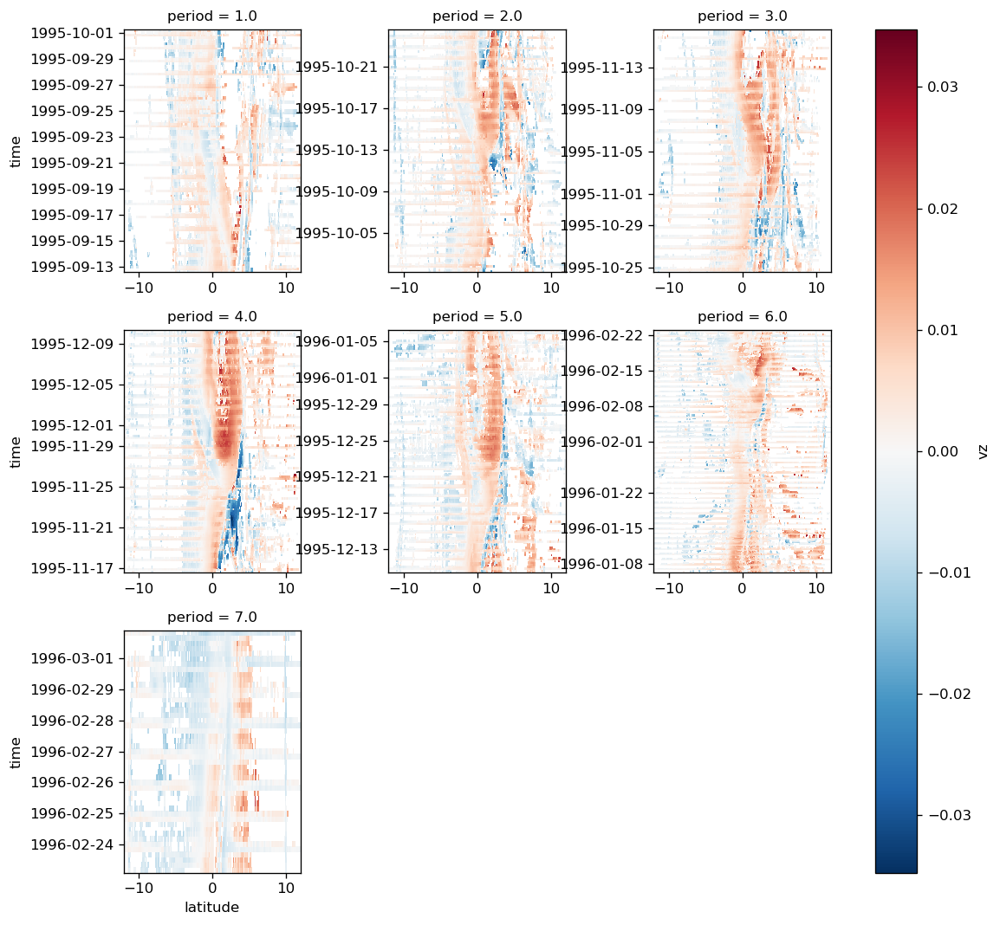

In [139]:
(
    full_subset["vz"]
    .where(masks["dcl"])
    .sel(longitude=-110)
    .mean("depth")
    .groupby("period")
    .plot(col="period", col_wrap=3,)
)

In [127]:
comp["dcl"].persist(["mld", "dcl"])

distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils - ERROR - "('zarr-getitem-6775cac93f4bd2e00f5fb3ba121cc3f7', 71, 0, 0, 0)"
Traceback (most recent call last):
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy_updated/lib/python3.7/site-packages/distributed/utils.py", line 652, in log_errors
    yield
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy_updated/lib/python3.7/site-packages/distributed/scheduler.py", line 1685, in add_worker
    typename=types[key],
KeyError: "('zarr-getitem-6775cac93f4bd2e00f5fb3ba121cc3f7', 71, 0, 0, 0)"
distributed.core - ERROR - "('zarr-getitem-6775cac93f4bd2e00f5fb3ba121cc3f7', 71, 0, 0, 0)"
Traceback (most recent call last):
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy_updated/lib/python3.7/site-packages/distributed/core.py", line 412, in handle_comm
    result = await result
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy_updated/lib/python3.7/site-packages/distrib

In [286]:
comp["dcl"].data["dcl"].avg_full.sortby("longitude").plot(
col="longitude", x="tiw_phase_bins", y="mean_lat", robust=True
)

/glade/u/home/dcherian/miniconda3/envs/dcpy_updated/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


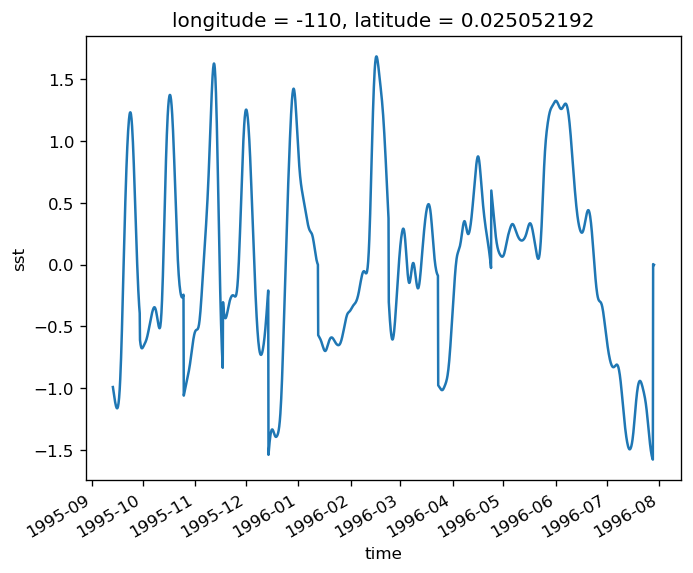

In [29]:
anomalize(full_subset[["sst"]]
          .sel(longitude=[-110], latitude=0, method="nearest"),
          ["sst"]).sst.squeeze().plot()

In [105]:
def batch_load(composites: dict, keys: list):
    tasks = []
    for name, comp in composites:
        tasks.append([comp.data[key] for key in keys])
            
    all_results = dask.compute(*tasks)
    for (_, comp), results in zip(composites, all_results):
        comp.update(dict(zip(keys, results))) 
    
batch_load(comp, ["sst", "Jq"])

{'mld': <pump.composite.Composite at 0x2b45eab07390>,
 'dcl': <pump.composite.Composite at 0x2b45d740e650>,
 'below_dcl': <pump.composite.Composite at 0x2b45ebd61d10>}

In [30]:
with performance_report("composite-sst.html"):
    comp["dcl"].load(["sst", "Jq", "uz", "vz"])

In [65]:
comp["dcl"].data["Jq"]

<xarray.Dataset>
Dimensions:         (longitude: 4, period: 287, tiw_phase_bins: 71, yref: 800)
Coordinates:
  * tiw_phase_bins  (tiw_phase_bins) object (0, 5] (5, 10] ... (350, 355]
  * yref            (yref) float64 -4.0 -3.99 -3.98 -3.97 ... 3.97 3.98 3.99
  * longitude       (longitude) int64 -110 -125 -140 -155
  * period          (period) float64 1.0 2.0 3.0 4.0 5.0 ... nan nan nan nan nan
    mean_lat        (longitude, yref) float64 -10.22 -10.19 -10.16 ... 12.0 12.0
Data variables:
    avg_full        (longitude, tiw_phase_bins, yref) float64 -5.193 ... -11.37
    dev             (longitude, tiw_phase_bins, yref) float64 1.943 ... 21.99
    err             (longitude, tiw_phase_bins, yref) float64 0.1147 ... 1.298
    avg             (longitude, tiw_phase_bins, yref) float64 -5.193 ... -11.37
Attributes:
    name:     Jq

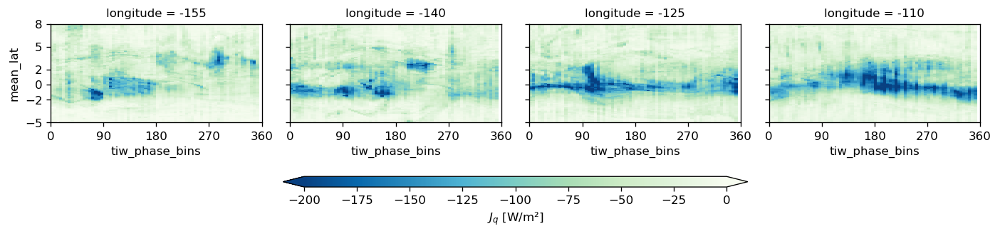

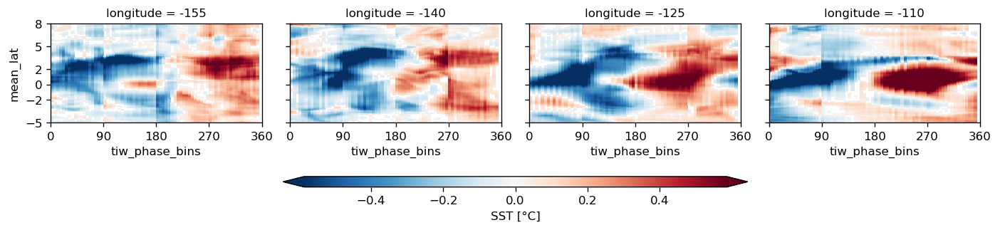

In [115]:
kwargs = dict( 
    x="tiw_phase_bins", 
    y="mean_lat",
    ylim=[-5, 8],
    xlim=[0, 360],
    xticks=[0, 90, 180, 270, 360],
    yticks=[-8, -5, -2, 0, 2, 5, 8],
)
kwargs2 = dict(
    col="longitude",
    aspect=0.9,
    cbar_kwargs={"orientation": "horizontal", "pad": 0.3, "aspect": 40, "shrink": 0.5}
)

comp["dcl"].Jq.avg.attrs["long_name"] = "$J_q$ [W/m²]"
fg = comp["dcl"].Jq.sortby("longitude").avg.plot(
    **kwargs2,
    cmap=mpl.cm.GnBu_r,
    vmax=0,
    vmin=-200,
    **kwargs,
)
#for loc, ax in zip(fg.name_dicts.flat, fg.axes.flat):
#    comp["dcl"].sst.avg.sel(loc).plot.contour(
#        ax=ax, cmap=mpl.cm.RdGy_r, levels=9, robust=True, linewidths=0.5, **kwargs, add_colorbar=False, add_labels=False
#    )
plt.gcf().savefig("images/comp-all-lon-jq.png", bbox_inches="tight", dpi=300)

comp["dcl"].sst.avg.attrs["long_name"] = "SST [°C]"
comp["dcl"].sst.sortby("longitude").avg.plot(
    robust=True,
    **kwargs2,
    **kwargs)
plt.gcf().savefig("images/comp-all-lon-sst.png", bbox_inches="tight", dpi=300)

In [255]:
mld, dcl_base = dask.compute(mld, dcl_base)
dcl_base.name = "DCL base"
mld.name = "MLD"
dcl = mld - dcl_base
dcl.name = "DCL"

In [269]:
daily_dcl = (dcl_base
 .groupby(dcl_base.time.dt.round("D")).mean()
 .rename({"round": "time"})
 
)
daily_dcl["period"] = dcl_base.period.reindex(time=daily_dcl.time)
daily_dcl

<xarray.DataArray 'DCL base' (time: 184, latitude: 480, longitude: 2)>
array([[[-26.      , -68.25    ],
        [-31.75    , -69.75    ],
        [-32.5     , -70.25    ],
        ...,
        [ -9.25    ,  -8.5     ],
        [-11.75    ,  -7.75    ],
        [ -6.5     ,  -1.5     ]],

       [[-19.1     , -58.7     ],
        [-29.3     , -60.7     ],
        [-28.5     , -61.9     ],
        ...,
        [-10.1     ,  -8.7     ],
        [-13.1     ,  -8.3     ],
        [ -6.9     ,  -1.5     ]],

       [[-33.785713, -49.357143],
        [-39.07143 , -52.642857],
        [-39.92857 , -56.07143 ],
        ...,
        [-12.785714,  -6.642857],
        [-14.214286,  -8.357142],
        [ -4.357143,  -1.5     ]],

       ...,

       [[-31.9     , -40.1     ],
        [-34.1     , -45.7     ],
        [-34.9     , -47.7     ],
        ...,
        [-29.3     , -29.9     ],
        [-28.3     , -29.1     ],
        [-28.1     , -22.1     ]],

       [[-22.642857, -40.07143 ],
        [-32.214287, -47.07143 ],
        [-34.5     , -47.92857 ],
        ...,
        [-28.214285, -29.214285],
        [-27.214285, -28.785715],
        [-26.5     , -20.071428]],

       [[ -3.      , -38.5     ],
        [-26.5     , -42.5     ],
        [-26.5     , -48.5     ],
        ...,
        [-18.      , -28.      ],
        [-17.      , -27.      ],
        [-15.      , -23.      ]]], dtype=float32)
Coordinates:
  * longitude  (longitude) int64 -110 -125
  * latitude   (latitude) float32 -12.0 -11.949896 -11.899791 ... 11.949896 12.0
  * time       (time) datetime64[ns] 1995-09-01 1995-09-02 ... 1996-03-02
    tiw_phase  (longitude, time) float64 nan nan nan nan ... 291.0 297.0 nan
    period     (longitude, time) float64 nan nan nan nan nan ... 6.0 6.0 6.0 nan

/glade/u/home/dcherian/python/xarray/xarray/core/common.py:664: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, the dimension order of these coordinates will be restored as well unless you specify restore_coord_dims=False.
  self, group, squeeze=squeeze, restore_coord_dims=restore_coord_dims


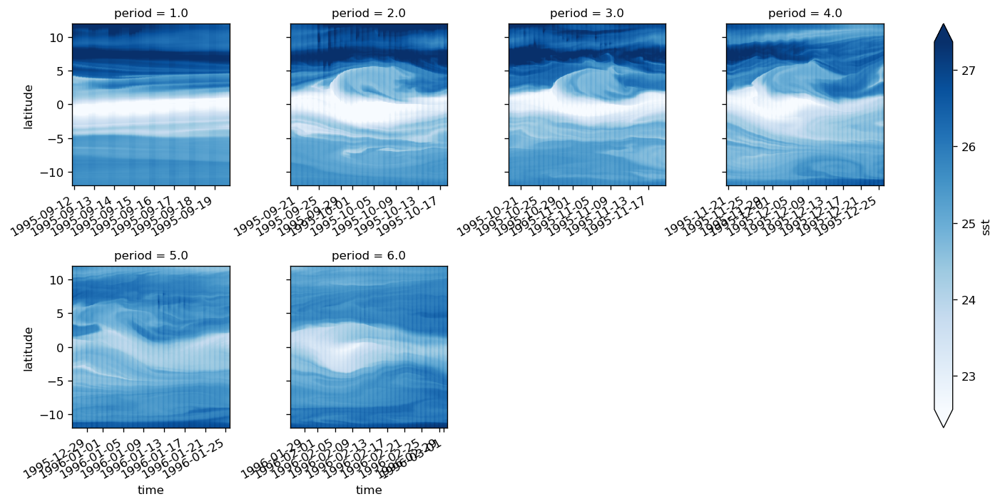

In [279]:
(
    full_subset.sst.sel(longitude=-125)
    .groupby("period")
    .plot(robust=True, cmap=mpl.cm.Blues, col="period", col_wrap=4, x="time", sharey=True)
)

NameError: name 'uz' is not defined

# some v expts

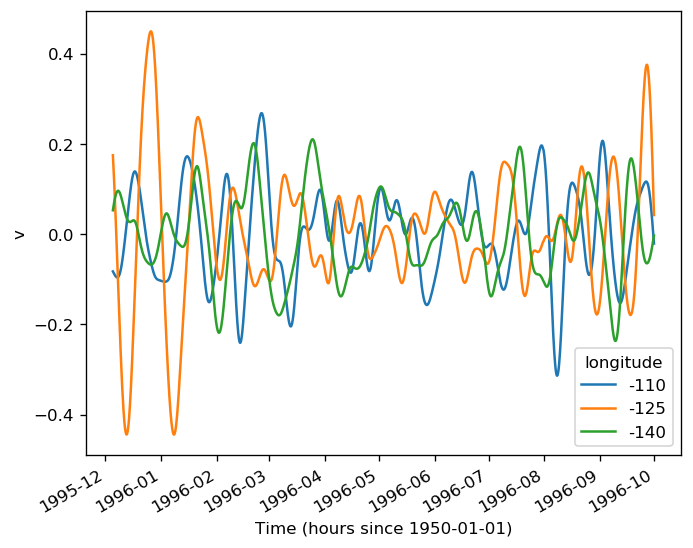

In [32]:
vfilt = xfilter.bandpass(surf.v.sel(latitude=slice(-2, 5))
                         .mean("latitude")
                         .chunk({"time": -1}), 
                 coord="time", 
                 freq=[1/10, 1/50], 
                 orde r=2,
                 cycles_per="D").compute()

vfilt.plot.line(x="time")

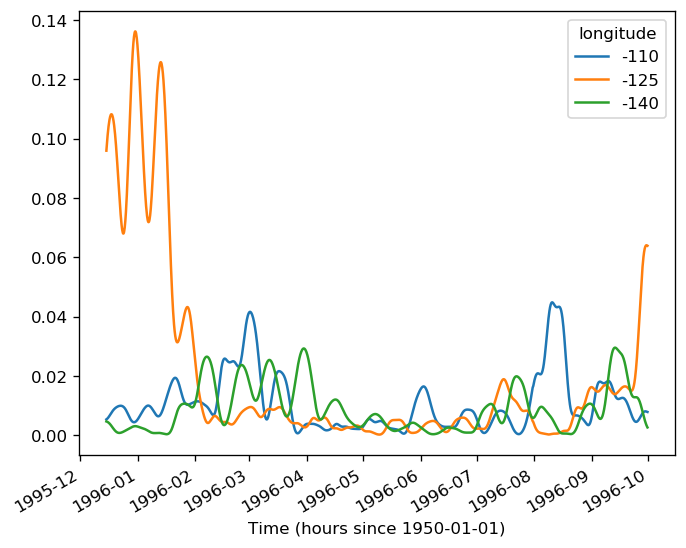

In [34]:
vfilt.rolling(time=np.int(3*20)).reduce(dcpy.util.ms).plot.line(x="time")

# single TIW period analysis

In [13]:
euc_max = tao.euc_max.reset_coords(drop=True)
# mld = pump.calc.get_mld(full_subset.dens)
# dcl_base = pump.calc.get_dcl_base_Ri(full_subset, mld, euc_max)

#dcl = (mld - dcl_base)
#dcl.attrs["long_name"] = "low Ri layer depth"
#dcl.attrs["units"] = "m"

full_subset = full_subset.assign_coords(
    mld=mld, dcl_base=dcl_base, eucmax=tao.euc_max
)

## off equatorial deep cycle mixing

In [ ]:
%matplotlib inline 

subset = (
    full_subset[["u", "v"]]
    .sel(longitude=-110, depth=0, method="nearest")
)
dcpy.plots.quiver(
    subset.sel(time=(subset.period == 4))
    .sel(latitude=slice(-6, 6))
    .isel(latitude=slice(None, None, 5), time=slice(None, None, 6))
    .reset_coords(drop=True),
    x="time",
    y="latitude",
    u="u",
    v="v",
)

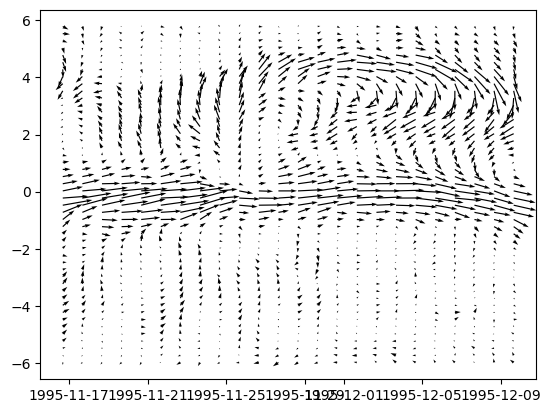

In [72]:
%matplotlib inline 

subset = (
    full_subset[["u", "v"]]
    .sel(longitude=-110, depth=-80, method="nearest")
)
dcpy.plots.quiver(
    subset.sel(time=(subset.period == 4))
    .sel(latitude=slice(-6, 6))
    .isel(latitude=slice(None, None, 5), time=slice(None, None, 6))
    .reset_coords(drop=True),
    x="time",
    y="latitude",
    u="u",
    v="v",
)

/glade/u/home/dcherian/python/xarray/xarray/core/resample.py:176: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, the dimension order of these coordinates will be restored as well unless you specify restore_coord_dims=False.
  super().__init__(*args, **kwargs)


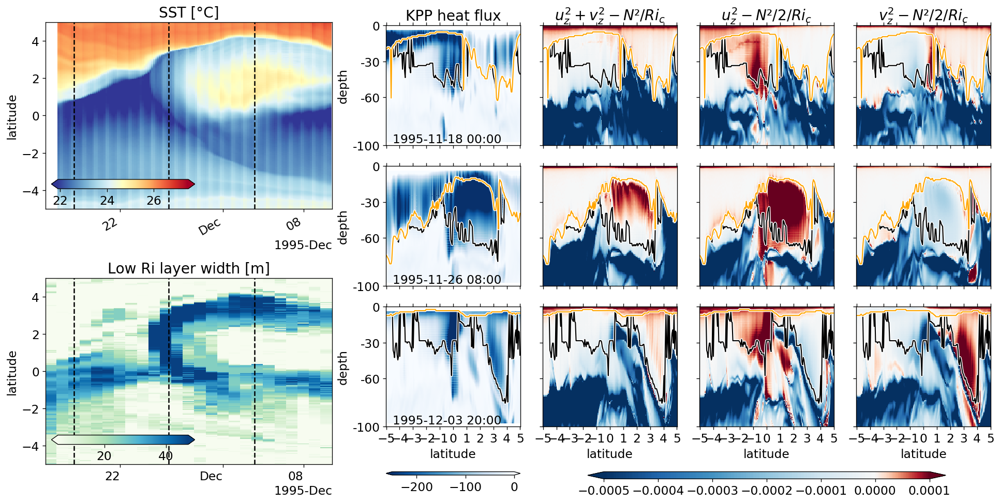

In [22]:
%matplotlib inline


def plot_time_instant(tsub, ax, add_colorbar):

    kwargs = dict(
        #vmin=-0.02,
        #vmax=0.02,
        norm=mpl.colors.DivergingNorm(vcenter=-5e-7, vmin=-5e-4, vmax=1e-4),
        cmap=mpl.cm.RdBu_r,
        add_colorbar=False,
    )

    Ric = 0.4
    (tsub.uz**2 - 1/Ric/2 * tsub.N2).plot(ax=ax["u"], **kwargs)
    (tsub.vz**2 - 1/Ric/2 * tsub.N2).plot(ax=ax["v"], **kwargs)
    # tsub.v.plot.contour(ax=ax["v"], colors="k", linewidths=1, levels=7)

    hdl = (tsub.uz**2 + tsub.vz**2 - 1/Ric * tsub.N2).plot(
        ax=ax["Ri"], **kwargs
    )
    
    if add_colorbar:
        plt.gcf().colorbar(
            hdl, 
            ax=[ax["u"], ax["v"], ax["Ri"]], 
            orientation="horizontal",
            shrink=0.8, 
            extend="both"
        )
    
    # tsub.u.plot.contour(ax=ax["Ri"], colors="k", linewidths=2, levels=5)
    #tsub.v.plot.contour(ax=ax["Ri"], colors="k", linewidths=1, levels=7)

    #tsub.Ri.plot(
    #    ax=ax["Ri"],
    #    cmap=mpl.cm.PuBu,
    #    vmin=0.1,
    #    vmax=0.5,
        # norm=mpl.colors.LogNorm(0.1, 0.5),
    #    add_colorbar=add_colorbar,
    #    cbar_kwargs={"orientation": "horizontal"} if add_colorbar else None,
    # )

    tsub.Jq.rolling(depth=7, center=True).mean().plot(
        ax=ax["Jq"],
        cmap=mpl.cm.Blues_r,
        vmin=-250,
        vmax=0,
        add_colorbar=add_colorbar,
        cbar_kwargs={
            "orientation": "horizontal", 
            "ax": [ax["Jq"]]
        } if add_colorbar else None,
    )

    def annotate(tsub, ax):
        tsub.dcl_base.plot(ax=ax, color="w", lw=3, _labels=False)
        tsub.dcl_base.plot(ax=ax, color="k", lw=1.25, _labels=False)
        tsub.mld.plot(ax=ax, color="w", lw=3, _labels=False)
        tsub.mld.plot(ax=ax, color="orange", lw=1.25, _labels=False)
        # dcpy.plots.liney(tsub.eucmax, ax=ax, zorder=10, color="k")

    axx = list(ax.values())
    [
        aa.set_title(tt)
        for aa, tt in zip(axx, ["KPP heat flux",
                                "$u_z^2 + v_z^2- N²/Ri_c$",
                                "$u_z^2 - N²/2/Ri_c$", 
                                "$v_z^2 - N²/2/Ri_c$", 
                                ])
    ]
    [aa.set_ylabel("") for aa in axx[1:]]
    [aa.set_xticks(np.arange(-5, 6, 1)) for aa in axx]
    [aa.tick_params(top=True,) for aa in axx]
    [aa.tick_params(labelbottom=False) for aa in axx]
    [annotate(tsub, aa) for aa in axx]


def plot_tiw_period_snapshots(full_subset, lon, period, times):
    subset = full_subset.sel(longitude=lon)
    subset = subset.where(subset.period == period, drop=True)

    # times = subset.time.where(subset.tiw_phase.isin(np.arange(45, 290, 45)), drop=True)

    nextra = 2
    
    plt.rcParams["font.size"] = 14
    f = plt.figure(constrained_layout=True)
    f.set_size_inches((16, 8))
    gsparent = f.add_gridspec(1, 2, width_ratios=[1, 2])
    left = gsparent[0].subgridspec(2, 1)
    ax = dict()
    ax["sst"] = f.add_subplot(left[0])
    ax["dcl"] = f.add_subplot(left[1], sharex=ax["sst"], sharey=ax["sst"])
    
        
    from mpl_toolkits.axes_grid1.inset_locator import inset_axes    
    inset_kwargs = dict(
        width="50%",  # width = 50% of parent_bbox width
        height="5%",  # height : 5%
        loc='lower left',
        bbox_to_anchor=[0, 0.075, 1, 1]
    )
    
    cax_sst = inset_axes(ax["sst"], **inset_kwargs, bbox_transform=ax["sst"].transAxes)
    cax_dcl = inset_axes(ax["dcl"], **inset_kwargs, bbox_transform=ax["dcl"].transAxes)
    
    right = gsparent[1].subgridspec(len(times), 4)
    axx = np.empty((len(times), 4), dtype=np.object)
    for icol in range(4):
        for irow in range(len(times)):
            axx[irow, icol] = f.add_subplot(right[irow, icol])
    
    # Surface fields
    cbar_kwargs=dict(aspect=40, label="", orientation="horizontal", extend="both")
    surf_kwargs = dict(
        add_colorbar=False,
        x="time",
        robust=True,
        ylim=[-5, 5],
    )
    
    hdl = subset.sst.plot(ax=ax["sst"], **surf_kwargs, cmap=mpl.cm.RdYlBu_r,
                         )
    f.colorbar(hdl, cax=cax_sst, **cbar_kwargs)
    
    hdl = (subset.mld - subset.dcl_base).resample(time="D").mean().plot(
        ax=ax["dcl"], **surf_kwargs, cmap=mpl.cm.GnBu, vmin=5,
    )
    f.colorbar(hdl, cax=cax_dcl, **cbar_kwargs)
    
    dcpy.plots.linex(times, color="k", zorder=2, ax=[ax["sst"], ax["dcl"]])
    
    # row snapshots
    sub = (
        subset[["u", "v", "uz", "vz", "N2", "Ri", "Jq"]]
        .sel(latitude=slice(-5, 5), depth=slice(-100))
        .compute()
    )
    for idx, (axrow, time) in enumerate(zip(axx, times)):
        tsub = sub.sel(time=time, method="nearest")

        add_colorbar = True if idx == (len(times) - 1) else False
        plot_time_instant(
            tsub, 
            ax=dict(zip(["Jq", "Ri", "u", "v"], axrow)), 
            add_colorbar=add_colorbar
        )
        axrow[0].text(
            x=0.05,
            y=0.05,
            s=tsub.time.dt.strftime("%Y-%m-%d %H:%M").values,
            va="center",
            ha="left",
            transform=axrow[0].transAxes,
        )
        if idx == len(times)-1:
            [aa.tick_params(labelbottom=True) for aa in axrow]
        #axrow[-1].text(
        #    x=1.05,
        #    y=0.5,
        #    s=tsub.time.dt.strftime("%Y-%m-%d %H").values,
        #    va="center",
        #    rotation=90,
        #    transform=axrow[-1].transAxes,
        #)
        if idx != (len(times) - 1):
            [aa.set_xlabel("") for aa in axrow]
        if idx != 0:
            [aa.set_title("") for aa in axrow]

    ax["sst"].set_xticklabels([])
    ax["sst"].set_xlabel("")
    ax["sst"].set_title("SST [°C]")
    ax["dcl"].set_title("Low Ri layer width [m]")
    ax["dcl"].set_xlabel("")
    dcpy.plots.concise_date_formatter(ax["dcl"], minticks=6)
    # dcpy.plots.concise_date_formatter(ax["sst"], minticks=6)

    [aa.set_yticks([-100, -60, -30, 0]) for aa in axx.flat]
    [aa.set_yticklabels([str(num) for num in [-100, -60, -30, 0]]) for aa in axx[:, 0]]
    [aa.set_yticklabels([]) for aa in axx[:, 1:].flat]
    # [tt.set_visible(True) for tt in aa.get_yticklabels() for aa in axx[:, 0]]

    return axx


plot_tiw_period_snapshots(
    full_subset,
    lon=-110,
    period=4,
    times=[
        "1995-11-18 00:00",
        #"1995-11-24 18:00",
        "1995-11-26 06:00",
        "1995-12-03 18:00",
        #"1995-12-09 18:00",
    ],
);

plt.gcf().savefig("images/sst-dcl-shred2.png", dpi=150)

In [299]:
shred2 = (
    (full_subset.uz**2 + full_subset.vz**2 - 1/0.4 * full_subset.N2)
    .sel(time="1995-12-03 20:00", longitude=-110)
).compute()

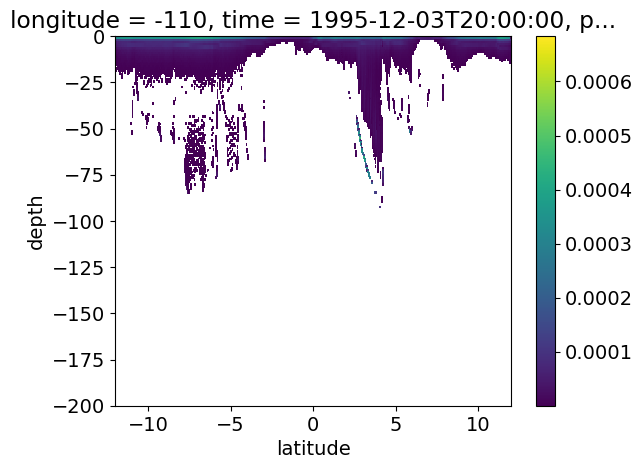

In [300]:
(
    shred2.where(shred2 > 0).plot()
);

In [67]:
client.close()

In [68]:
cluster.close()

###  are we seeing a deep cycle off the equator? Yes!

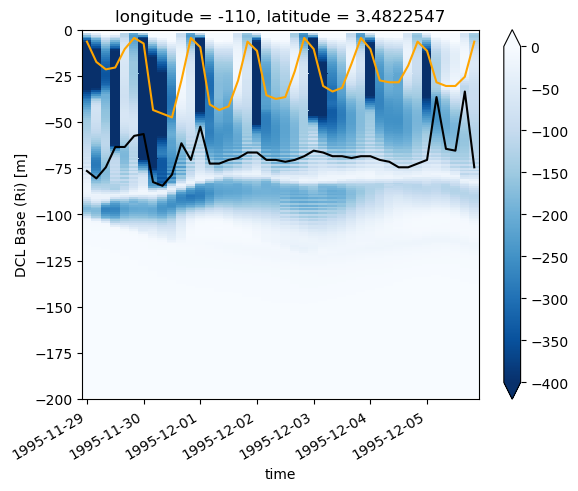

In [308]:
sub = full_subset.sel(longitude=-110, latitude=3.5, method="nearest").sel(
    time=slice("1995-11-29", "1995-12-05")
)

sub.Jq.rolling(depth=3, center=True).mean().plot(
    y="depth", cmap=mpl.cm.Blues_r, vmax=0, vmin=-400,
)
sub.mld.plot(color="orange", x="time")
sub.dcl_base.plot(color="k", x="time")

# aiyo further debugging

In [5]:
model = gcm1
longitudes = [-110, -125, -140, -155]
subset_fields = ["Jq", "theta", "dens", "u", "v", "w", "KPP_diffusivity"]

surf = (
    model.surface.sel(longitude=longitudes, method="nearest")
    .assign_coords(longitude=longitudes)
    .drop("depth")
)
tao = model.tao.sel(longitude=longitudes, latitude=0).chunk({"longitude": 1})
# tao["time"] = model.full.time

In [6]:
sst = surf.theta.sel(longitude=longitudes).chunk({"longitude": 1, "time": -1})
sstfilt = pump.calc.tiw_avg_filter_sst(sst, "bandpass") #.persist()

#surf["theta"] = (    
#    sst.pipe(xfilter.lowpass, coord="time", freq=1/7, cycles_per="D", num_discard=0, method="pad")
#)

Tx = model.surface.theta.differentiate("longitude")
Ty = model.surface.theta.differentiate("latitude")
gradT = (np.hypot(Tx, Ty)
         .sel(longitude=longitudes, method="nearest")
         .assign_coords(longitude=longitudes))

In [10]:
#with performance_report("profiles/phase-period.html"):
tiw_phase, period, tiw_ptp = dask.compute(pump.calc.get_tiw_phase_sst(
    sstfilt.chunk({"longitude": 1}), gradT.chunk({"longitude": 1, "time": -1})), 
)[0]

## test diffusive flux reconstruction

In [8]:
#CV = gcm1.metrics.cellvol
#dz = np.abs(gcm1.metrics.dRF)
# Jq = 1035 * 3999 * dz * gcm1.budget.DFrI_TH / CV

fri = full.KPP_diffusivity * (
    full.theta.diff("depth", label="upper") / full.depth.diff("depth")
).reindex(depth=full.depth)

In [117]:
def read_metrics(dirname, longitude, latitude):
    import xmitgcm

    h = dict()
    for ff in ["hFacC", "RAC", "RF", "DXC", "DYC"]:
        try:
            h[ff] = xmitgcm.utils.read_mds(dirname + ff)[ff]
        except (FileNotFoundError):
            print(f"metrics files not available. {dirname + ff}")
            metrics = None
            return xr.Dataset()

    hFacC = h["hFacC"].copy().squeeze().astype("float32")
    RAC = h["RAC"].copy().squeeze().astype("float32")
    RF = h["RF"].copy().squeeze().astype("float32")
    DXC = h["DXC"].copy().squeeze().astype("float32")
    DYC = h["DYC"].copy().squeeze().astype("float32")

    del h

    RAC = xr.DataArray(
        RAC,
        dims=["latitude", "longitude"],
        coords={"longitude": longitude, "latitude": latitude},
        name="RAC",
    )
    DXC = xr.DataArray(
        DXC,
        dims=["latitude", "longitude"],
        coords={"longitude": longitude, "latitude": latitude},
        name="DXC",
    )
    DYC = xr.DataArray(
        DYC,
        dims=["latitude", "longitude"],
        coords={"longitude": longitude, "latitude": latitude},
        name="DYC",
    )


    depth = xr.DataArray(
        (RF[1:] + RF[:-1]) / 2,
        dims=["depth"],
        name="depth",
        attrs={"long_name": "depth", "units": "m"},
    )

    RF = xr.DataArray(RF.squeeze(), dims=["depth_left"], name="depth_left")

    hFacC = xr.DataArray(
        hFacC,
        dims=["depth", "latitude", "longitude"],
        coords={
            "depth": depth,
            "latitude": latitude,
            "longitude": longitude,
        },
        name="hFacC",
    )

    metrics = xr.merge([hFacC, RAC, DXC, DYC])

    metrics["RF"] = RF
    
    metrics["rAw"] = xr.DataArray(
        xmitgcm.utils.read_mds(dirname + "/RAW")["RAW"].astype("float32"),
        dims=["latitude", "longitude"]
    )
    metrics["hFacW"] = xr.DataArray(
        xmitgcm.utils.read_mds(dirname + "/hFacW")["hFacW"].astype("float32"),
        dims=["depth", "latitude", "longitude"])

    metrics["dRF"] = xr.DataArray(
        xmitgcm.utils.read_mds(dirname + "/DRF")["DRF"].squeeze().astype("float32"),
        dims=["depth"])
    
    metrics["dRC"] = xr.DataArray(
        xmitgcm.utils.read_mds(dirname + "/DRC")["DRC"].squeeze().astype("float32"),
        dims=["depth_left"])
    
    
    metrics["cellvol"] = np.abs(metrics.RAC * metrics.dRF * metrics.hFacC)

    metrics["cellvol"] = metrics.cellvol.where(metrics.cellvol > 0)

    return metrics

metrics = read_metrics(gcm1.dirname + "../", gcm1.metrics.longitude, gcm1.metrics.latitude)
metrics

<xarray.Dataset>
Dimensions:    (depth: 345, depth_left: 346, latitude: 480, longitude: 1500)
Coordinates:
  * depth      (depth) float64 -0.5 -1.5 -2.5 ... -5.666e+03 -5.766e+03
  * latitude   (latitude) float64 -12.0 -11.95 -11.9 -11.85 ... 11.9 11.95 12.0
  * longitude  (longitude) float64 -170.0 -169.9 -169.9 ... -95.1 -95.05 -95.0
Dimensions without coordinates: depth_left
Data variables:
    hFacC      (depth, latitude, longitude) float32 dask.array<chunksize=(345, 480, 1500), meta=np.ndarray>
    RAC        (latitude, longitude) float32 dask.array<chunksize=(480, 1500), meta=np.ndarray>
    DXC        (latitude, longitude) float32 dask.array<chunksize=(480, 1500), meta=np.ndarray>
    DYC        (latitude, longitude) float32 dask.array<chunksize=(480, 1500), meta=np.ndarray>
    RF         (depth_left) float32 dask.array<chunksize=(346,), meta=np.ndarray>
    rAw        (latitude, longitude) float32 dask.array<chunksize=(480, 1500), meta=np.ndarray>
    hFacW      (depth, latitude, longitude) float32 dask.array<chunksize=(345, 480, 1500), meta=np.ndarray>
    dRF        (depth) float32 dask.array<chunksize=(345,), meta=np.ndarray>
    dRC        (depth_left) float32 dask.array<chunksize=(346,), meta=np.ndarray>
    cellvol    (latitude, longitude, depth) float32 dask.array<chunksize=(480, 1500, 345), meta=np.ndarray>

In [118]:
metrics.load()

<xarray.Dataset>
Dimensions:    (depth: 345, depth_left: 346, latitude: 480, longitude: 1500)
Coordinates:
  * depth      (depth) float64 -0.5 -1.5 -2.5 ... -5.666e+03 -5.766e+03
  * latitude   (latitude) float64 -12.0 -11.95 -11.9 -11.85 ... 11.9 11.95 12.0
  * longitude  (longitude) float64 -170.0 -169.9 -169.9 ... -95.1 -95.05 -95.0
Dimensions without coordinates: depth_left
Data variables:
    hFacC      (depth, latitude, longitude) float32 1.0 1.0 1.0 ... 0.0 0.0 0.0
    RAC        (latitude, longitude) float32 30228614.0 ... 30228614.0
    DXC        (latitude, longitude) float32 5437.903 5437.903 ... 5437.903
    DYC        (latitude, longitude) float32 5558.8735 5558.8735 ... 5558.8735
    RF         (depth_left) float32 0.0 -1.0 -2.0 ... -5715.922 -5815.922
    rAw        (latitude, longitude) float32 30228614.0 ... 30228614.0
    hFacW      (depth, latitude, longitude) float32 1.0 1.0 1.0 ... 0.0 0.0 0.0
    dRF        (depth) float32 1.0 1.0 1.0 1.0 1.0 ... 100.0 100.0 100.0 100.0
    dRC        (depth_left) float32 0.5 1.0 1.0 1.0 ... 100.0 100.0 100.0 50.0
    cellvol    (latitude, longitude, depth) float32 30228614.0 ... nan

In [63]:
# region.pop("time")
dz = submetrics.dRF
(CV / A / dz).isel(region).plot()

In [70]:
gcm1.full.KPP_diffusivity.sel(longitude=full.longitude, method="nearest")

<xarray.DataArray 'KPP_diffusivity' (time: 2947, depth: 345, latitude: 480, longitude: 4)>
dask.array<getitem, shape=(2947, 345, 480, 4), dtype=float32, chunksize=(1, 345, 138, 2), chunktype=numpy.ndarray>
Coordinates:
  * latitude   (latitude) float32 -12.0 -11.949896 -11.899791 ... 11.949896 12.0
  * longitude  (longitude) float32 -110.01001 -125.02001 -139.97998 -154.98999
  * depth      (depth) float32 -0.5 -1.5 -2.5 ... -5565.922 -5665.922 -5765.922
  * time       (time) datetime64[ns] 1995-09-01 ... 1997-01-04T12:00:00

In [114]:
dfrith/A.isel()

<xarray.DataArray 'DFrI_TH' (depth: 345)>
array([            nan, -9.84640869e+02, -1.06775061e+03, -8.92413025e+02,
       -7.10939514e+02, -5.65853516e+02, -4.58421387e+02, -3.83281128e+02,
       -3.34394684e+02, -3.06540833e+02, -2.95508820e+02, -2.98155762e+02,
       -3.10614716e+02, -3.32025696e+02, -3.60765747e+02, -3.95465576e+02,
       -4.35004974e+02, -4.78826935e+02, -5.26109741e+02, -5.76375305e+02,
       -6.29281677e+02, -6.84362183e+02, -7.41226685e+02, -7.99443359e+02,
       -8.66984131e+02, -9.36014832e+02, -1.00630701e+03, -1.07773914e+03,
       -1.15021619e+03, -1.22355042e+03, -1.29759924e+03, -1.37214648e+03,
       -1.44691406e+03, -1.52174573e+03, -1.59629163e+03, -1.67014771e+03,
       -1.74293042e+03, -1.81425244e+03, -1.88378223e+03, -1.95131934e+03,
       -2.01647046e+03, -2.07842212e+03, -2.12958789e+03, -2.17602612e+03,
       -2.21851440e+03, -2.25459351e+03, -2.28871509e+03, -2.31227686e+03,
       -2.34022803e+03, -2.34663525e+03, -2.37501025e+03, -2.35317529e+03,
       -2.39943359e+03, -2.32019238e+03, -2.43209131e+03, -2.21714502e+03,
       -2.50988184e+03, -1.99075464e+03, -2.66711987e+03, -1.61633960e+03,
       -2.87673340e+03, -1.15387781e+03, -3.01910889e+03, -7.51535583e+02,
       -2.91097241e+03, -6.12609375e+02, -2.34943042e+03, -8.25676514e+02,
       -1.46861096e+03, -7.17710754e+02, -3.45319489e+02, -3.29282150e+01,
       -1.56359043e+01, -1.83019161e+01, -1.95279846e+01, -2.14446812e+01,
       -2.31714802e+01, -2.53912659e+01, -2.81721210e+01, -3.21689224e+01,
       -3.73722992e+01, -4.37606812e+01, -5.09668961e+01, -5.80741158e+01,
       -6.36207962e+01, -6.61839752e+01, -6.54514008e+01, -6.27203178e+01,
       -6.02733574e+01, -5.98188171e+01, -6.07617264e+01, -6.00670128e+01,
       -5.44340477e+01, -4.33324394e+01, -3.00823364e+01, -1.94023209e+01,
       -1.24608316e+01, -8.05901432e+00, -6.18843889e+00, -4.64766884e+00,
       -5.42471027e+00, -7.29998302e+00, -5.95052767e+00, -4.99892473e+00,
       -4.04294825e+00, -4.12073088e+00, -4.51009607e+00, -4.99179840e+00,
       -5.44489288e+00, -5.82171869e+00, -6.47219563e+00, -8.49984646e+00,
       -1.71369171e+01, -6.62071762e+01, -9.32546539e+01, -1.06937912e+02,
       -1.00669403e+02, -9.22931290e+01, -9.75379791e+01, -9.59267502e+01,
       -8.63247147e+01, -8.01445084e+01, -8.53068085e+01, -9.35369873e+01,
       -6.96072083e+01, -3.46711845e+01, -7.35902357e+00, -4.77784634e+00,
       -2.37863159e+00, -1.30548060e+00, -1.17674935e+00, -1.03233266e+00,
       -3.92799258e-01, -6.63164675e-01, -2.45445061e+00, -6.47563028e+00,
       -1.05928469e+01, -7.11079407e+01, -1.17762115e+02, -1.32642410e+02,
       -1.90446320e+02, -1.54128067e+02, -2.75537384e+02, -1.46966812e+02,
       -3.73572876e+02, -1.29266602e+02, -4.63988739e+02, -1.16902222e+02,
       -5.36056030e+02, -1.13203728e+02, -5.90389404e+02, -1.15067810e+02,
       -6.29040405e+02, -1.19666237e+02, -6.54039673e+02, -1.24748627e+02,
       -6.66721008e+02, -1.28887375e+02, -6.67558289e+02, -1.31692123e+02,
       -6.56304504e+02, -1.33689178e+02, -6.32199707e+02, -1.36666306e+02,
       -5.93815552e+02, -1.43737976e+02, -5.39520203e+02, -1.58421082e+02,
       -4.68603027e+02, -1.80833725e+02, -3.86418457e+02, -2.01913452e+02,
       -3.04188660e+02, -2.06629410e+02, -2.36235931e+02, -1.90954361e+02,
       -1.90146790e+02, -1.63997559e+02, -1.46952759e+02, -1.16640526e+02,
       -8.78911743e+01, -5.48782082e+01, -3.88912849e+01, -3.64054642e+01,
       -3.94825974e+01, -4.52120285e+01, -5.22396126e+01, -5.74253883e+01,
       -5.95910721e+01, -6.24456024e+01, -6.47752457e+01, -6.64396744e+01,
       -6.76228638e+01, -6.88572693e+01, -7.07819290e+01, -7.30026779e+01,
       -7.48184509e+01, -7.60984344e+01, -7.65201721e+01, -7.62321320e+01,
       -7.56689987e+01, -7.44238815e+01, -7.13286743e+01, -6.31676712e+01,
       -4.78859177e+01, -2.55000858e+01, -8.91213512e+00, -6.69313622e+00,
       -7.49182892e+00, -7.77553177e+00, -5.95756483e+00, 

In [75]:
dfrith = (
    gcm1.budget.DFrI_TH.sel(longitude=full.longitude, method="nearest")
    .isel(**region, time=100)
    .load()
)

In [81]:
expected = dfrith

expected.plot(y="depth")
(full.Jq / 1035 / 3999 * CV).isel(**region, time=100).plot(y="depth")

In [113]:
metrics

<xarray.Dataset>
Dimensions:    (depth: 345, depth_left: 346, latitude: 480, longitude: 1500)
Coordinates:
  * depth      (depth) float64 -0.5 -1.5 -2.5 ... -5.666e+03 -5.766e+03
  * latitude   (latitude) float64 -12.0 -11.95 -11.9 -11.85 ... 11.9 11.95 12.0
  * longitude  (longitude) float64 -170.0 -169.9 -169.9 ... -95.1 -95.05 -95.0
Dimensions without coordinates: depth_left
Data variables:
    hFacC      (depth, latitude, longitude) float32 dask.array<chunksize=(345, 480, 1500), meta=np.ndarray>
    RAC        (latitude, longitude) float32 dask.array<chunksize=(480, 1500), meta=np.ndarray>
    DXC        (latitude, longitude) float32 dask.array<chunksize=(480, 1500), meta=np.ndarray>
    DYC        (latitude, longitude) float32 dask.array<chunksize=(480, 1500), meta=np.ndarray>
    RF         (depth_left) float32 dask.array<chunksize=(346,), meta=np.ndarray>
    rAw        (latitude, longitude) float32 dask.array<chunksize=(480, 1500), meta=np.ndarray>
    hFacW      (depth, latitude, longitude) float32 dask.array<chunksize=(345, 480, 1500), meta=np.ndarray>
    dRF        (depth) float32 dask.array<chunksize=(345,), meta=np.ndarray>
    dRC        (depth_left) float32 dask.array<chunksize=(346,), meta=np.ndarray>
    cellvol    (latitude, longitude, depth) float32 dask.array<chunksize=(480, 1500, 345), meta=np.ndarray>

In [ ]:
%matplotlib qt

rhoFacF = 346
deepFac2F = 1 


submetrics = metrics.sel(longitude=full.longitude, method="nearest").assign_coords(
    longitude=full.longitude
)
dz = submetrics.dRF
# dz = submetrics.dRC[:-1].rename({"depth_left": "depth"}).assign_coords(depth=submetrics.depth)

A = submetrics.RAC
CV = submetrics.cellvol

region = dict(longitude=0, latitude=240, time=100)

recon = (
    full.KPP_diffusivity * full.theta.diff("depth").reindex(depth=full.depth) * A / dz
).isel(**region)

expected = (full.Jq / 1035 / 3999 * CV).isel(**region)

(recon).plot(y="depth")
(expected).plot(y="depth")

## work on dcl, mld detection

In [75]:
mld = pump.calc.get_mld(full_subset.dens)
dcl_base = pump.calc.get_dcl_base_Ri(full_subset, mld, euc_max)

region = dict(
    longitude=-110, latitude=-4, method="nearest"
 )
tslice=slice("1995-12-01", "1996-12-05")
# tslice=slice("1995-12-21", "1996-01-21")

rho, r, m, d = dask.compute(
    full_subset.dens.sel(**region).sel(time=tslice),
    full_subset.Ri.sel(**region).sel(time=tslice),
    mld.sel(**region).sel(time=tslice),
    dcl_base.sel(**region).sel(time=tslice),
)

In [121]:
dd = d.diff("time", label="lower") #.plot(color='k')
d = d.where(np.abs(dd) < 45).ffill("time")

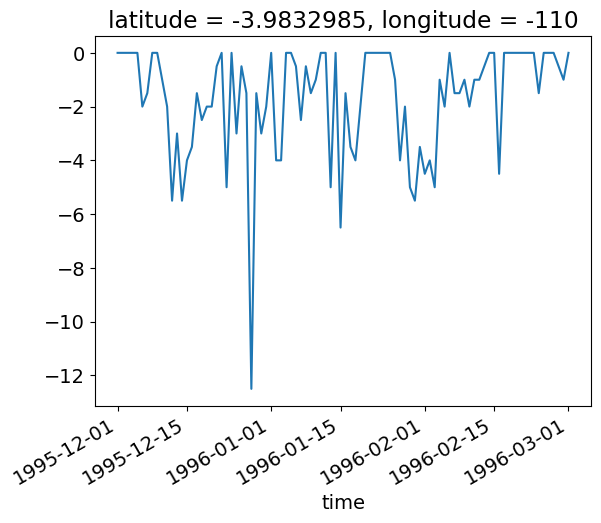

In [104]:
(d-m).resample(time='D').median().plot()

Text(0.8, 0.8, 'DCL=43.0m')

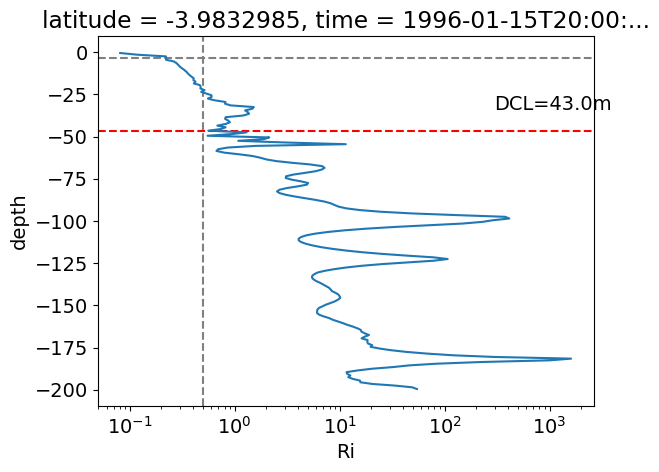

In [100]:
%matplotlib inline
tt = "1996-01-15 20:00"
r.sel(time=tt).plot(y="depth", xscale="log")
dcpy.plots.linex(0.5)
dcpy.plots.liney(m.sel(time=tt))
dcpy.plots.liney(d.sel(time=tt), color='r')
plt.gca().text(0.8, 0.8, f"DCL={(m-d).sel(time=tt).values}m", transform=plt.gca().transAxes)

In [26]:
r.where((r.depth < m) & (r.depth > d)).median("depth").plot()

In [53]:
%matplotlib qt

f, ax=  plt.subplots(2, 1, sharex=True, sharey=True)
r.plot(
    ax=ax[0],
    #robust=True,
    #vmin=-1,
    #vmax=1,
    #center=0,
    #cmap=mpl.cm.RdBu_r,
    norm=mpl.colors.LogNorm(0.25, 1), 
    x="time", 
    ylim=(-150, 0)
)
m.plot.line(ax=ax[0], x="time", color="k")
d.plot.line(ax=ax[0], x="time", color="r")
d.resample(time="D").mean().plot(ax=ax[0], x="time", color='b')

cum_Ri = (r.where((r > 0) & (r.depth < m)).cumsum("depth")/r.depth.copy(data=np.arange(1, r.sizes["depth"]+1)))
cum_Ri.plot(
    ax=ax[1],
    #robust=True,
    #vmin=-1,
    #vmax=1,
    #center=0,
    cmap=mpl.cm.RdBu_r,
    norm=mpl.colors.LogNorm(0.25, 1), 
    x="time", 
    ylim=(-150, 0)
)
m.plot.line(ax=ax[1], x="time", color="k")
d.plot.line(ax=ax[1], x="time", color="r")

In [ ]:
plt.figure(); 
(
    (rho.differentiate("depth") * -9.81/1025)
    #.sel(time=slice("1995-11-26", "1995-11-30"), depth=slice(0, -50))
    .plot(y="depth", robust=True)
)

/glade/u/home/dcherian/python/xarray/xarray/core/common.py:664: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, the dimension order of these coordinates will be restored as well unless you specify restore_coord_dims=False.
  self, group, squeeze=squeeze, restore_coord_dims=restore_coord_dims
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)


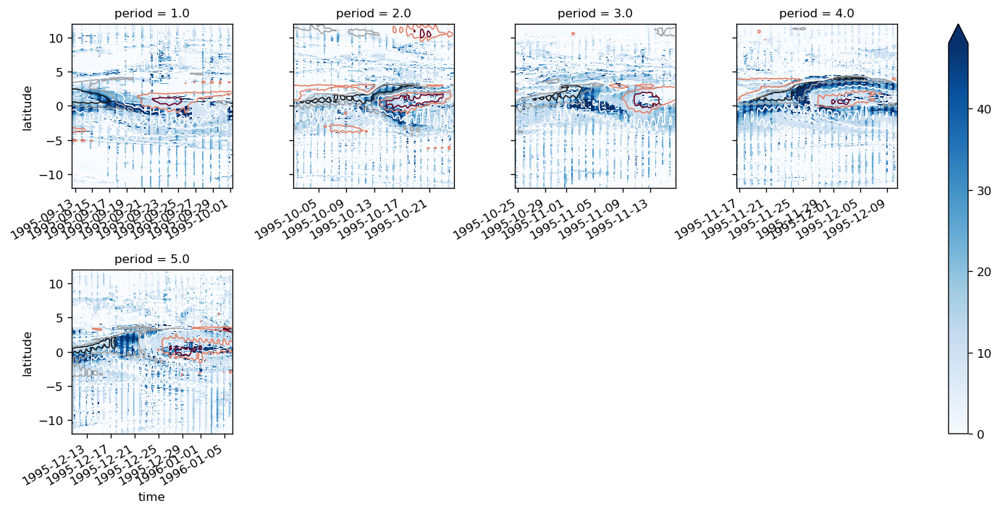

In [132]:
%matplotlib qt

lon=-110

good_mask = dcl_base.period.sel(longitude=lon).isin(pump.composite.good_periods[lon])

fg = (
    np.abs(dcl_base-mld).sel(longitude=lon)
    .where(good_mask, drop=True)
    .groupby("period").plot(col="period", col_wrap=4, x="time", robust=True, cmap=mpl.cm.Blues, sharey=True)
)

sst_mask = sst.sel(longitude=-110).where(good_mask, drop=True).load()

for loc, ax in zip(fg.name_dicts.flat, fg.axes.flat):
    if loc is not None:
        (sst_mask.where(sst_mask.period == loc["period"], drop=True)
         .pipe(lambda x: x - x.mean("time"))
         .plot.contour(cmap=mpl.cm.RdGy_r, levels=5, linewidths=1, ax=ax, robust=True, x="time", add_labels=False))

## Test out new phase detection

With -110 as a special case for bandpass window and prominence

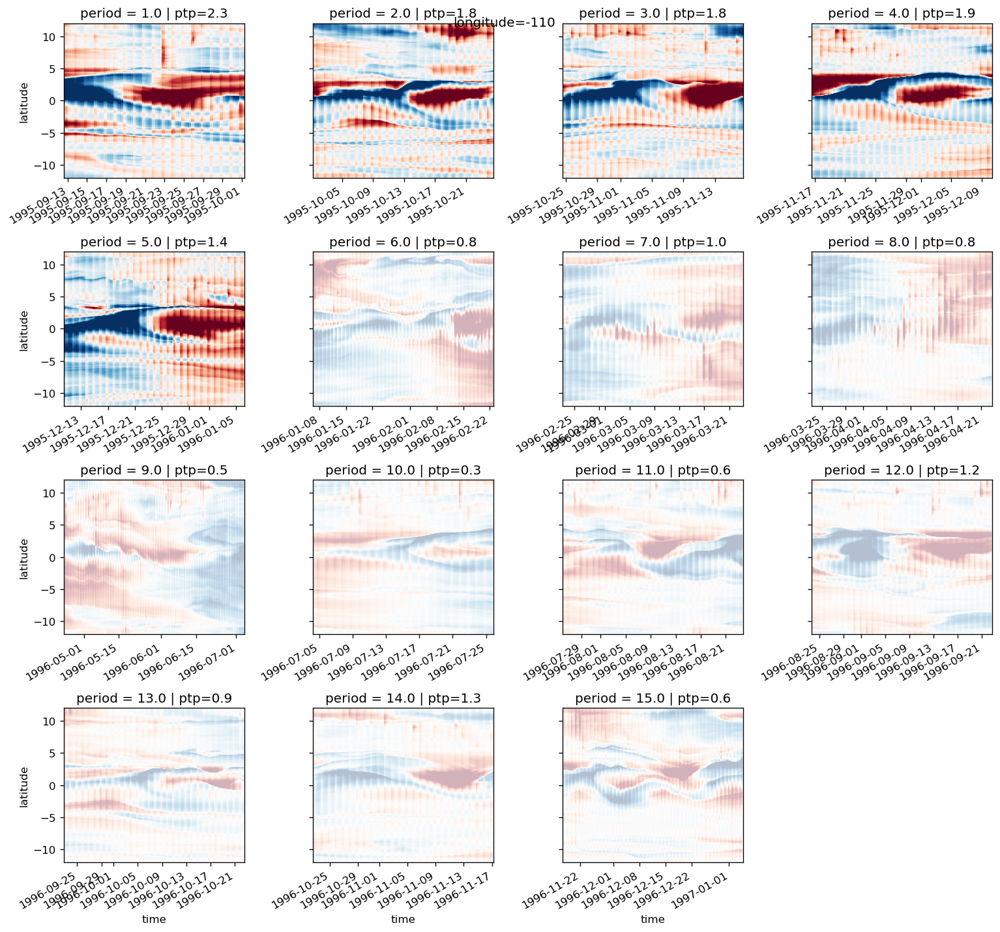

In [353]:
lon = -110

sst_anom = sst.assign_coords(period=period, tiw_ptp=tiw_ptp, tiw_phase=tiw_phase).sel(
    longitude=lon
)
sst_anom = sst_anom.groupby("period") - sst_anom.groupby("period").mean("time")
sst_anom.load()

good_periods = pump.composite.good_periods[lon]

fg = sst_anom.groupby("period").plot(
    col="period",
    col_wrap=4,
    robust=True,
    sharey=True,
    x="time",
    add_colorbar=False,
)

fg.fig.suptitle(f"longitude={lon}")

for loc, ax in zip(fg.name_dicts.flat, fg.axes.flat):
    if loc is not None:
        newtitle = (
            ax.get_title()
            + f" | ptp={np.round(fg.data.get_group(loc['period']).tiw_ptp.values[0], 1)}"
        )
        ax.set_title(newtitle)

        if loc["period"] not in good_periods:
            ax.add_patch(
                mpl.patches.Rectangle(
                    (0, 0), 1, 1, transform=ax.transAxes, color="w", alpha=0.7,
                )
            )

[764 856 878]
<xarray.DataArray 'tiw_phase' (period: 6)>
array([172.7027027 , 170.        , 145.58823529, 123.42857143,
        55.38461538, 210.        ])
Coordinates:
    time       (period) datetime64[ns] 1995-09-18T08:00:00 ... 1996-02-12T04:00:00
    longitude  int64 -110
  * period     (period) float64 1.0 2.0 3.0 4.0 5.0 6.0


/glade/u/home/dcherian/pump/pump/calc.py:578: UserWarning: Found periods where SST front is before phase=90: [5.]
  #  IPython; IPython.core.debugger.set_trace()


5.0
[0.64294219 0.78497016]
<xarray.DataArray 'time' (time: 2)>
array(['1995-12-14T12:00:00.000000000', '1995-12-17T16:00:00.000000000'],
      dtype='datetime64[ns]')
Coordinates:
  * time       (time) datetime64[ns] 1995-12-14T12:00:00 1995-12-17T16:00:00
    longitude  int64 -110
    tiw_phase  (time) float64 55.38 99.0
    period     (time) float64 5.0 5.0
Attributes:
    long_name:            Time (hours since 1950-01-01)
    standard_name:        time
    axis:                 T
    _CoordinateAxisType:  Time
1995-12-17T16:00:00.000000000
99.0


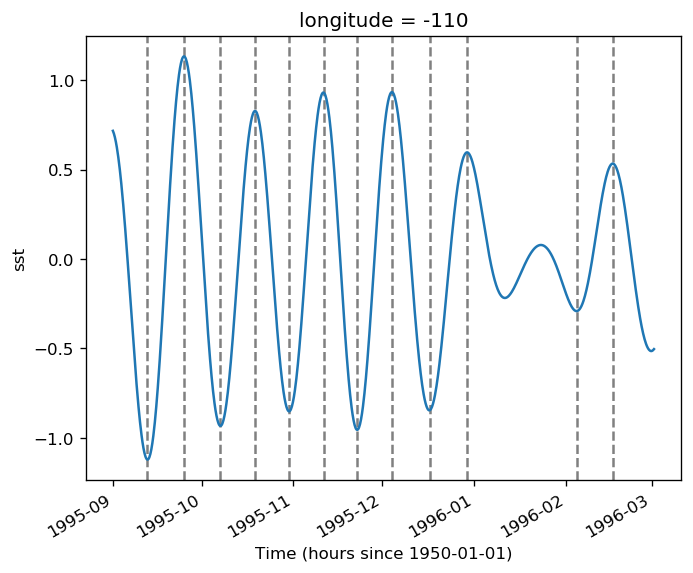

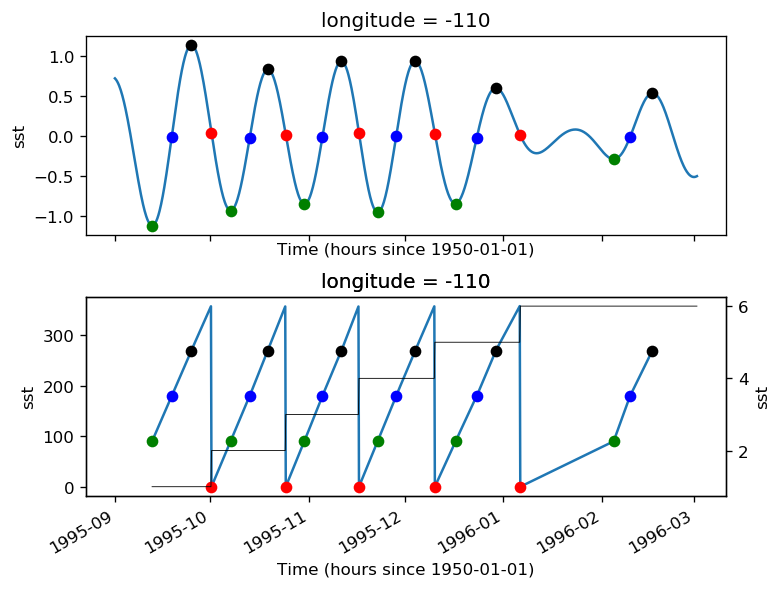

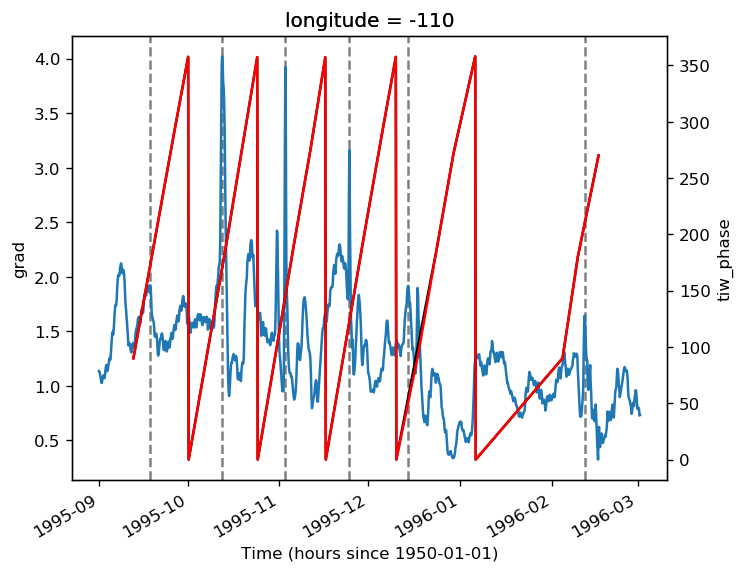

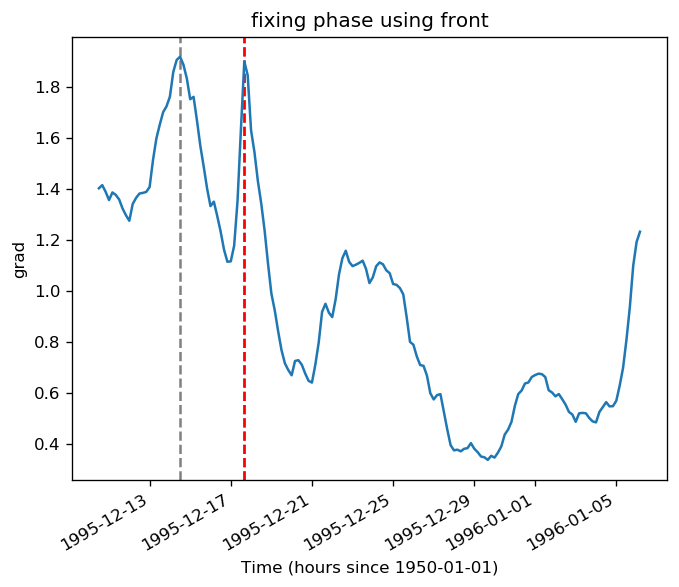

In [39]:
ds = xr.Dataset()
ds["sst"] = sstfilt
ds["grad"] = gradT

a = pump.calc._find_phase_single_lon(
    ds.sel(longitude=[-110], time=slice(None, "1996-03-01")).compute(), 
    debug=True
)

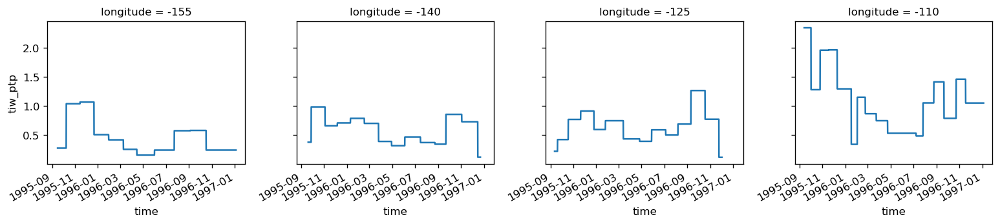

In [121]:
tiw_ptp.sortby("longitude").squeeze().plot(col="longitude")

## SST gradient front detection

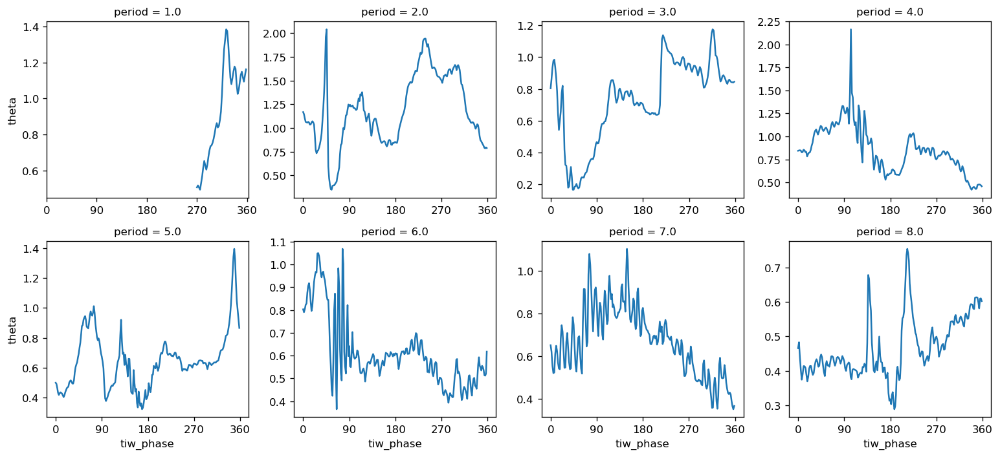

In [22]:
grad = gradT_subset.sel(latitude=slice(0,3)).mean("latitude")

grad.groupby(grad.period).plot(
    col="period", col_wrap=4, x="tiw_phase", xticks=[0,90,180,270,360],
)

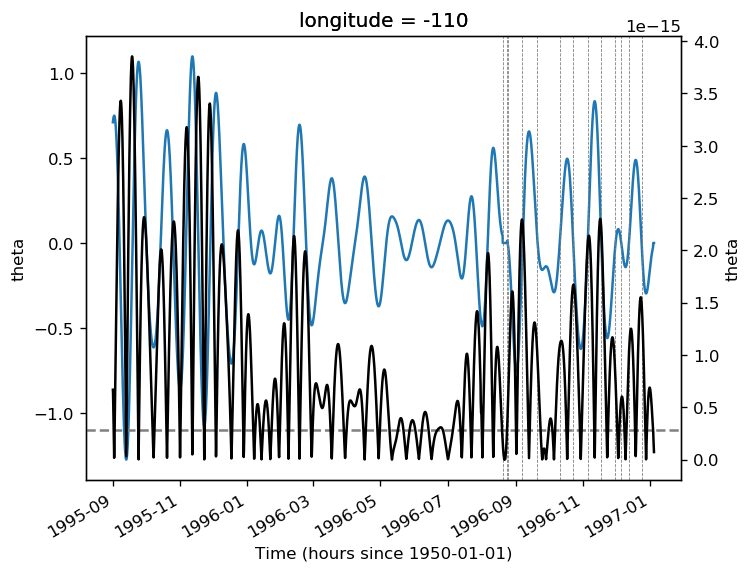

In [135]:
SST = sstfilt.sel(longitude=-110)
dSSTdt = np.abs(SST.differentiate("time"))

thresh = dSSTdt.quantile(q=0.2, dim="time")

for_zeros = SST.where(
    ~((np.abs(SST) < np.abs(SST).quantile(q=0.1, dim="time")) & (dSSTdt < thresh))
).fillna(0)

(for_zeros.plot())
ax2 = plt.gca().twinx()
dSSTdt.plot(ax=ax2, color="k")
dcpy.plots.liney(thresh, ax=ax2)
zeros = pump.calc.crossings_nonzero_all(for_zeros.values)
dcpy.plots.linex(SST.time[zeros[30:]], lw=0.5)

fixing -110
<xarray.DataArray 'tiw_phase' (period: 15)>
array([172.7027027 , 160.        , 145.58823529, 123.42857143,
        55.38461538, 210.        ,  33.75      , 264.375     ,
       162.96529968, 174.54545455, 225.        , 110.25      ,
       146.73913043, 324.47368421,  33.42857143])
Coordinates:
    time       (period) datetime64[ns] 1995-09-18T08:00:00 ... 1996-11-19T12:00:00
    longitude  int64 -110
  * period     (period) float64 1.0 2.0 3.0 4.0 5.0 ... 11.0 12.0 13.0 14.0 15.0


/glade/u/home/dcherian/pump/pump/calc.py:586: UserWarning: Found periods where SST front is before phase=90: [ 5.  7. 15.]
  


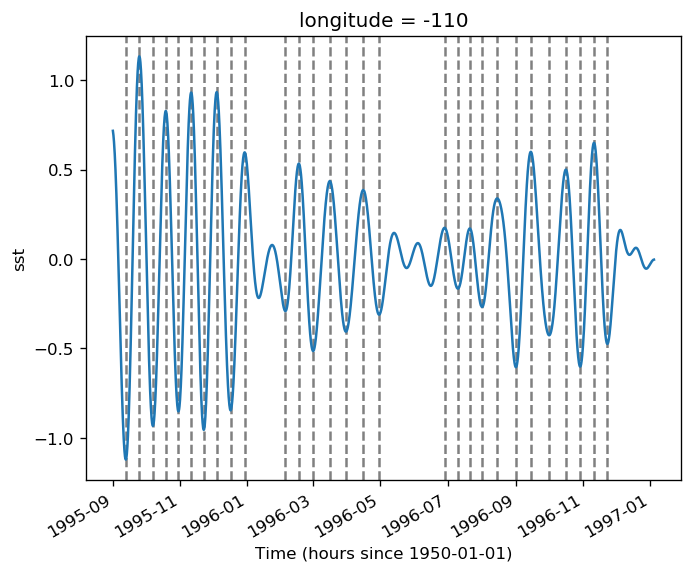

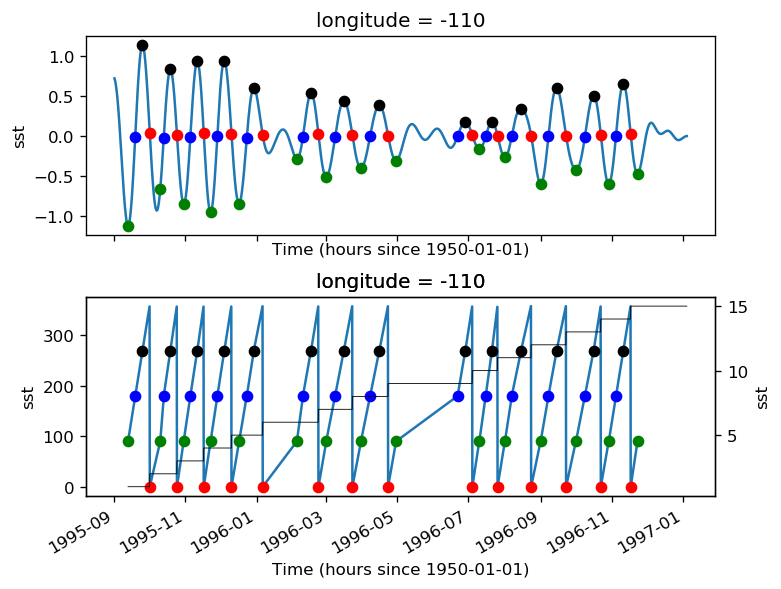

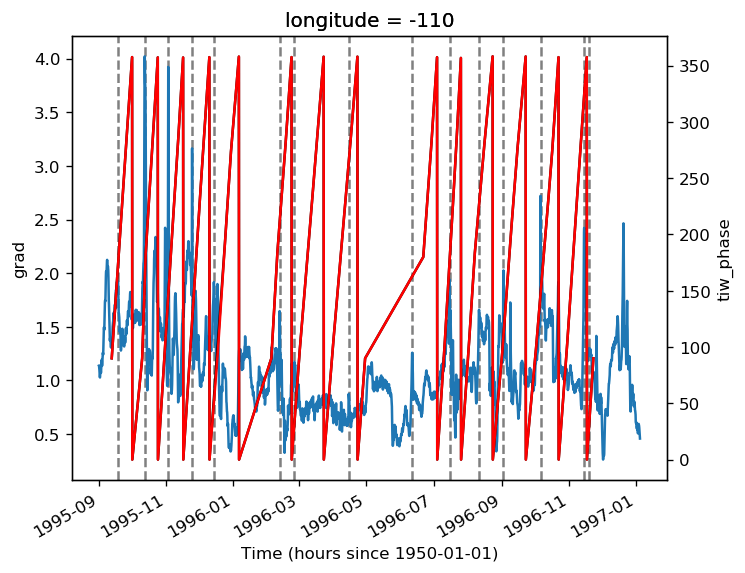

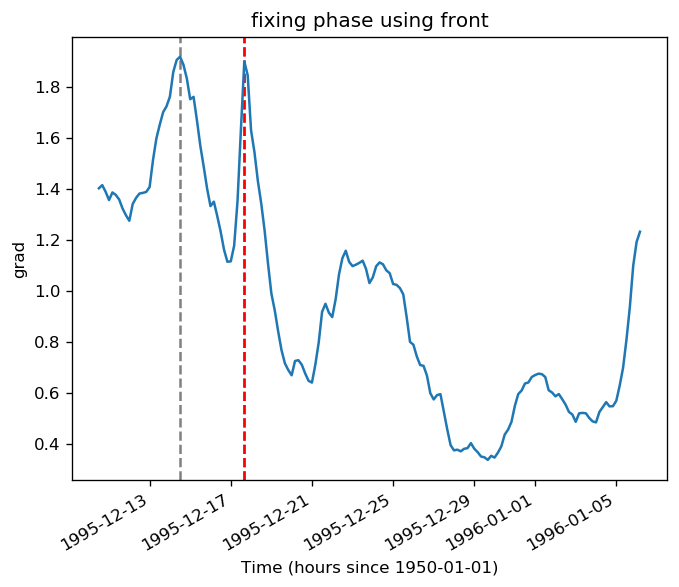

In [63]:
%matplotlib inline

ds = xr.Dataset()
ds["sst"] = sstfilt
ds["grad"] = gradT

a = pump.calc._find_phase_single_lon(ds.sel(longitude=[-110]).compute(), debug=True)

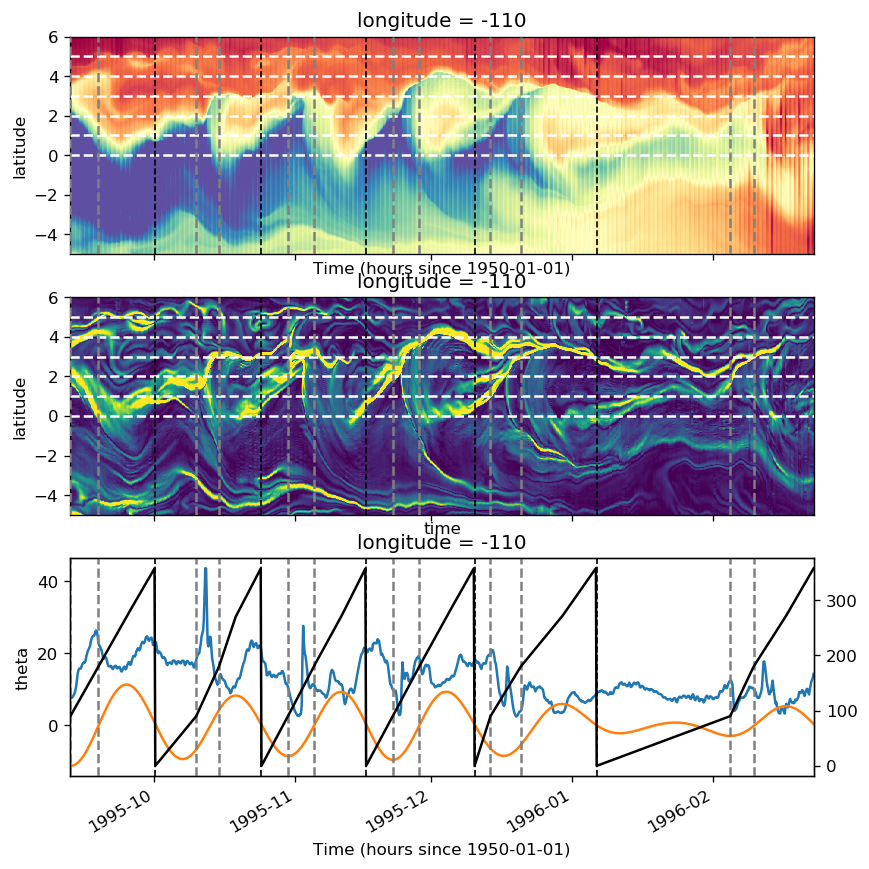

In [72]:
pump.plot.plot_debug_sst_front(model, -110, np.arange(1,7))

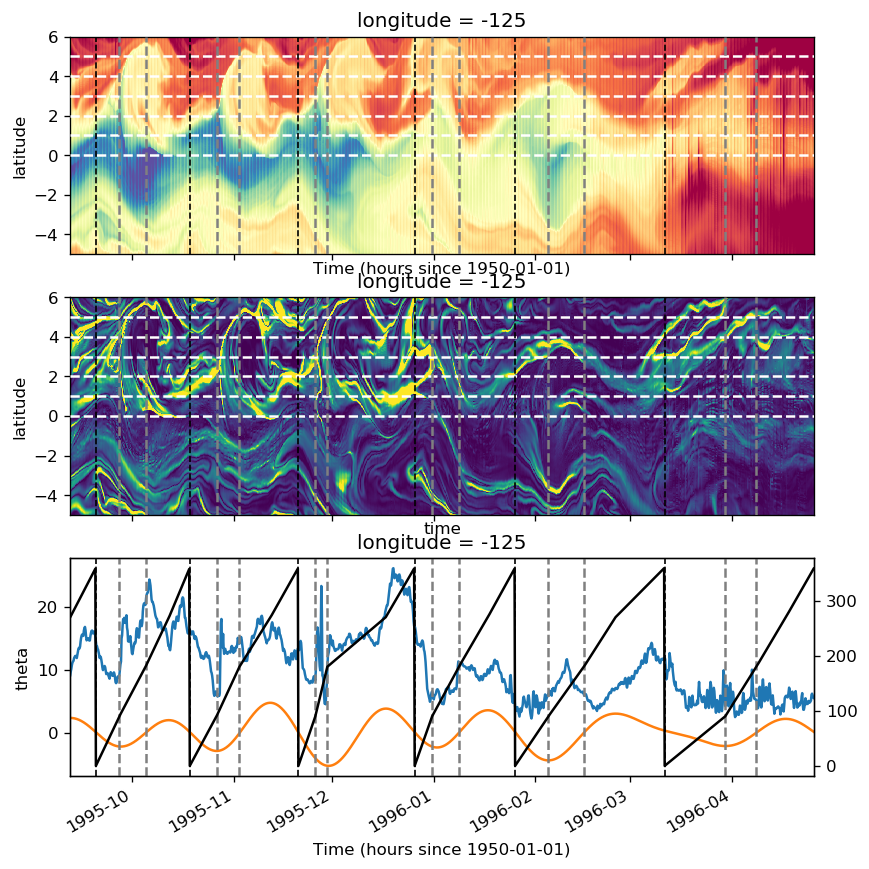

In [55]:
pump.plot.plot_debug_sst_front(model, -125, np.arange(1,8))

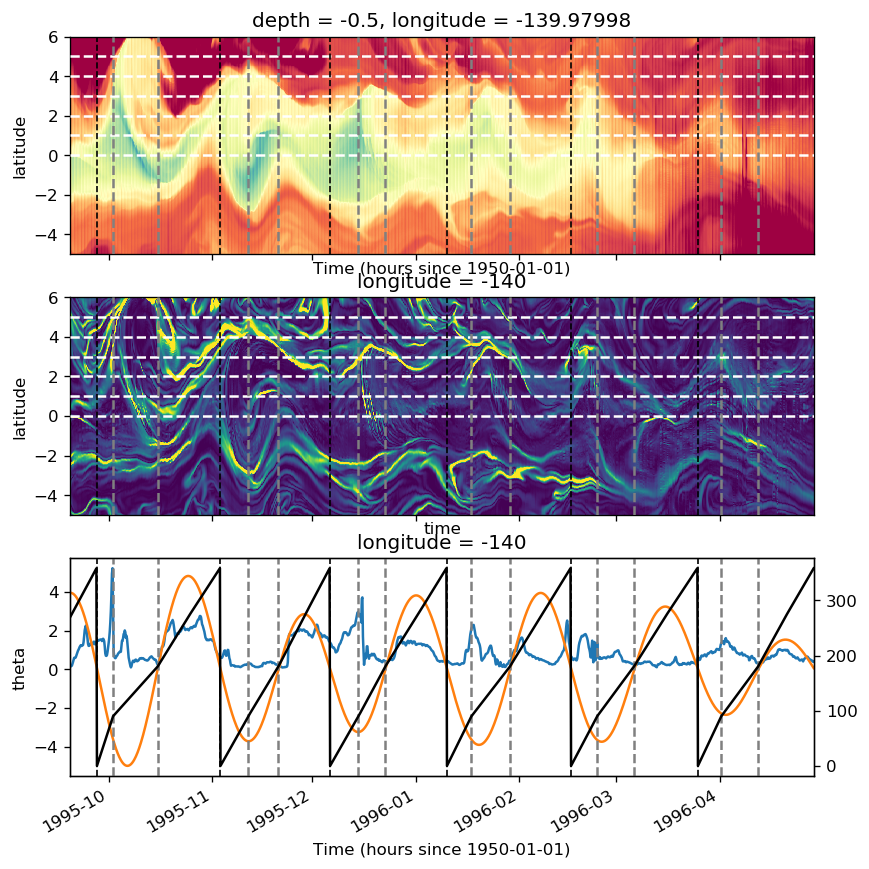

In [230]:
plot_debug_sst_front(-140, np.arange(1,8))

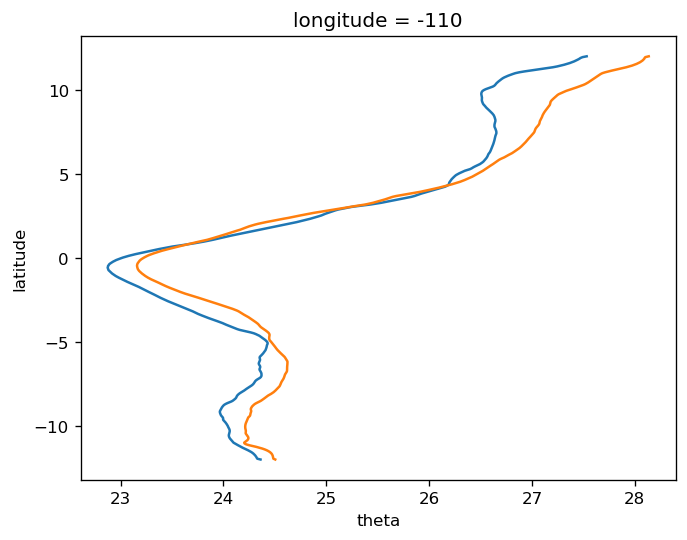

In [207]:
sst.sel(longitude=-110, time=year1).mean("time").plot(y="latitude")
sst.sel(longitude=-110, time=year2).mean("time").plot(y="latitude")

([<matplotlib.lines.Line2D at 0x2b4971bc2ad0>],
 <matplotlib.axes._subplots.AxesSubplot at 0x2b496de55c10>)

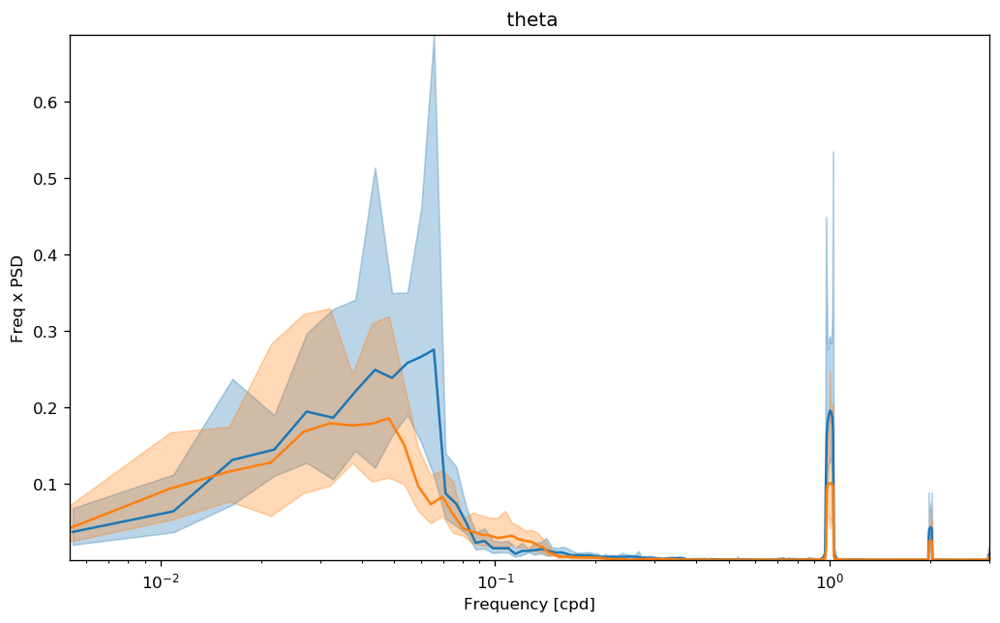

In [205]:
SST = sst.sel(longitude=-110, latitude=slice(-1, 4)).mean("latitude")

year1 = slice(None, "1996-03-01")
year2 = slice("1996-07-01", None)
yr1 = SST.sel(time=year1).compute()
yr2 = SST.sel(time=year2).compute()

dcpy.ts.PlotSpectrum(yr1, preserve_area=True)
dcpy.ts.PlotSpectrum(yr2, ax=plt.gca(), preserve_area=True)

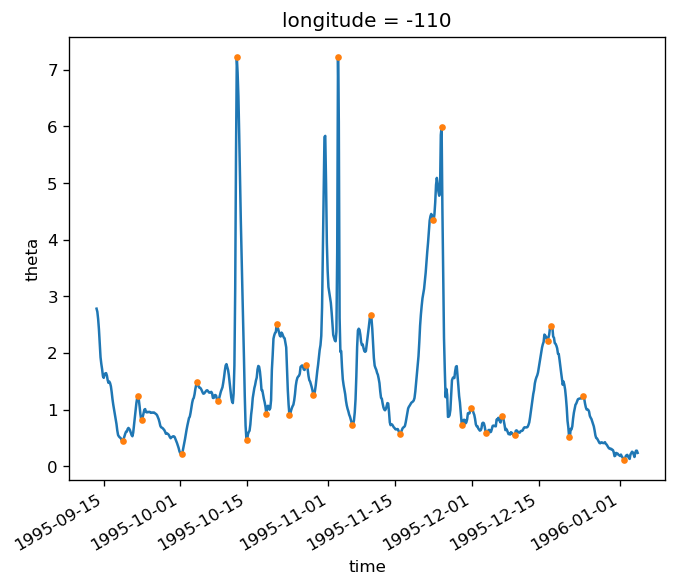

In [169]:
import scipy as sp

grad = gradT_subset.sel(latitude=slice(2, 3)).mean("latitude")

maxs = sp.signal.find_peaks(grad, prominence=0.3, distance=24)[0]
mins = sp.signal.find_peaks(-grad, prominence=0.1, distance=24)[0]

grad.plot()
grad[np.concatenate([maxs, mins])].plot(marker='.', linestyle='none')

### skimage feature detection experiments

Not really getting anywhere. The `medial_axis` stuff was most promising but still too complex.

In [140]:
def skapply(data, func, *args, **kwargs):
    return data.copy(data=func(data.values, *args, **kwargs))
    
gradT = skapply(sst.sel(longitude=-110).isel(time=slice(None,None,6)), skimage.filters.scharr)

#### medial_axis

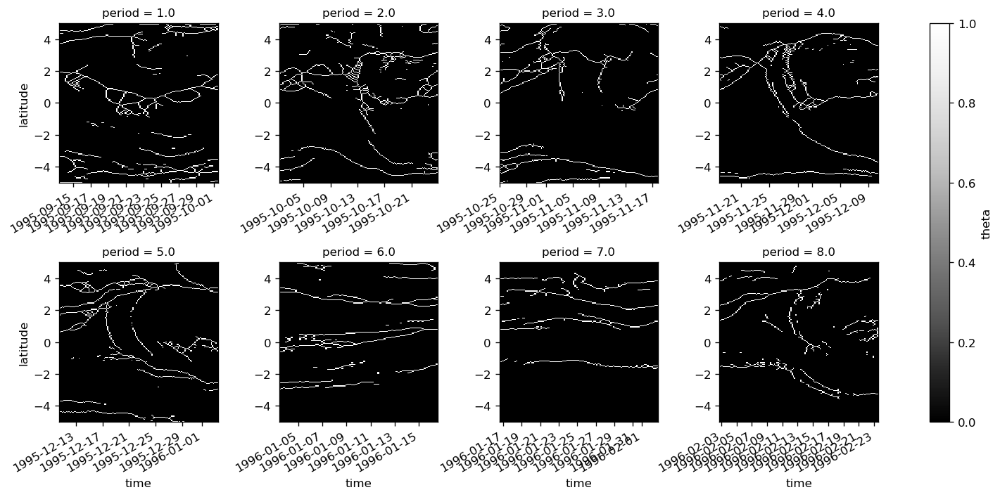

In [175]:
(
    skapply(
        gradT_subset
        .where(gradT_subset > gradT_subset.quantile(q=0.9, dim=...), 0)
        .sel(latitude=slice(-5,5))
        .clip(max=1),
        skimage.morphology.medial_axis
    ).groupby("period").plot(col="period", col_wrap=4, robust=True, vmin=0, x="time", cmap=mpl.cm.Greys_r)
)

#### skeleton

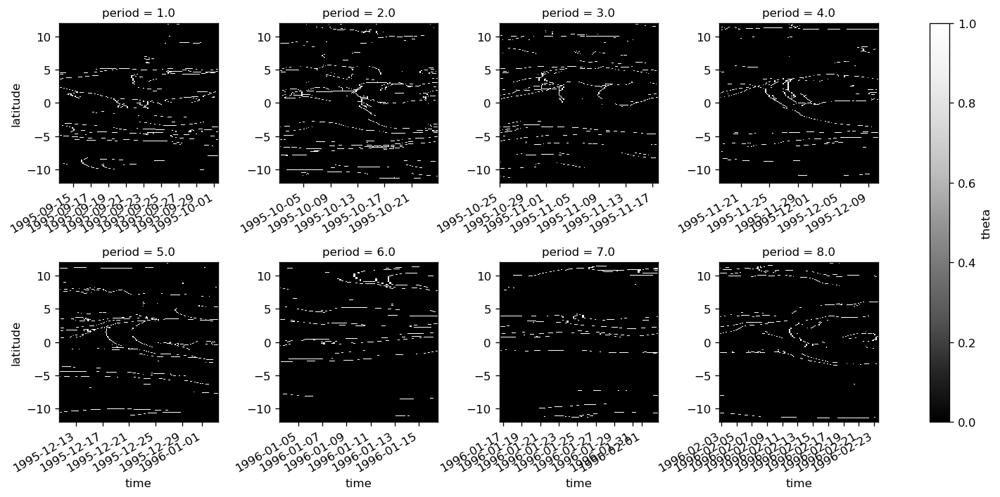

In [180]:
import skimage

mask = gradT_subset > gradT_subset.quantile(q=0.9, dim=...)

eq = gradT_subset.copy(data=skimage.exposure.equalize_hist(gradT_subset.values))

filt = gradT_subset.copy(data=skimage.filters.sato(eq, black_ridges=False))

skel = eq.copy(data=skimage.morphology.skeletonize(mask.values))

skel.groupby("period").plot(col="period", col_wrap=4, x="time", cmap=mpl.cm.Greys_r, robust=True)

In [76]:
from skimage import feature
large = gradT_subset.where(gradT_subset > gradT_subset.quantile(q=0.5, dim=...), 0)

fronts = gradT_subset.copy(data=feature.canny(large.values, sigma=1))

In [69]:
# gradT_subset.plot(x="time")
plt.imshow(fronts.values, cmap=mpl.cm.Greys_r)

## Am I filtering in the right band?

On Jan 27, I switched to different bands for -110 and the rest

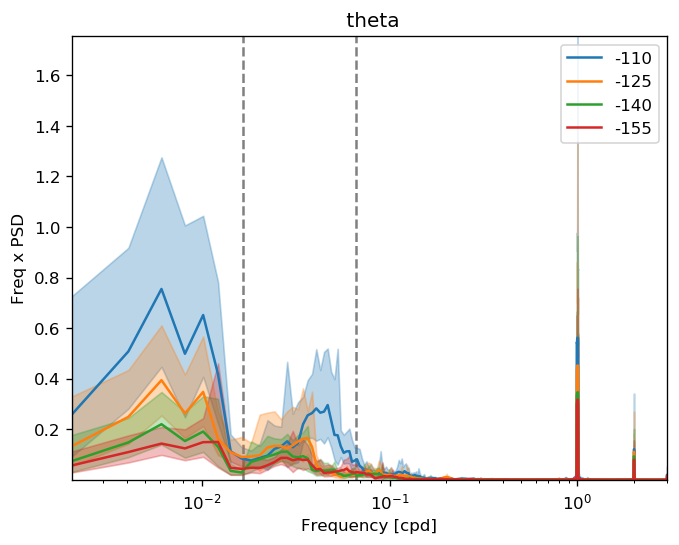

In [30]:
for lon in sst.longitude.values:
    dcpy.ts.PlotSpectrum(model.surface.theta.sel(longitude=lon, method="nearest").
                         sel(latitude=slice(-1, 3)).mean("latitude"), 
                         ax=plt.gca(), label=str(lon), preserve_area=True)
    
dcpy.plots.linex([1/60, 1/15])
plt.legend()

## lowpass vs bandpass SST for phase calculation

### Am I filtering in the right band?

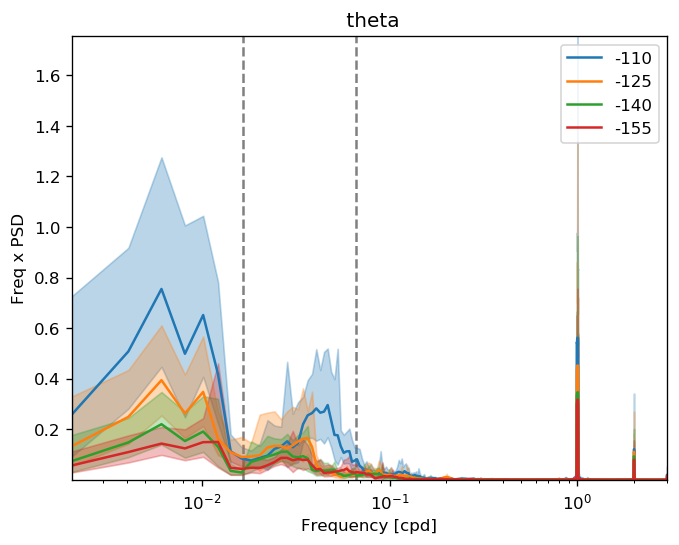

In [30]:
for lon in sst.longitude.values:
    dcpy.ts.PlotSpectrum(model.surface.theta.sel(longitude=lon, method="nearest").
                         sel(latitude=slice(-1, 3)).mean("latitude"), 
                         ax=plt.gca(), label=str(lon), preserve_area=True)
    
dcpy.plots.linex([1/60, 1/15])
plt.legend()

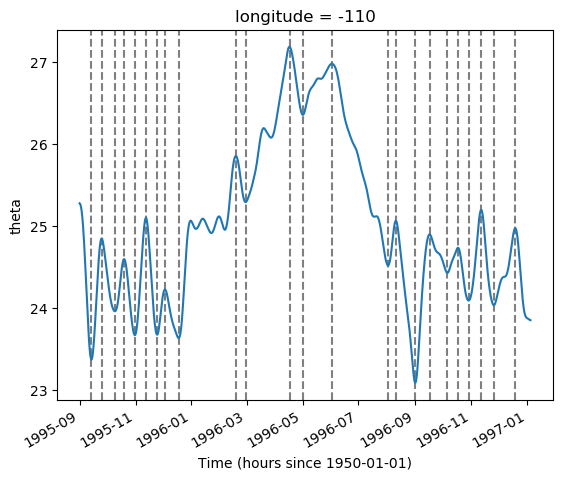

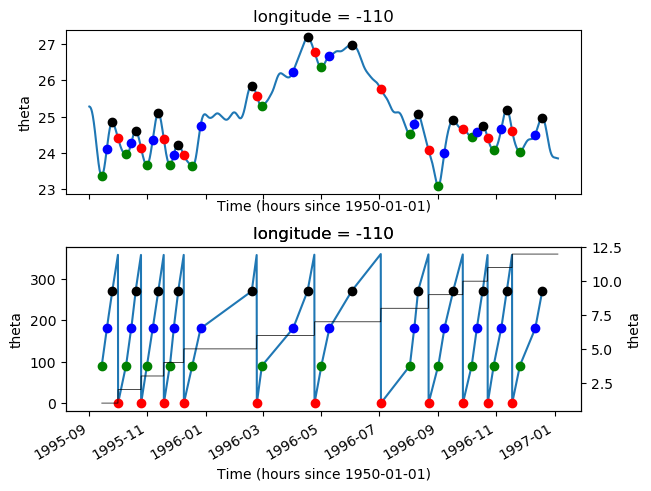

In [149]:
sstfilt = xfilter.lowpass(
    sst.sel(longitude=[-110], latitude=slice(-1, 5)).mean("latitude"),
    coord="time",
    freq=1/15,
    cycles_per="D",
    num_discard=0,
    method="pad"
).load()
# sstfilt.plot()
tiw_phase_l, period_l = pump.calc.get_tiw_phase_sst(sstfilt, 
                                                filt=False, 
                                                debug=True)

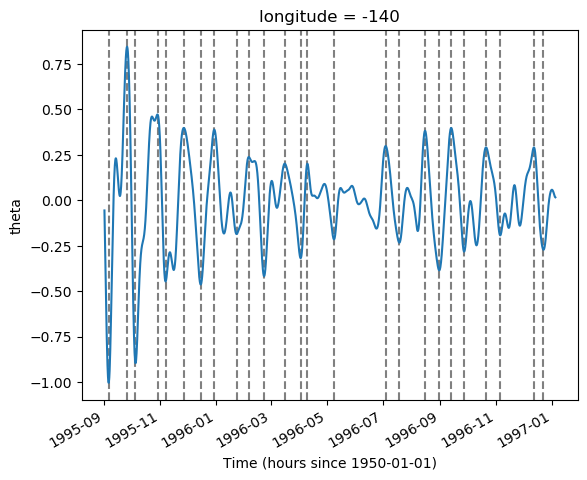

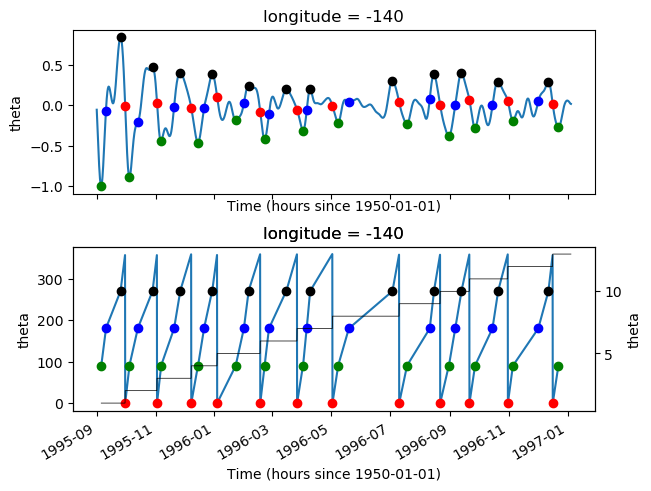

In [172]:
sstfilt = xfilter.bandpass(
    sst.sel(longitude=[-140], latitude=slice(-1, 5)).mean("latitude"),
    coord="time",
    freq=[1/40, 1/10],
    cycles_per="D",
    num_discard=0,
    method="pad"
).load()
# sstfilt.plot()
tiw_phase_b, period_b = pump.calc.get_tiw_phase_sst(sstfilt, 
                                                filt=False, 
                                                debug=True)

## actually test

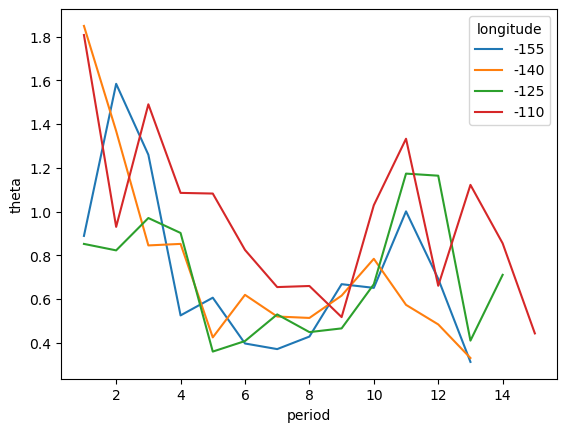

In [180]:
import xfilter

theta = surf.theta.sel(longitude=longitudes).chunk({"longitude": 1})
periods = np.arange(1,9)

# subset = theta.where(theta.period.isin(periods),drop=True)
sst = theta
sstfilt = xfilter.bandpass(
    sst.sel(latitude=slice(-1, 5)).mean("latitude"),
    coord="time",
    freq=[1/40, 1/10],
    cycles_per="D",
    num_discard=0,
    method="pad"
)

tiw_phase, period = dask.compute(
    pump.calc.get_tiw_phase_sst(sstfilt, 
                                filt=False, 
                                debug=False)
)[0]

def calc_ptp(obj, dim="time"):
    obj = obj.unstack()
    obj -= obj.mean()
    return (obj.max(dim) - obj.min(dim))
     
    
tiw_ptp = sstfilt.groupby(period).map(calc_ptp).load()

plt.figure()
tiw_ptp.plot.line(x="period")

tiw_ptp = (
    tiw_ptp.sel(period=period.dropna("time"), 
                longitude=period.longitude)
           .reindex(time=period.time)
    .drop("period")
)

sst_sub = (    
    sst.pipe(xfilter.lowpass, coord="time", freq=1/7, cycles_per="D", num_discard=0, method="pad")
    .assign_coords(period=period, tiw_phase=tiw_phase, tiw_ptp=tiw_ptp)
    .where(period.isin(periods), drop=True)
    .squeeze()
).load()

## testing peak-to-peak filtering of TIW periods

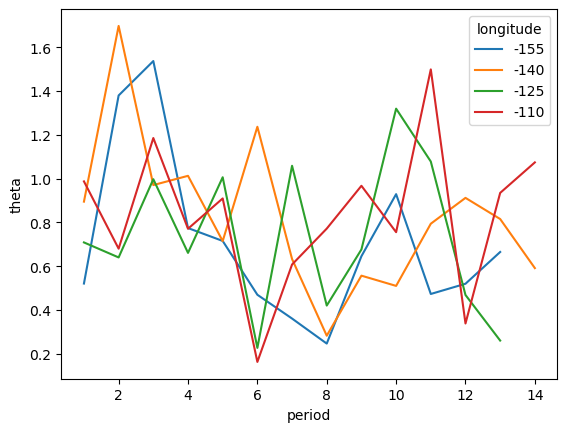

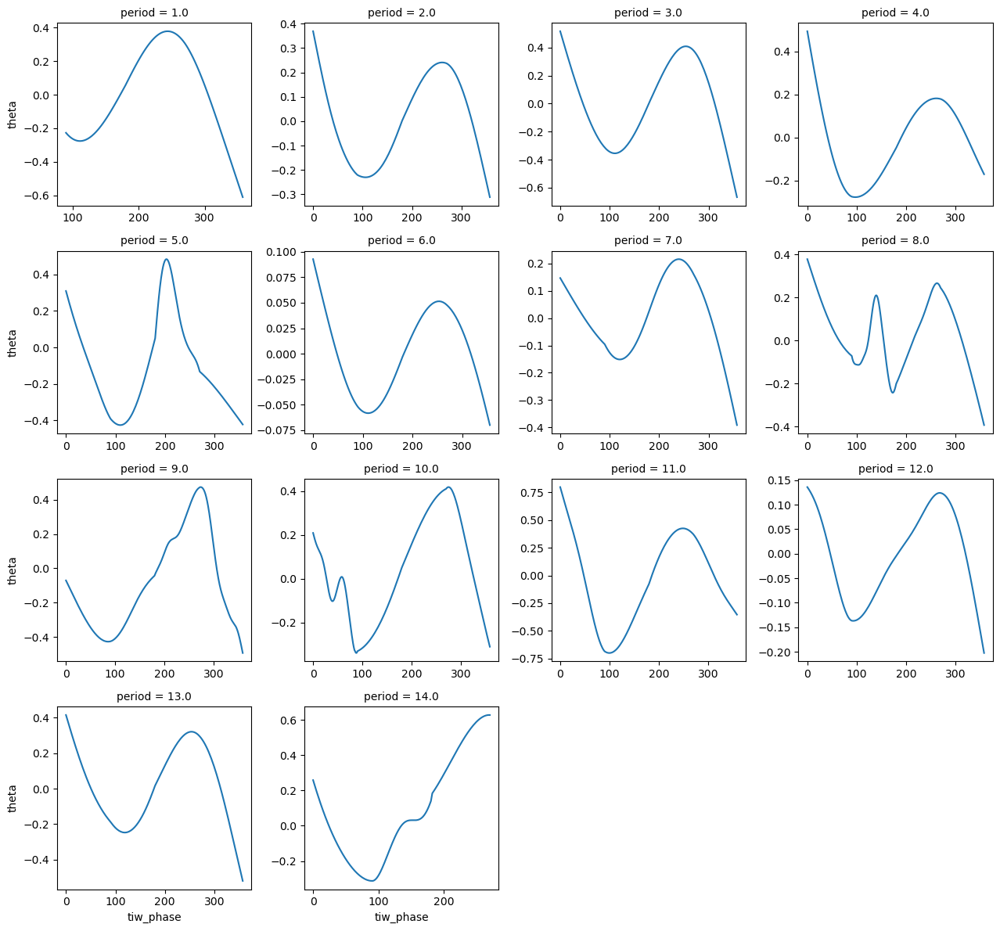

In [128]:
def detrend_period(obj):
    obj = obj.unstack()
    obj = pump.composite.detrend(obj.dropna("time", how="all"), "time")
    return obj
    

def calc_ptp(obj, dim="time"):
    
    obj = obj.unstack()
    obj = detrend(obj.dropna(dim, how="all"), dim)
    return (obj.max(dim) - obj.min(dim))

    
tiw_ptp = sstfilt.groupby(period).map(calc_ptp).load()

plt.figure()
tiw_ptp.plot.line(x="period")
     
    
(sstfilt
 .assign_coords(tiw_phase=tiw_phase, period=period)
 .sel(longitude=-110)
 .groupby("period").apply(detrend_period)
 .groupby("period").plot(col="period", x="tiw_phase", col_wrap=4))

## debugging y reference

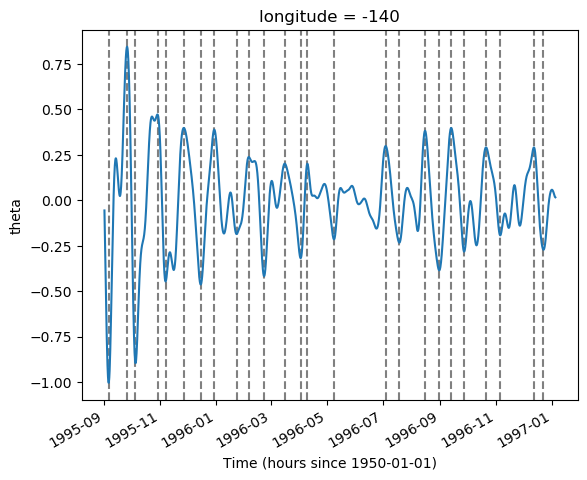

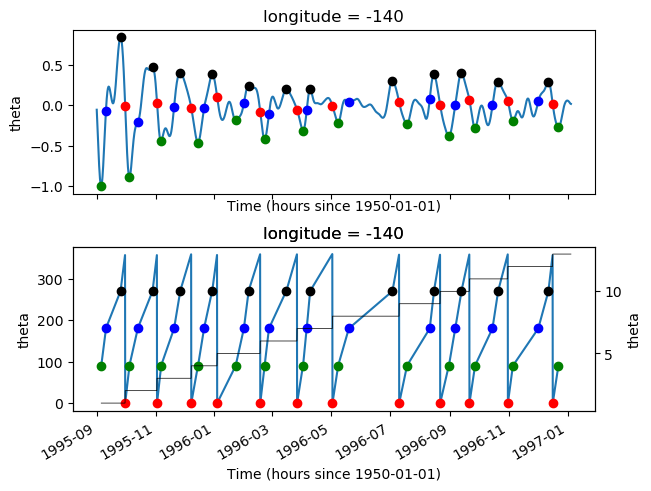

In [177]:
tiw_phase, period = pump.calc.get_tiw_phase_sst(sstfilt.sel(longitude=[-140]).load(), 
                                                filt=False, 
                                                debug=True)

/gpfs/u/home/dcherian/python/xarray/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/gpfs/u/home/dcherian/python/xarray/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/gpfs/u/home/dcherian/python/xarray/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


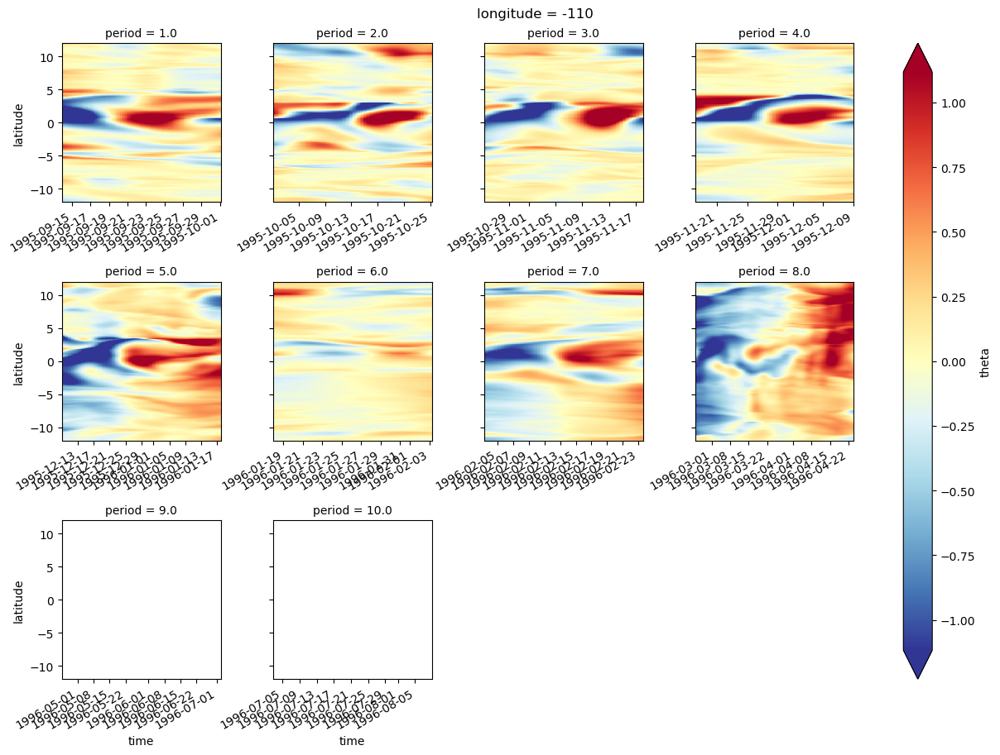

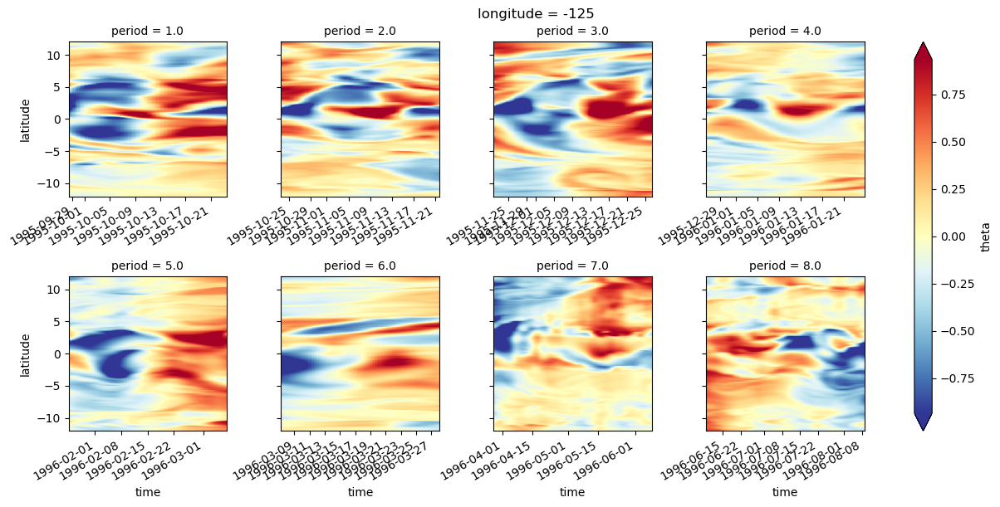

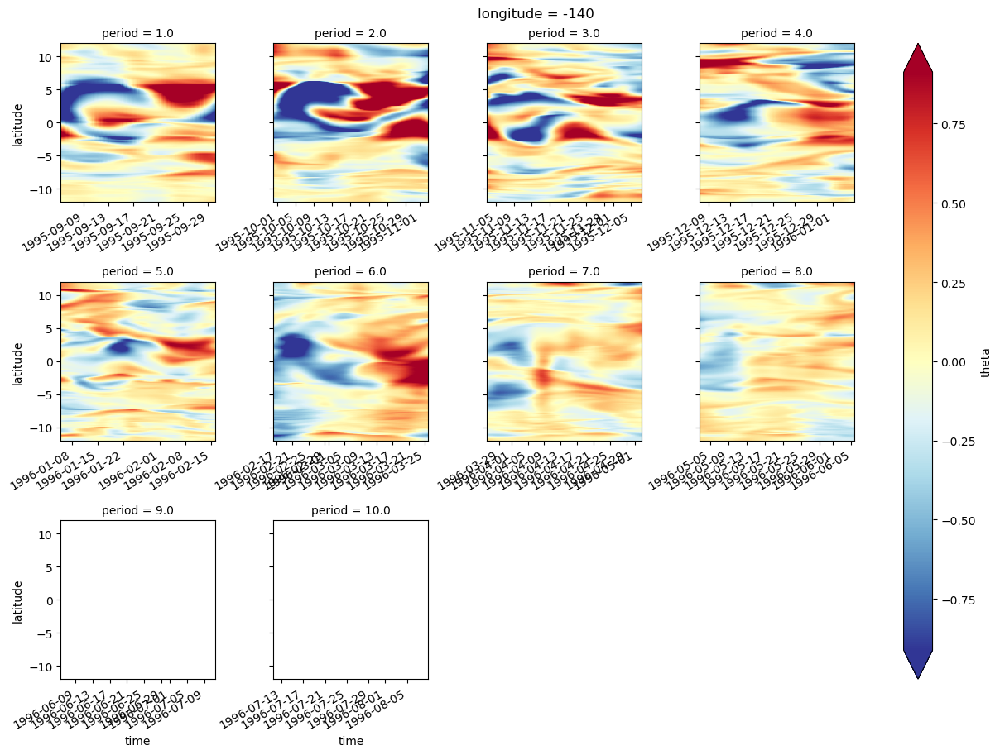

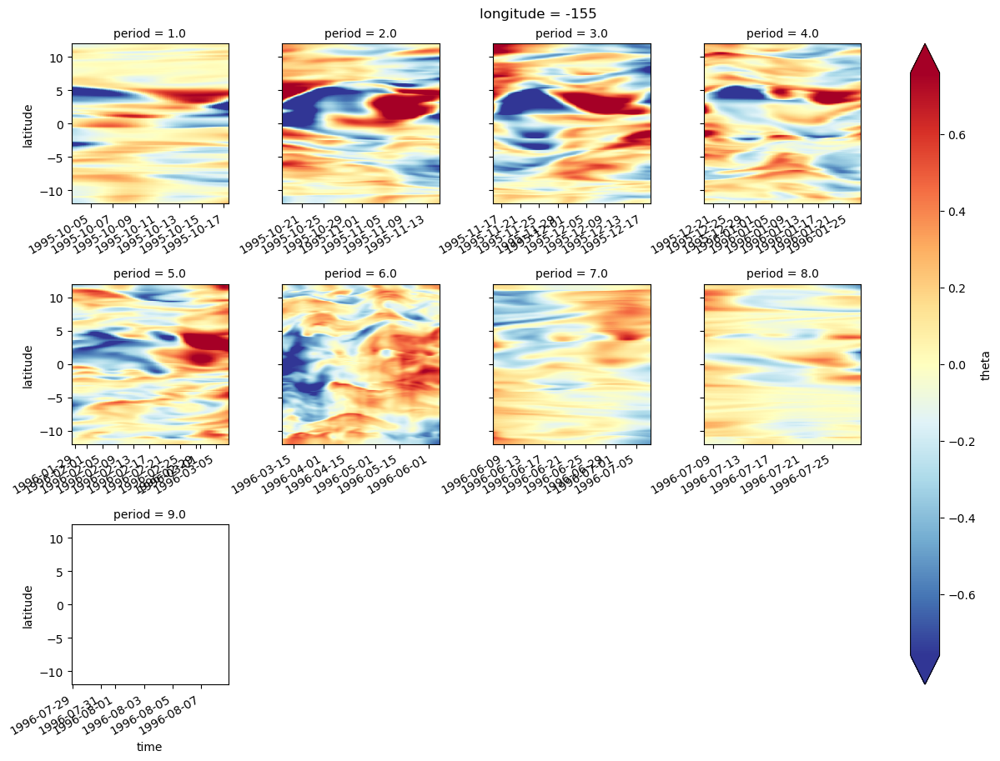

In [33]:
# anom = (sst_sub.groupby("period") - sst_sub.groupby("period").apply(lambda x: x.unstack().mean("time"))) #.expand_dims("longitude")
def plot_median(da, x, y, ax, **kwargs):
    med = da.quantile(q=0.5,dim=...).values
    da.plot.contour(ax=ax, levels=[med])

for lon in sst_sub.longitude:
    anom = sst_sub.sel(longitude=lon)
    anom = anom.groupby('period') - anom.groupby("period").mean("time")
    fg = anom.groupby("period").plot(
        col="period", col_wrap=4, x="time", robust=True, sharey=True, cmap=mpl.cm.RdYlBu_r,
    )
    # fg.map_dataarray(plot_median, x="time", y="latitude", add_colorbar=False)
    fg.fig.suptitle(f"longitude = {lon.values}", y=1.01)

/gpfs/u/home/dcherian/python/xarray/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/gpfs/u/home/dcherian/python/xarray/xarray/core/nanops.py:140: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


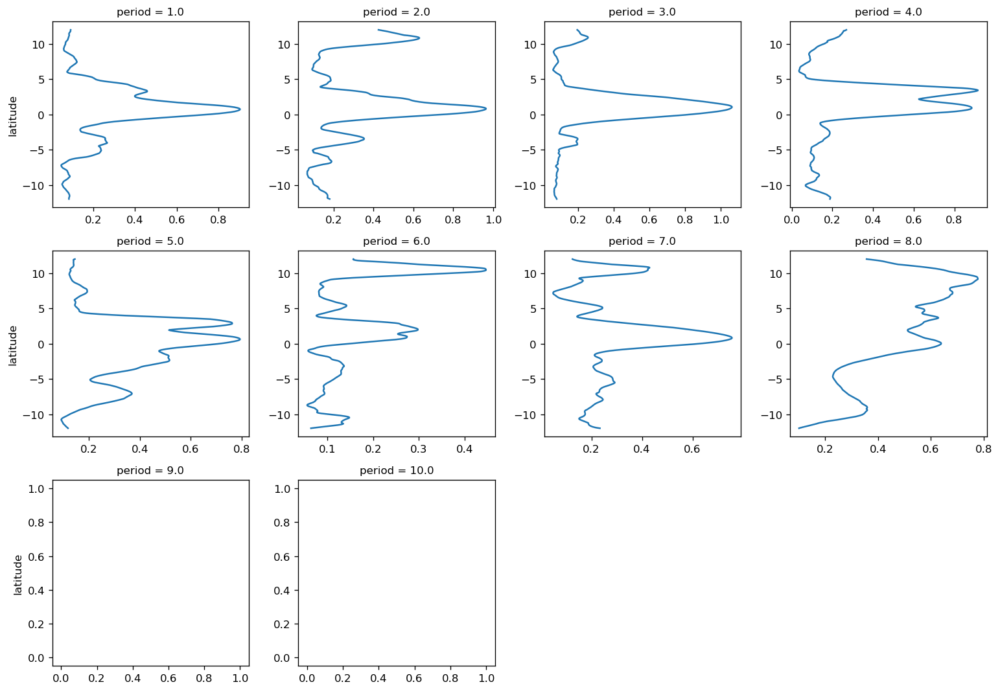

In [68]:
sub = sst_sub.sel(longitude=-110)
anom = sub.groupby("period") - sub.groupby("period").mean()
pos = anom.where(anom > 0).groupby("period").mean("time")
neg = anom.where(anom < 0).groupby("period").mean("time")

(pos.rolling(latitude=31, min_periods=1, center=True).mean()
 .groupby("period")
 .plot.line(col="period", col_wrap=4, y="latitude"))

[129 260]
[ 86 126 252]
[ 39  93 127 245]
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
[ 30 257]
[140 238]
[ 87 164]
[ 93 216]
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
[146 246]


/gpfs/u/home/dcherian/python/xarray/xarray/plot/plot.py:88: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  yplt = darray.transpose(xdim, huedim)


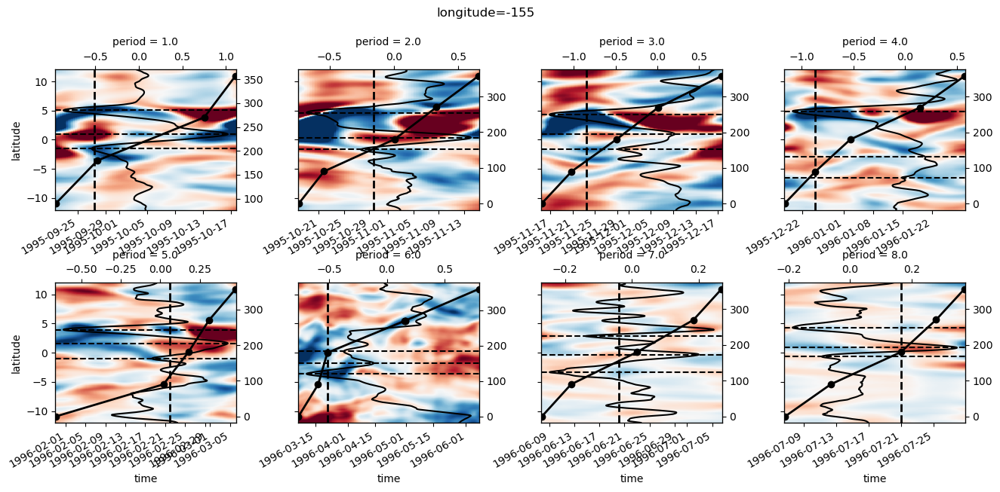

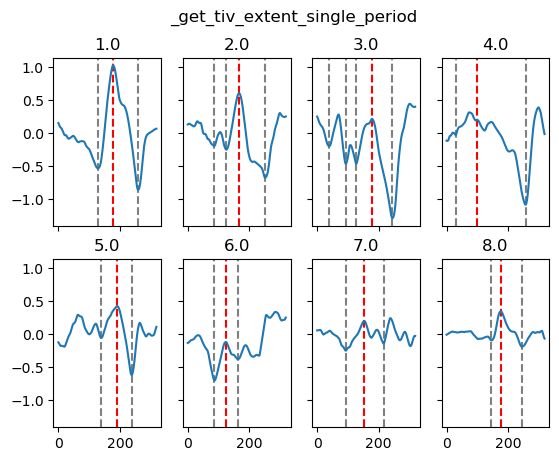

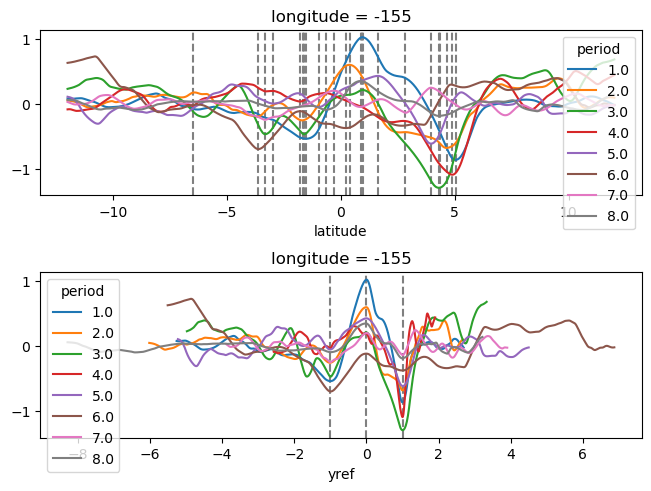

In [187]:
yref, reference = pump.composite.get_y_reference(
    sst_sub.sel(longitude=[-155]), 
    periods=periods, 
    kind="warm",
    debug=True,
    # savefig=True,
)

## save y reference debugging plots.

With some manual tweaking this looks OK.

In [75]:
import xfilter

sst_sub = (    
    sst.pipe(xfilter.lowpass, coord="time", freq=1/7, cycles_per="D", num_discard=0, method="pad")
    .assign_coords(period=period, tiw_phase=tiw_phase, tiw_ptp=tiw_ptp)
    .squeeze()
).load()

### Commit: 1365139 Date: 30 Jan 2020

[ 47  89 128 252]
[ 43  89 213]
[ 30  90 205 270]
[ 42 119 236]
[ 70 127 230]


/glade/u/home/dcherian/python/xarray/xarray/plot/plot.py:86: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  yplt = darray.transpose(xdim, huedim)


[ 35 117 267]
[ 59 126 254]
[ 35 127 254]


/glade/u/home/dcherian/python/xarray/xarray/plot/plot.py:86: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  yplt = darray.transpose(xdim, huedim)


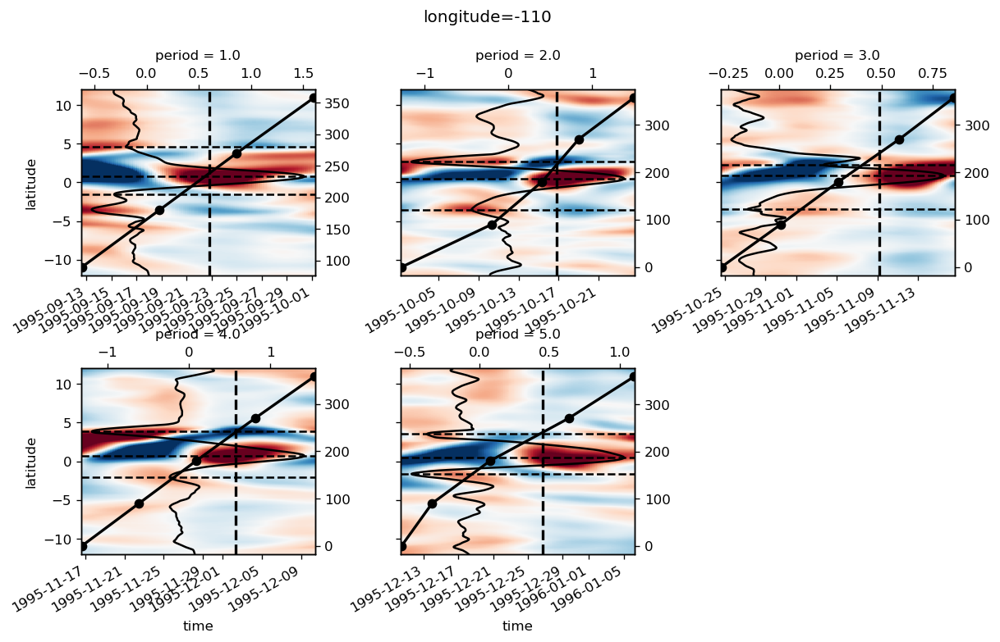

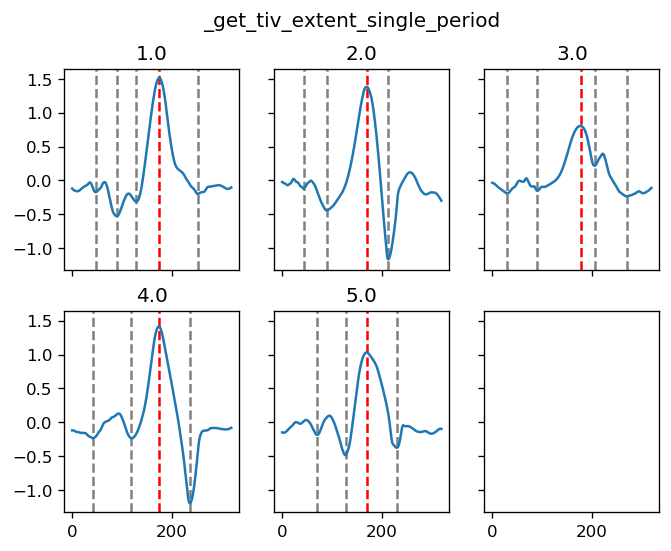

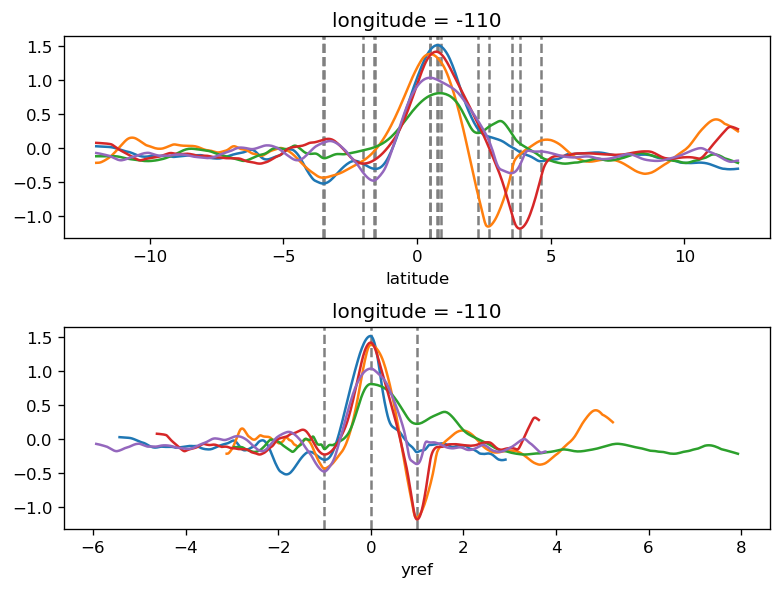

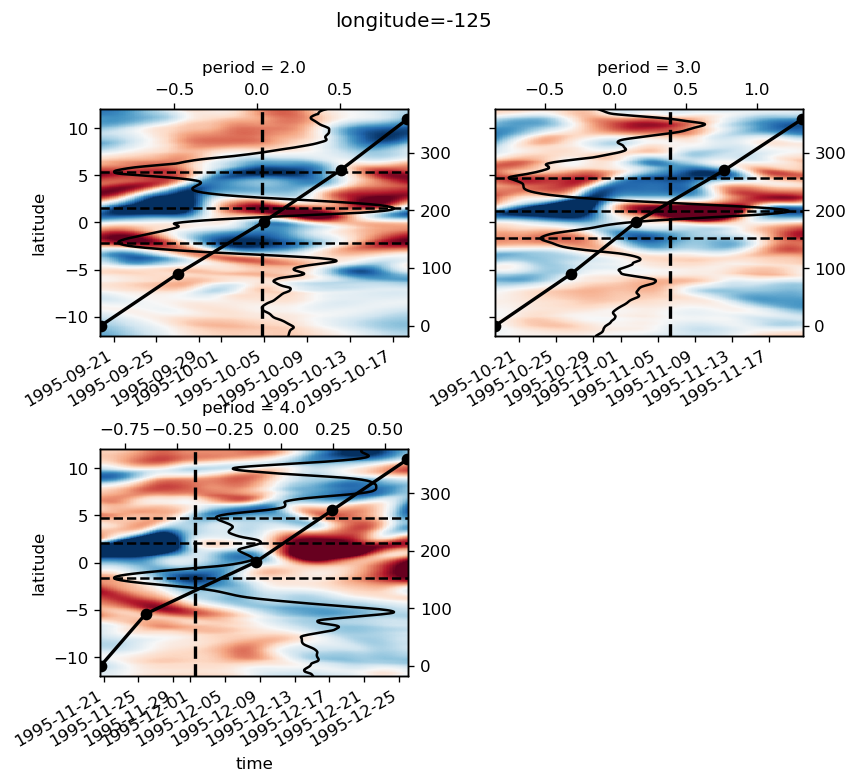

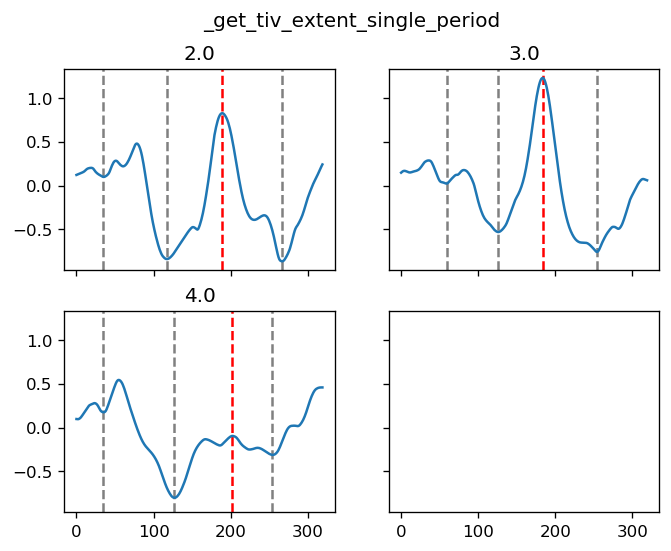

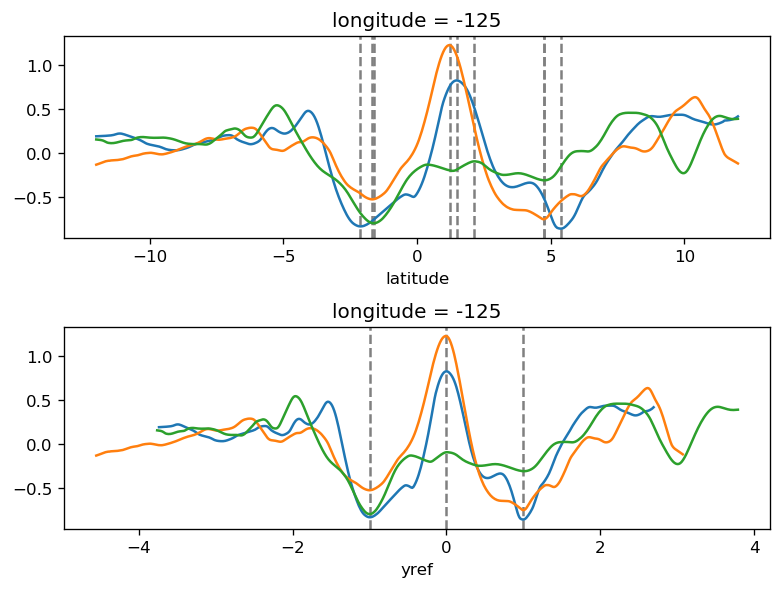

In [83]:
for longitude in sst_sub.longitude:
    yref, reference = pump.composite.get_y_reference(
        sst_sub.sel(longitude=[longitude]), 
        periods=None,
        kind="warm",
        debug=True,
        savefig=False,
    )

### Commit: 8a3ec4e Date: 27 Jan 2019

[ 93 134 235]
[ 43  89 212]
[142 209]
[125 233]
[ 73 127 222 273]
[121 222 253]
[132 227]
[ 67 130 255]
[ 57 232]
[ 43  96 202 261]
[146 227]


/glade/u/home/dcherian/python/xarray/xarray/plot/plot.py:86: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  yplt = darray.transpose(xdim, huedim)


[ 35 117 267]
[ 59 126 254]
[ 63 252]
[ 78 206]
[102 162 223]
[130 242]
[ 76 167 245]
[116 224]


/glade/u/home/dcherian/python/xarray/xarray/plot/plot.py:86: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  yplt = darray.transpose(xdim, huedim)


[141 267]
[ 14 116 240]
[108 216]
[ 61 125 291]
[ 29  98 147 297]
[ 28 112 182 295]
[110 247]
[124 235]
[145 230]


/glade/u/home/dcherian/python/xarray/xarray/plot/plot.py:86: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  yplt = darray.transpose(xdim, huedim)


[126 263]
[ 88 128 252]
[ 96 295]
[115 231]


/glade/u/home/dcherian/python/xarray/xarray/plot/plot.py:86: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  yplt = darray.transpose(xdim, huedim)


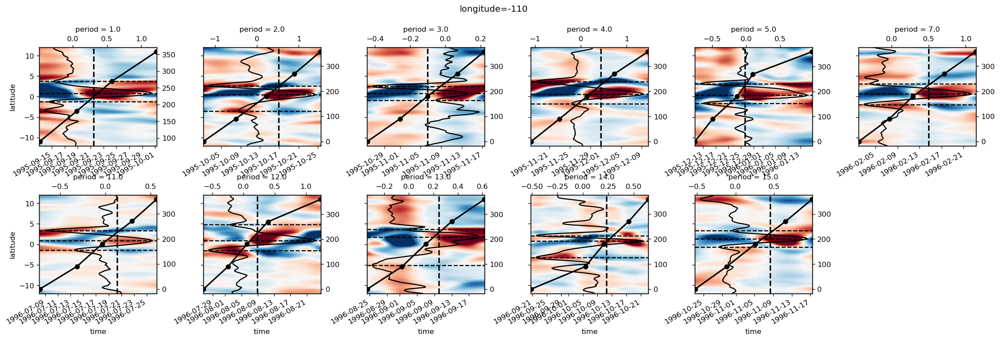

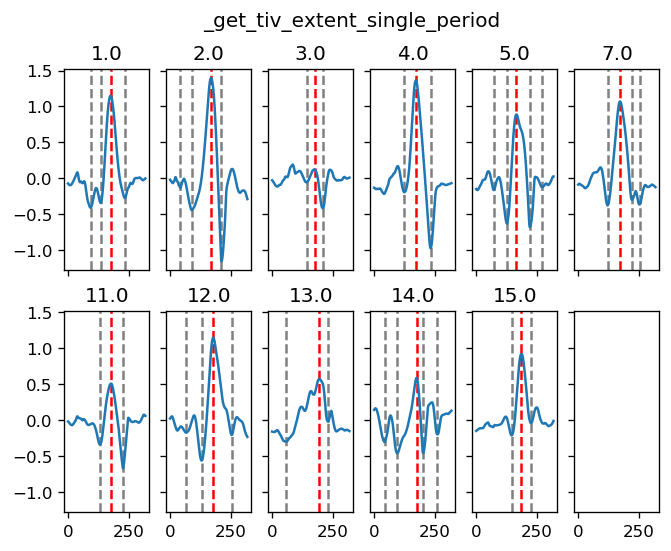

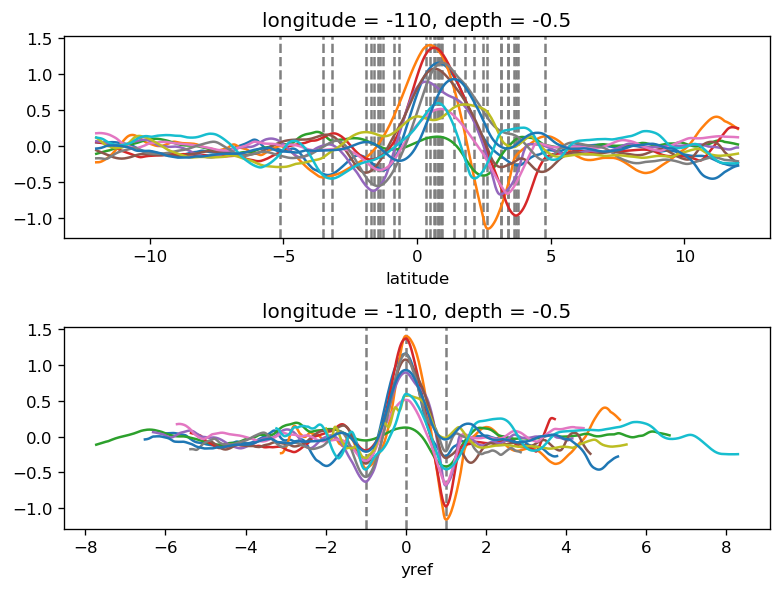

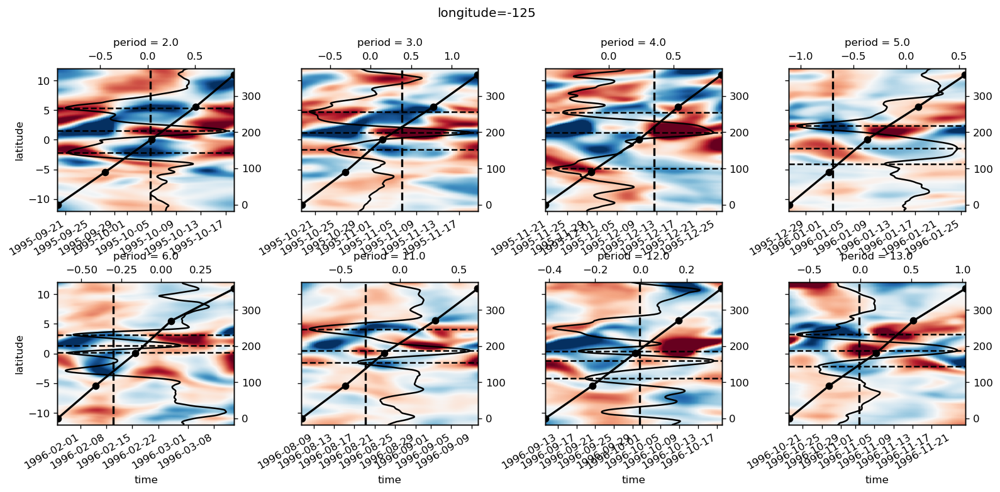

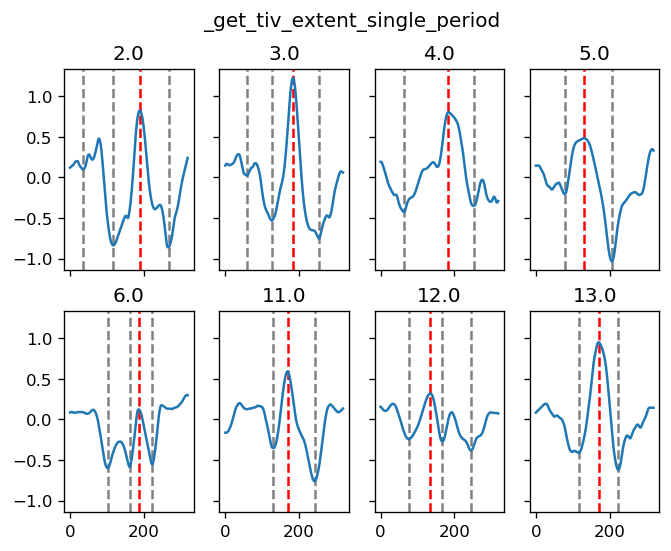

...

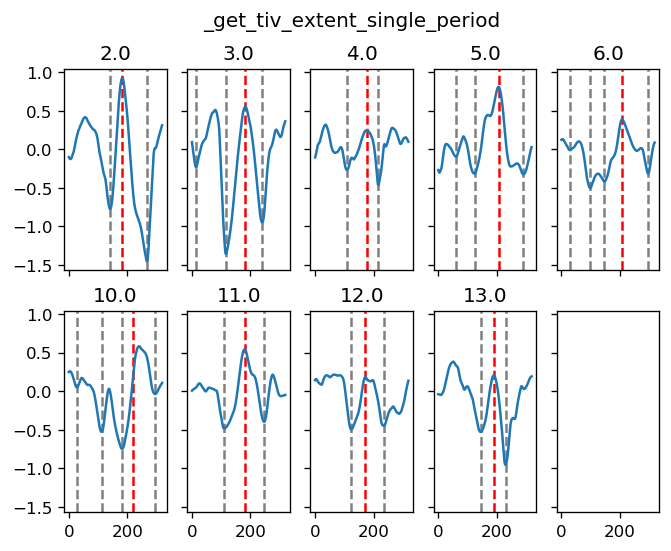

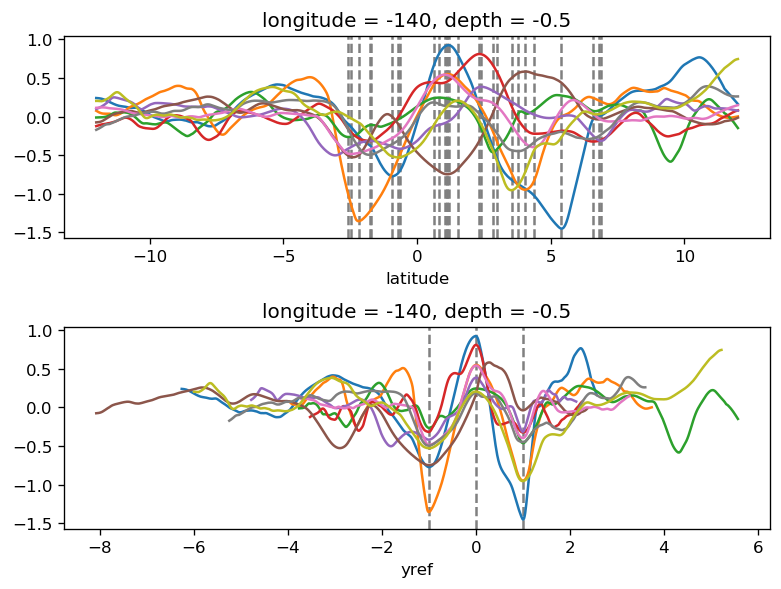

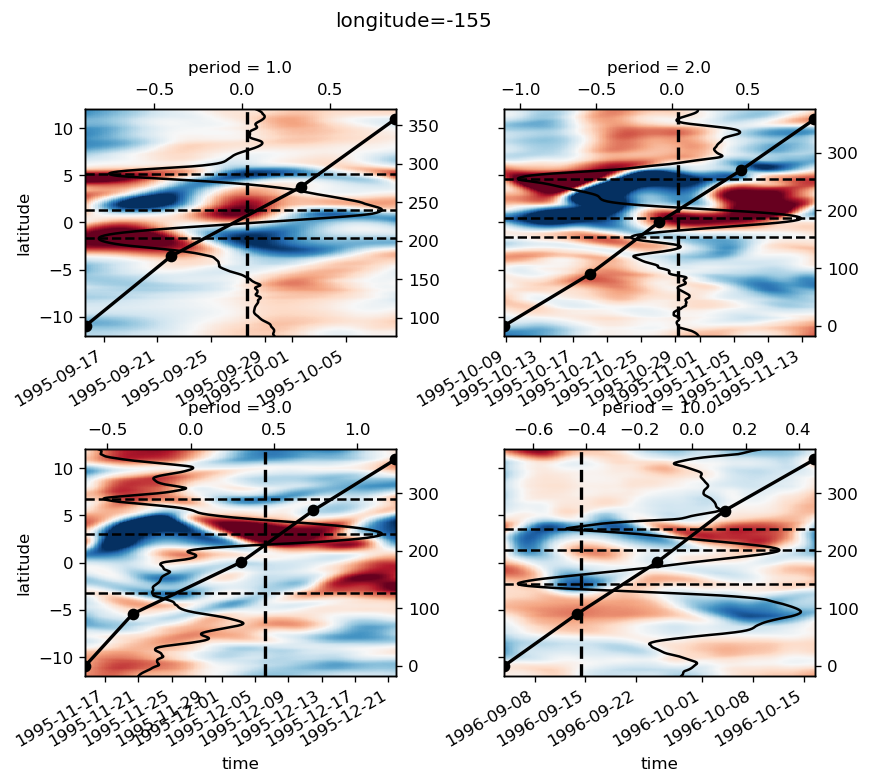

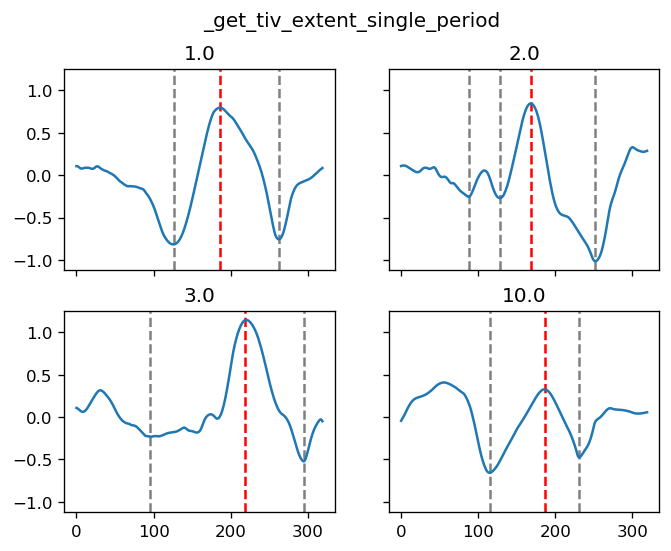

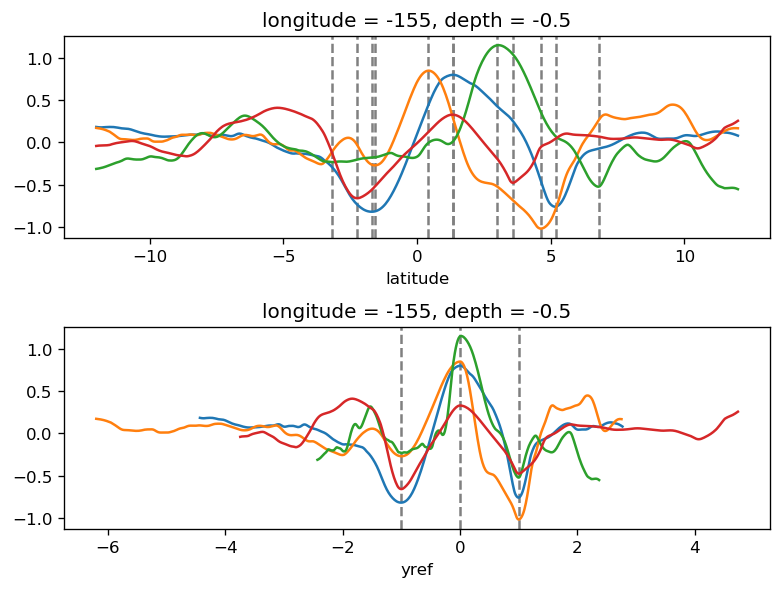

In [43]:
for longitude in sst_sub.longitude:
    yref, reference = pump.composite.get_y_reference(
        sst_sub.sel(longitude=[longitude]), 
        periods=None,
        kind="warm",
        debug=True,
        savefig=True,
    )

### Commit: 93f50d9 Date: 14 Jan 2019

This used bandpassed 10-40day SST to estimate phase

In [ ]:
for longitude in sst_sub.longitude.values:
    yref, reference = pump.composite.get_y_reference(
        sst_sub.sel(longitude=[longitude]), 
        periods=periods, 
        kind="warm",
        debug=True,
        savefig=True,
    )

### Commit: 0251fb5 Date: 14 Jan 2019

This used lowpass 15day SST to estimate phase

[ 91 236]
[ 89 212]
iterating south
[ 30  90 206]
[126 233]
[ 68 123 221]
iterating south
iterating south
iterating south
iterating south
[138 263]
[119 255]
iterating south
iterating south
iterating south
[ 70 193 248]


/gpfs/u/home/dcherian/python/xarray/xarray/plot/plot.py:88: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  yplt = darray.transpose(xdim, huedim)


[117 264]
[ 16 122 264]
[127 260]
[127 233]
[ 98 223]
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
[ 81 201 256]
[ 74 180 249]
iterating south
iterating south
iterating south
[ 25 190]


/gpfs/u/home/dcherian/python/xarray/xarray/plot/plot.py:88: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  yplt = darray.transpose(xdim, huedim)


[ 56 111 266]
[141 268]
[ 14 116 240]
[108 216]
[ 61 124 293]
[113 294]
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
[ 65 267]
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
[ 35 218]


/gpfs/u/home/dcherian/python/xarray/xarray/plot/plot.py:88: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  yplt = darray.transpose(xdim, huedim)


[158 281]
[ 31 115 282]
[ 90 295]
[ 34 129 304]
[ 43 114 278]
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
iterating south
[ 40 193 285]
[136 282]
iterating south
iterating south
iterating south
iterating south
[ 91 255]


/gpfs/u/home/dcherian/python/xarray/xarray/plot/plot.py:88: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, these coordinates will be transposed as well unless you specify transpose_coords=False.
  yplt = darray.transpose(xdim, huedim)


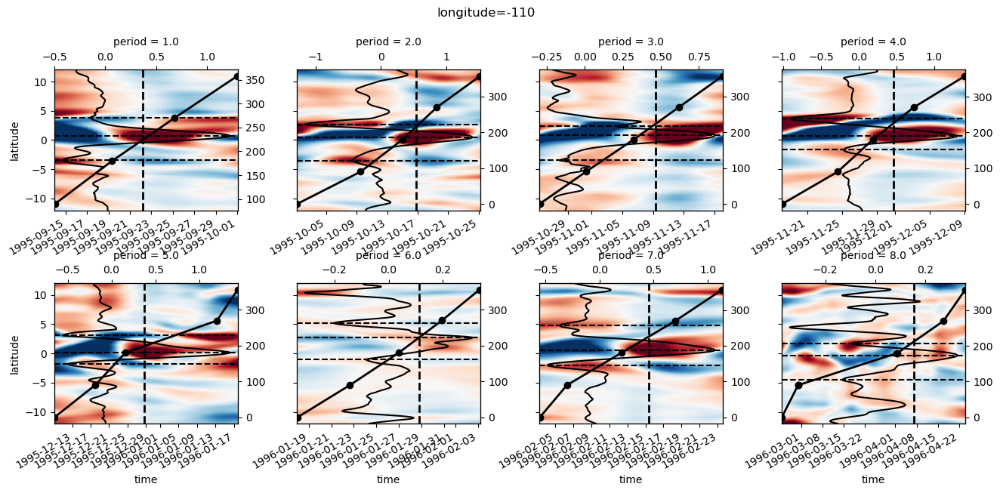

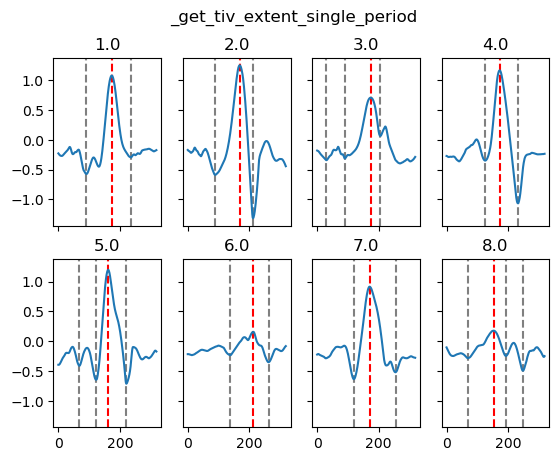

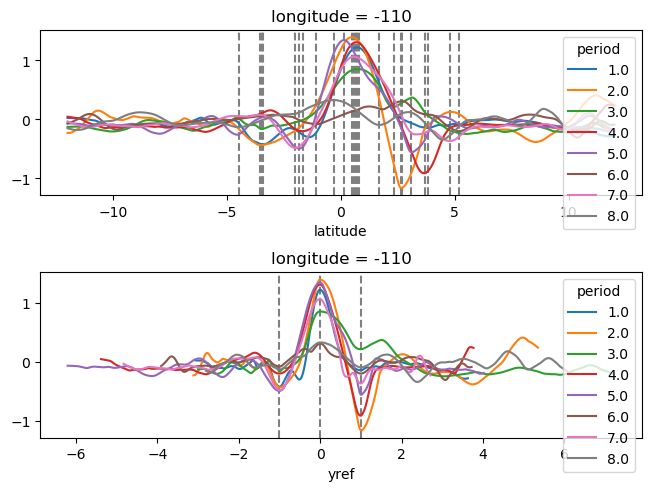

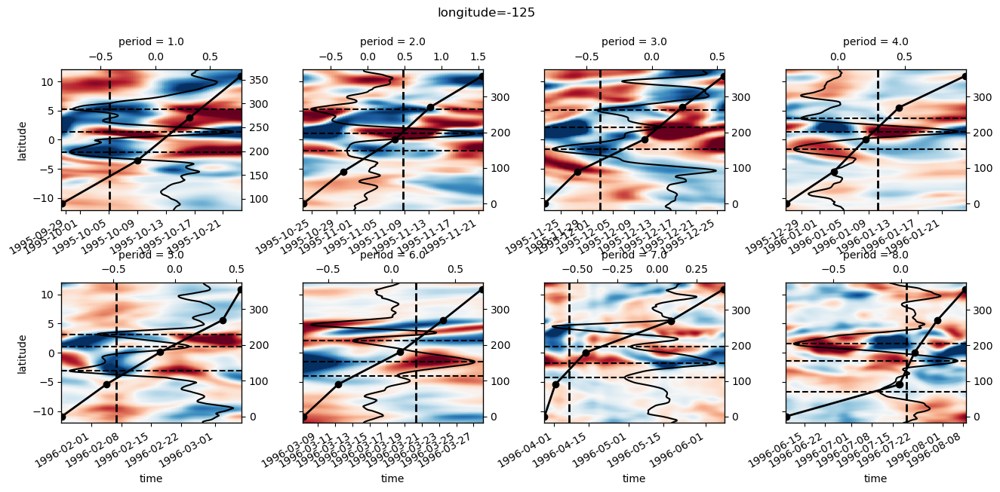

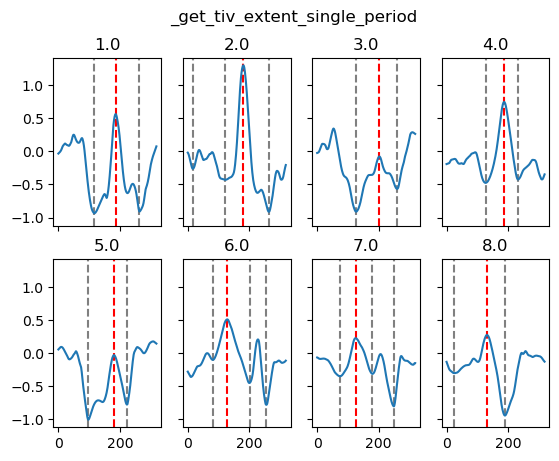

...

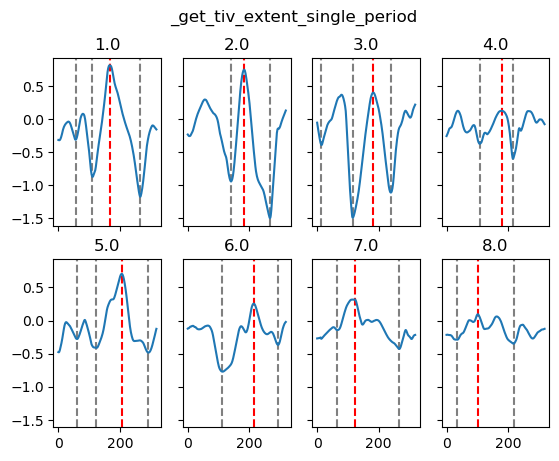

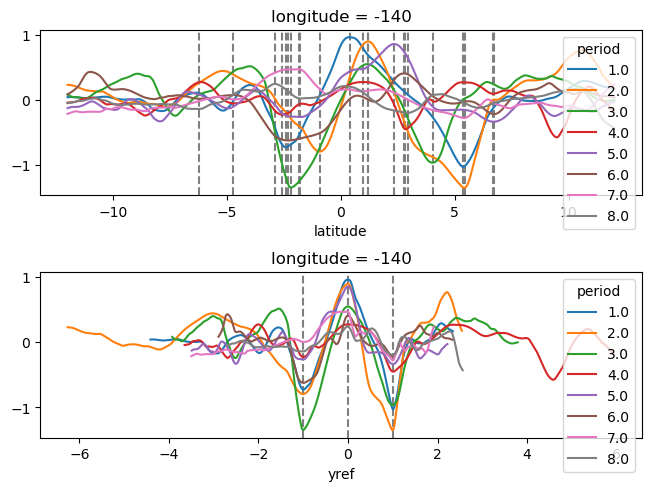

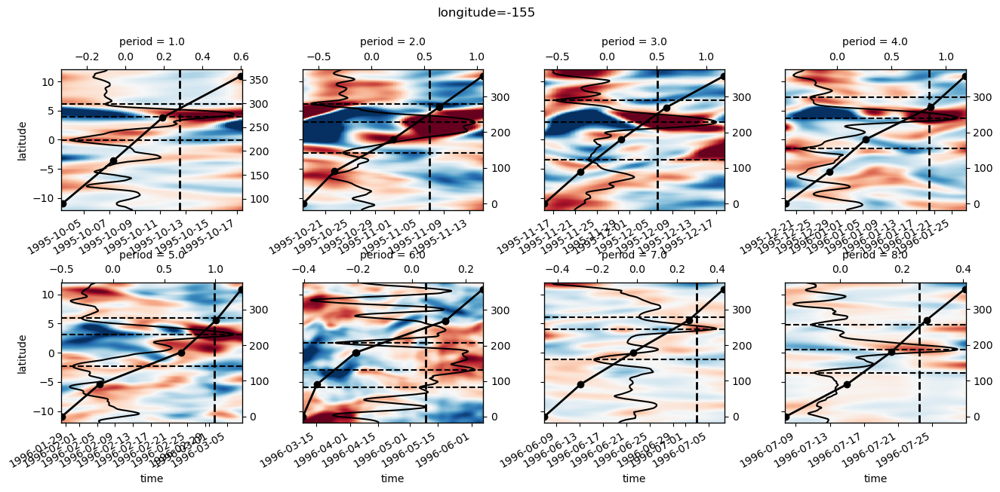

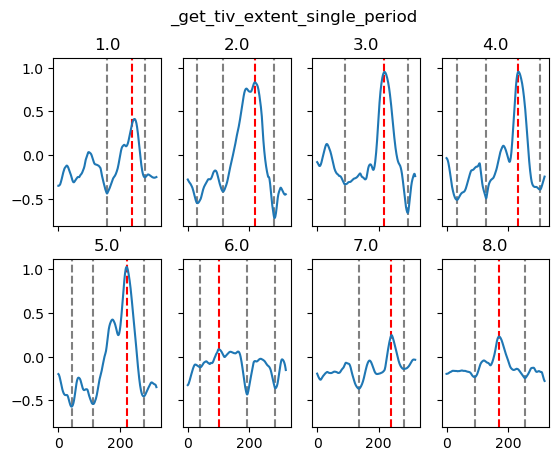

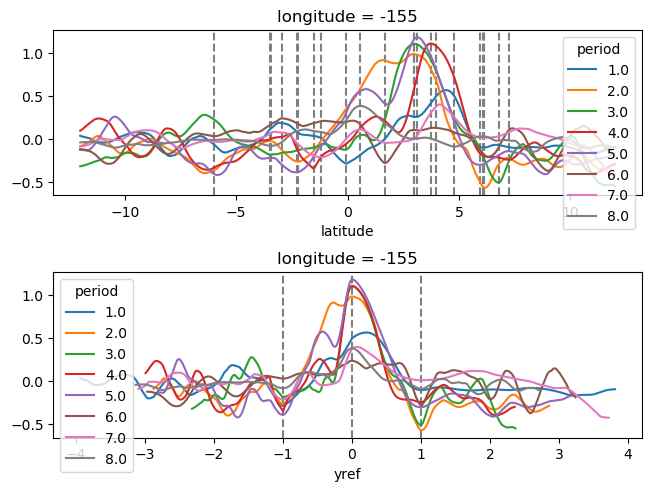

In [91]:
for longitude in sst_sub.longitude.values:
    yref, reference = pump.composite.get_y_reference(
        sst_sub.sel(longitude=[longitude]), 
        periods=periods, 
        kind="warm",
        debug=True,
        savefig=True,
    )

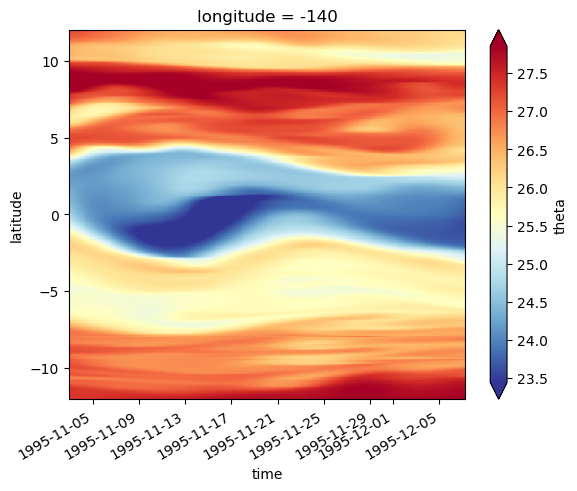

In [44]:
(
    sst_sub
    .sel(longitude=-140)
    .groupby("period")
    .get_group(3.0)
    .plot(x="time", robust=True, cmap=mpl.cm.RdYlBu_r)
)

# MOM6 weirdness

fails without combine="nested"

In [231]:
ds = xr.open_mfdataset(
    "/glade/scratch/gmarques/g.c2b6.GJRA.TL319_t061.GME_no_MEKE.001/run/g.c2b6.GJRA.TL319_t061.GME_no_MEKE.001.mom6.hm_*.nc",
    parallel=True, 
    combine="nested", # concatenate in order of files
    concat_dim="time", # concatenate along time
).chunk({"time": 12})

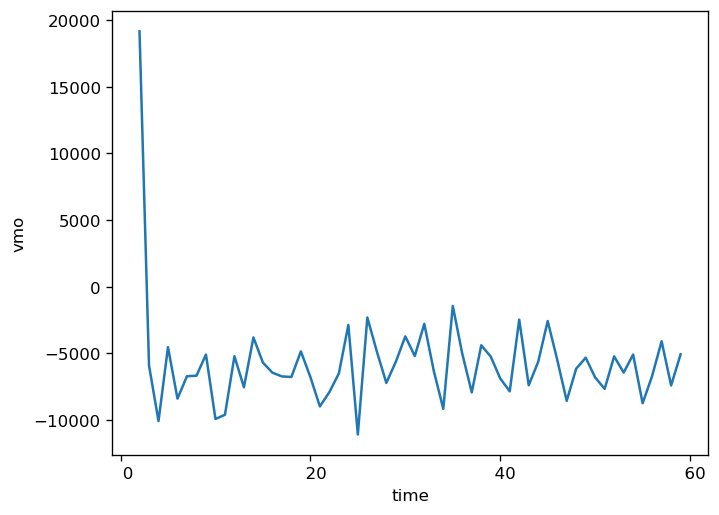

In [237]:
ds.vmo.resample(time="Y").mean(...).plot()

# OSM2020 figures

## DCL snapshot

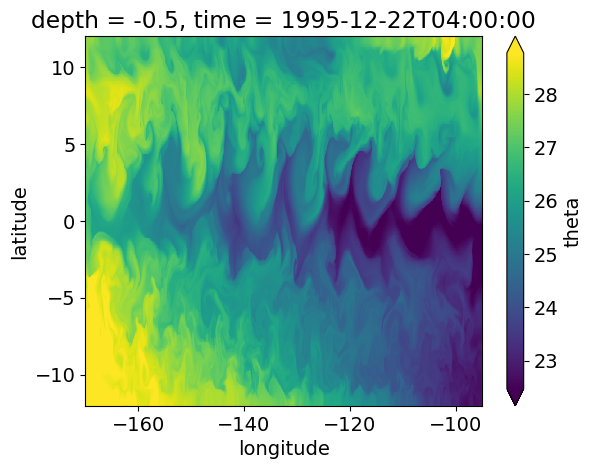

In [188]:
(sst).plot(robust=True)

In [218]:
full = ( 
    gcm1.full.sel(time="1995-09-05")
    [["u", "v", "dens"]]
    .compute()
)

full["S2"] = (
    full.u.differentiate("depth")**2
    + full.v.differentiate("depth")**2
)
full["N2"] = -9.81/1025 * full.dens.differentiate("depth")
full["Ri"] = full.N2.where(full.N2 > 1e-6) / full.S2

In [221]:
mld_full = pump.calc.get_mld(full.dens)
dcl_full = pump.calc.get_dcl_base_Ri(full, mld_full)

sst = gcm1.surface.theta.sel(time=full.time.values)

In [211]:
def clean_axis(ax):
    ax.tick_params(
        axis="both", direction="in", color='k', top=True, right=True, length=7.5, width=1,
    )
    ax.set_yticks([-10, -5, 0, 5, 10])

    ylabels = []
    for tt in ax.get_yticks():
        if tt < 0:
            add = "S"
        elif tt > 0:
            add = "N"
        else:
            add = ""
        ylabels.append(str(tt) + "°" + add)
    ax.set_yticklabels(ylabels)

    ax.set_xticks([-95, -110, -125, -140, -155, -170])
    ax.set_xticklabels([str(tt)[1:]+"°W" for tt in ax.get_xticks()])
    for spine in ax.spines:
        ax.spines[spine].set_color("k")

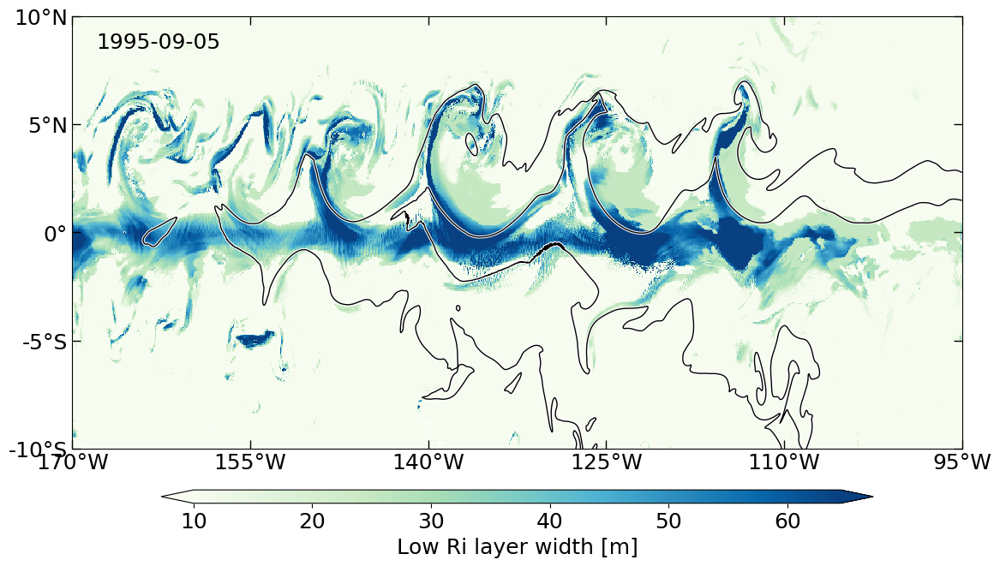

In [253]:
f, ax=  plt.subplots(1,1, constrained_layout=True)
plt.rcParams["font.size"] = 18

cont = (sst.mean("time")).plot.contour(
    levels=[24, 26], colors='w', linewidths=2.5, add_labels=False, ax=ax,
)
cont = (sst.mean("time")).plot.contour(
    levels=[24, 26], colors='k', linewidths=1, add_labels=False, ax=ax,
)
# dcpy.plots.contour_label_spines(cont)
dcpy.plots
(
    (mld_full.median("time") - dcl_full.median("time"))
    # .coarsen(longitude=3, latitude=3).mean()
    .plot(
        robust=True, 
        vmin=10, 
        cmap=mpl.cm.GnBu, 
        cbar_kwargs={
            "orientation": "horizontal", 
            "aspect": 30,
            "shrink": 0.8,
            "label": "Low Ri layer width [m]"
        },
        ylim=[-10, 10],
        add_labels=False,
        ax=ax
    )
)
plt.gcf().set_size_inches(16/9*6.5, 6.5)

clean_axis(ax)
ax.text(-168, 8.5, f"{sst.time[0].dt.strftime('%Y-%m-%d').values}")
#ax.text(-105, 1.65, "SST=24°C", fontstyle="italic")
#ax.text(-105, 0.65, "SST=26°C", fontstyle="italic")
f.savefig("images/dcl-sst-snapshot.png", dpi=150)

## deep cycle in time at 3°N, 110W, period 4

## jq, sst many periods

1. [ ] where is the EUC. use that to select latitudes
2. [ ] jq contours?

In [134]:
(full_subset.u
 .sel(time=slice("1995-10-08", "1995-12-08"), longitude=-110)
 .mean("time")
 .plot.contourf(levels=21, y="depth", vmax=1)
)

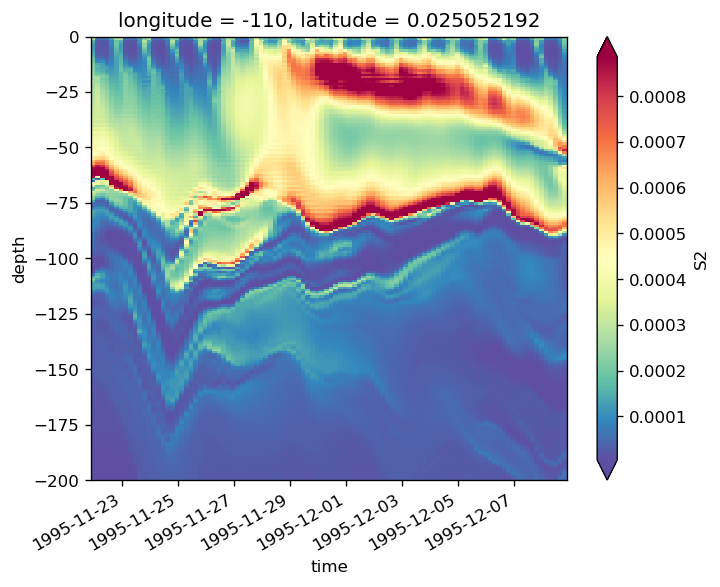

In [253]:
(
    full_subset.S2
    .sel(time=slice("1995-11-22", "1995-12-08"), longitude=-110)
    .sel(latitude=0, method="nearest")
).plot(cmap=mpl.cm.Spectral_r, x="time", robust=True)

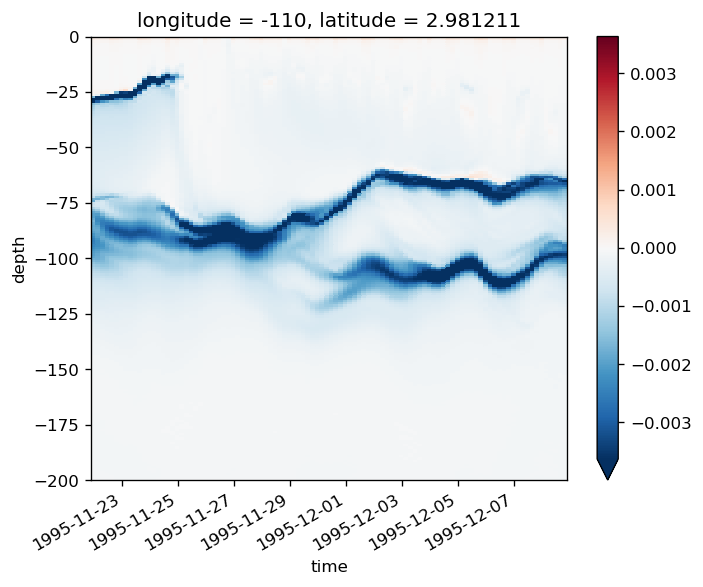

In [272]:
(
    (full_subset.S2-4*full_subset.N2)
    .sel(time=slice("1995-11-22", "1995-12-08"), longitude=-110)
    .sel(latitude=3,method="nearest")
).plot(x="time", robust=True)

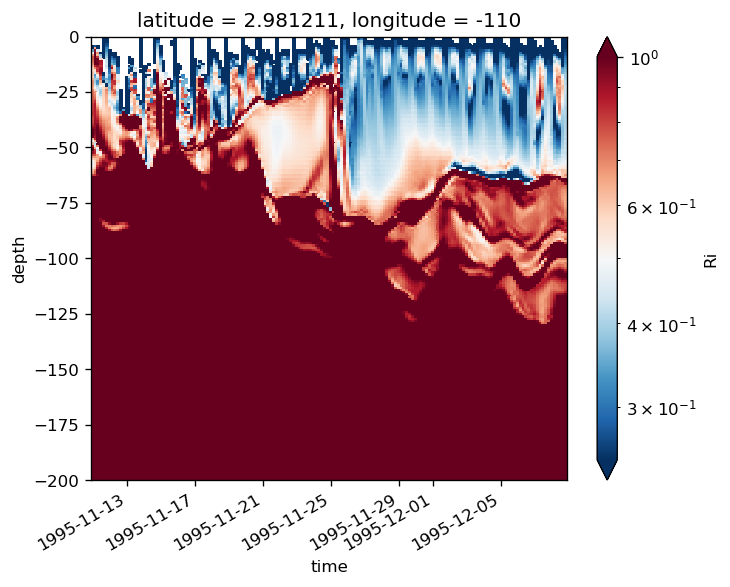

In [13]:
(
    full_subset.Ri
    .sel(time=slice("1995-11-11", "1995-12-08"), longitude=-110)
    .sel(latitude=3, method="nearest")
).plot(norm=mpl.colors.LogNorm(0.25, 1), cmap=mpl.cm.RdBu_r, x="time")

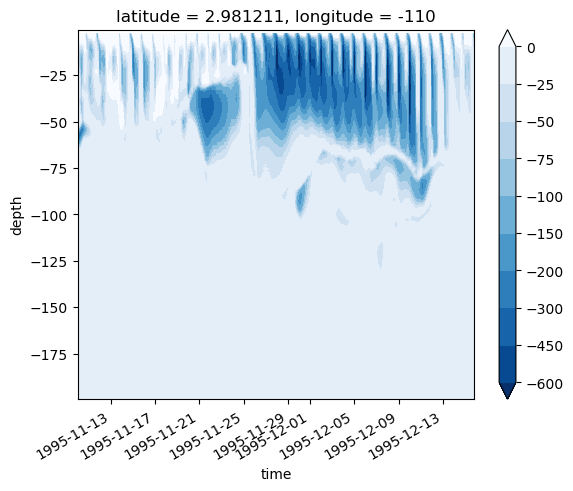

In [50]:
jq = full_subset.Jq.sel(time=slice("1995-11-10", "1995-12-15"), 
                   longitude=-110).sel(latitude=3, method="nearest")

jq.rolling(depth=2).mean().plot.contourf(
    x="time", 
    levels=np.sort([-600, -450, -300,  -200, -150, -100, -75, -50, -25, 0]), 
    cmap=mpl.cm.Blues_r
)

In [42]:
full_subset.Jq

<xarray.DataArray 'Jq' (time: 1098, depth: 200, latitude: 480, longitude: 2)>
dask.array<rechunk-merge, shape=(1098, 200, 480, 2), dtype=float64, chunksize=(36, 200, 480, 1), chunktype=numpy.ndarray>
Coordinates:
  * depth      (depth) float32 -0.5 -1.5 -2.5 -3.5 ... -197.5 -198.5 -199.5
  * time       (time) datetime64[ns] 1995-09-01 ... 1996-03-01T20:00:00
  * latitude   (latitude) float32 -12.0 -11.949896 -11.899791 ... 11.949896 12.0
  * longitude  (longitude) int64 -110 -125
    yref       (time, longitude, latitude) float32 nan nan nan ... nan nan nan
    period     (longitude, time) float64 nan nan nan nan nan ... 6.0 6.0 6.0 6.0
    tiw_phase  (longitude, time) float64 nan nan nan nan ... 300.0 301.0 302.0
Attributes:
    long_name:  $J_q^t$
    units:      W/m$^2$

In [43]:
ax

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x2ab70b7c82d0>,
      dtype=object)

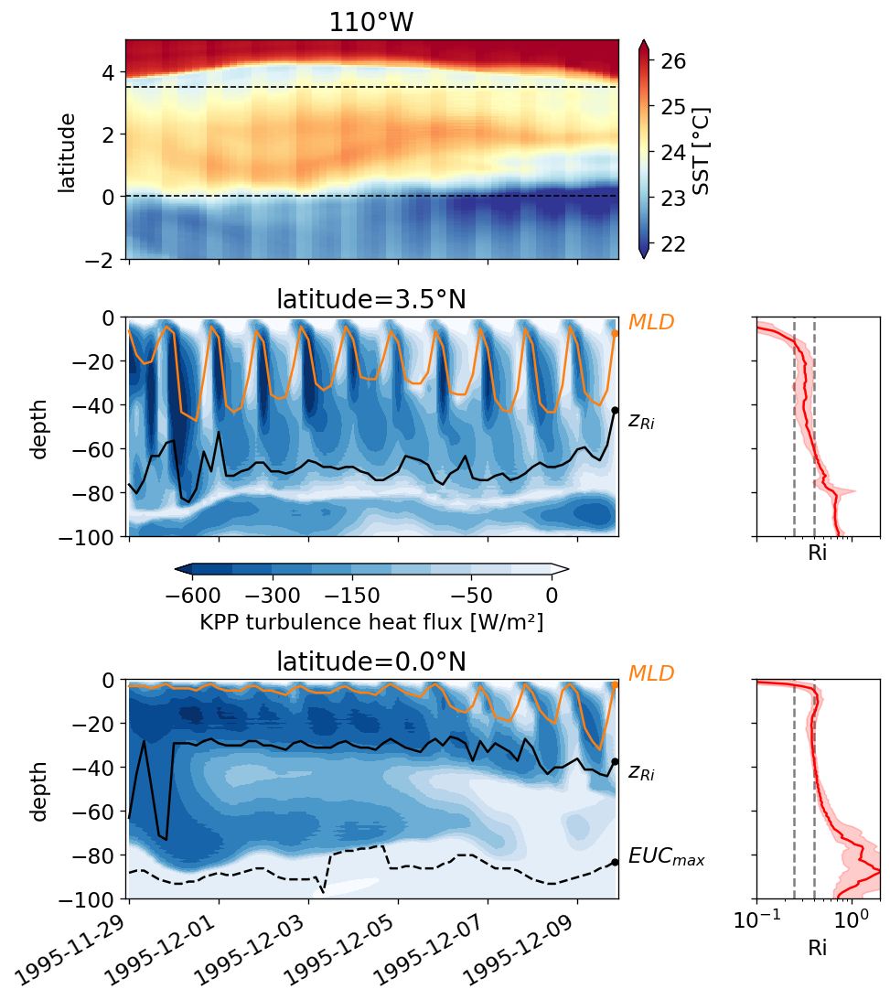

In [45]:
plt.rcParams["font.size"] = 14

f, ax = pump.plot.plot_jq_sst(
    gcm1, 
    lon=-110, 
    periods=slice("1995-11-29", "1995-12-09"), 
    lat=[0,3.5], 
    period=period.sel(longitude=-110), 
    full=full_subset.assign_coords(euc_max=euc_max),
    eucmax=euc_max,
    time_Ri={
        0: slice("1995-11-17", "1995-11-29"),
        3.5: slice("1995-11-28", "1995-12-09"),
    }
)

f.savefig("images/sst-deep-cycle-3N-zoomin.png", dpi=150)

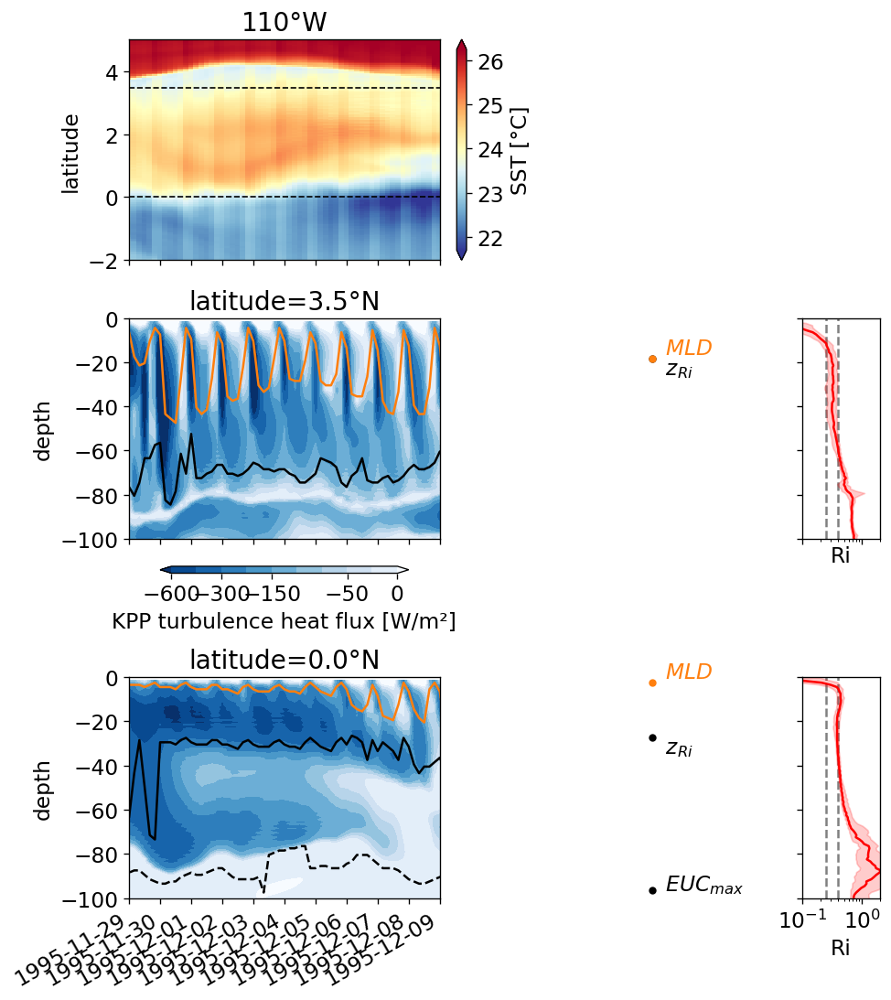

In [44]:
plt.rcParams["font.size"] = 14

f, ax = pump.plot.plot_jq_sst(
    gcm1, 
    lon=-110, 
    periods=slice("1995-11-10", "1995-12-15"), 
    lat=[0,3.5], 
    period=period.sel(longitude=-110), 
    full=full_subset.assign_coords(euc_max=euc_max),
    eucmax=euc_max,
    time_Ri={
        0: slice("1995-11-17", "1995-11-29"),
        3.5: slice("1995-11-28", "1995-12-09"),
    }
)
f.savefig("images/sst-deep-cycle-3N.png", dpi=150)

#ax[0,0].set_xlim("1995-11-29", "1995-12-09")
#f.savefig("images/sst-deep-cycle-3N-zoomin.png", dpi=150)
# f.set_size_inches((9))

# stuff

## saving density to file

In [ ]:
ds = dcpy.eos.pden(full.salt, full.theta, full.depth).to_dataset(name="dens")
dcpy.dask.batch_to_zarr( ds, 
                        dim="time", 
                        file="/glade/u/home/dcherian/pump/glade/gcm1-sections-dens.zarr",
                        batch_size=500)

# dens = xr.open_zarr("/glade/u/home/dcherian/pump/glade/gcm1-sections-dens.zarr", consolidated=True)

## other

In [95]:
gcm1.budget = gcm1.budget.chunk({"time": 1, "depth": 10})

In [74]:
jq110 = gcm1.budget.Jq.sel(longitude=-110, method="nearest").sel(depth=slice(0, -500))

In [77]:
sections_jq = gcm1.budget.Jq.sel(longitude=gcm1.tao.longitude, method="nearest")
len(sections_jq.__dask_graph__())

389886

In [93]:
gcm1.read_budget()

/glade/u/home/dcherian/pump/pump/model/model.py:251: FutureWarning: In xarray version 0.14 the default behaviour of `open_mfdataset`
will change. To retain the existing behavior, pass
combine='nested'. To use future default behavior, pass
combine='by_coords'. See
http://xarray.pydata.org/en/stable/combining.html#combining-multi

  files, drop_variables=["DFxE_TH", "DFyE_TH", "DFrE_TH"], **kwargs
/gpfs/u/home/dcherian/python/xarray/xarray/backends/api.py:931: FutureWarning: The datasets supplied have global dimension coordinates. You may want
to use the new `combine_by_coords` function (or the
`combine='by_coords'` option to `open_mfdataset`) to order the datasets
before concatenation. Alternatively, to continue concatenating based
on the order the datasets are supplied in future, please use the new
`combine_nested` function (or the `combine='nested'` option to
open_mfdataset).
  from_openmfds=True,
/glade/u/home/dcherian/pump/pump/model/model.py:253: FutureWarning: In xarray version 0.

# reference by SST warm anomaly

Define t=180 as time of warmest anomaly SST

In [31]:
gcm1.surface = gcm1.surface.chunk({"longitude": 10, "latitude": -1, "time": -1})

In [40]:
lon = -110
sst = gcm1.surface.sel(longitude=lon, method="nearest").theta.load() 
    
    #assign_coords(
    #tiw_phase=tiw_phase, period=period
#)

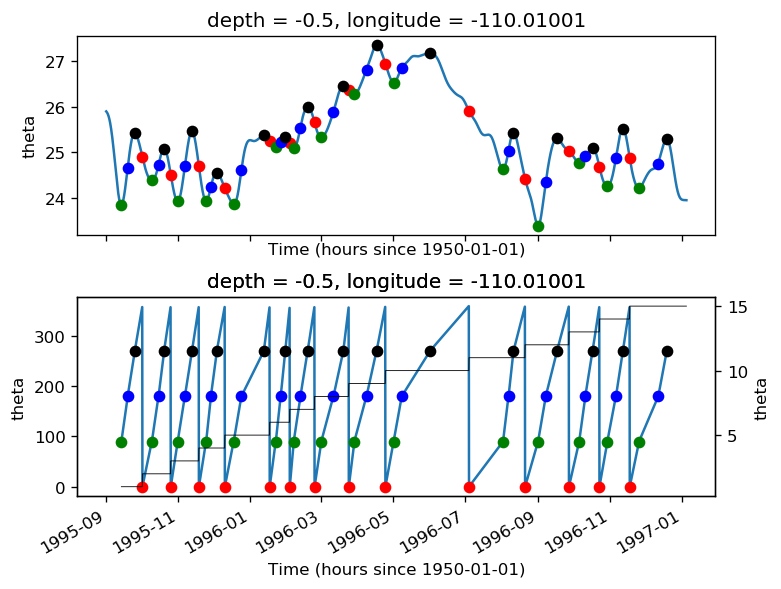

In [82]:
tiw_phase, period = pump.calc.get_tiw_phase_sst(
    sst,
    debug=True
)

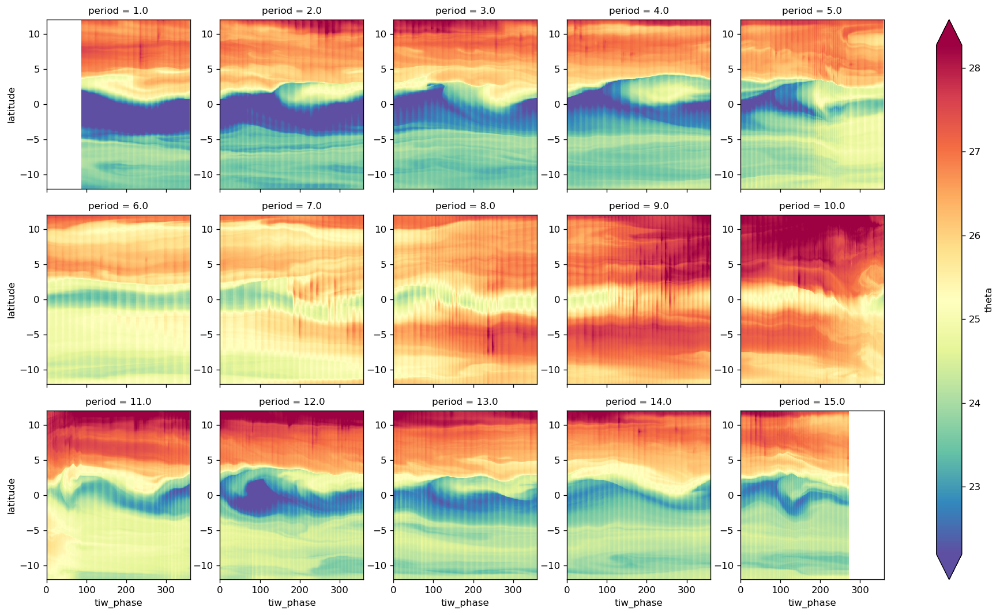

In [86]:
(
    sst.assign_coords(tiw_phase=phase, period=period)
    .where(phase.notnull(), drop=True)
    .groupby("period")
    .plot(
        col="period",
        col_wrap=5,
        x="tiw_phase",
        robust=True,
        sharex=True,
        sahery=True,
        cmap=mpl.cm.Spectral_r,
        xlim=[0, 360],
    )
)

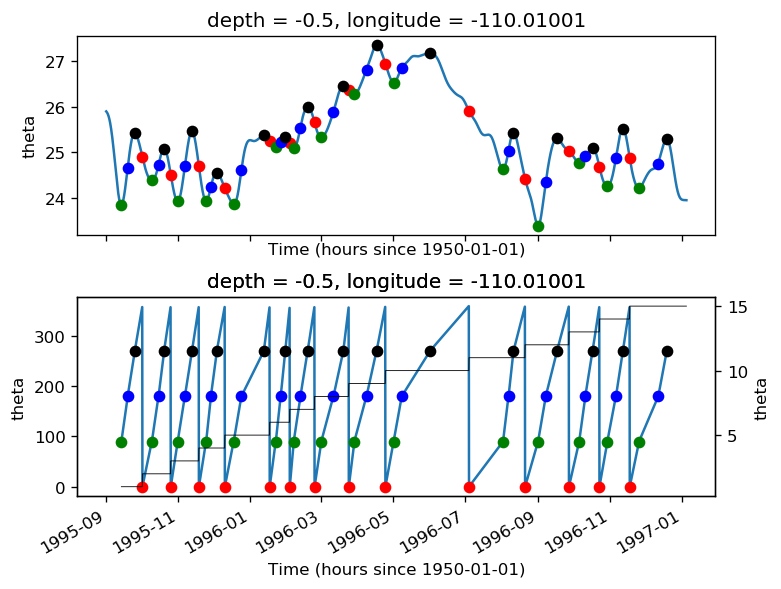

In [69]:
import xfilter
import scipy as sp

sstfilt = xfilter.lowpass(
    sst.sel(latitude=slice(0, 5)).mean("latitude"),
    coord="time",
    freq=1 / 15,
    cycles_per="D",
    num_discard=0,
)

if sstfilt.ndim > 1:
    raise NotImplementedError("tiw phase estimation for SST not vectorized yet")

sig = sstfilt.compute()

phase, period = pump.calc.merge_phase_label_period(
    sig, phase_0, phase_90, phase_180, phase_270, debug=True, 
)


/gpfs/u/home/dcherian/python/xarray/xarray/plot/utils.py:650: RuntimeWarning: invalid value encountered in greater_equal
  np.arange(0, n - 1), axis=axis
/gpfs/u/home/dcherian/python/xarray/xarray/plot/utils.py:653: RuntimeWarning: invalid value encountered in less_equal
  np.arange(0, n - 1), axis=axis


ValueError: The input coordinate is not sorted in increasing order along axis 0. This can lead to unexpected results. Consider calling the `sortby` method on the input DataArray. To plot data with categorical axes, consider using the `heatmap` function from the `seaborn` statistical plotting library.

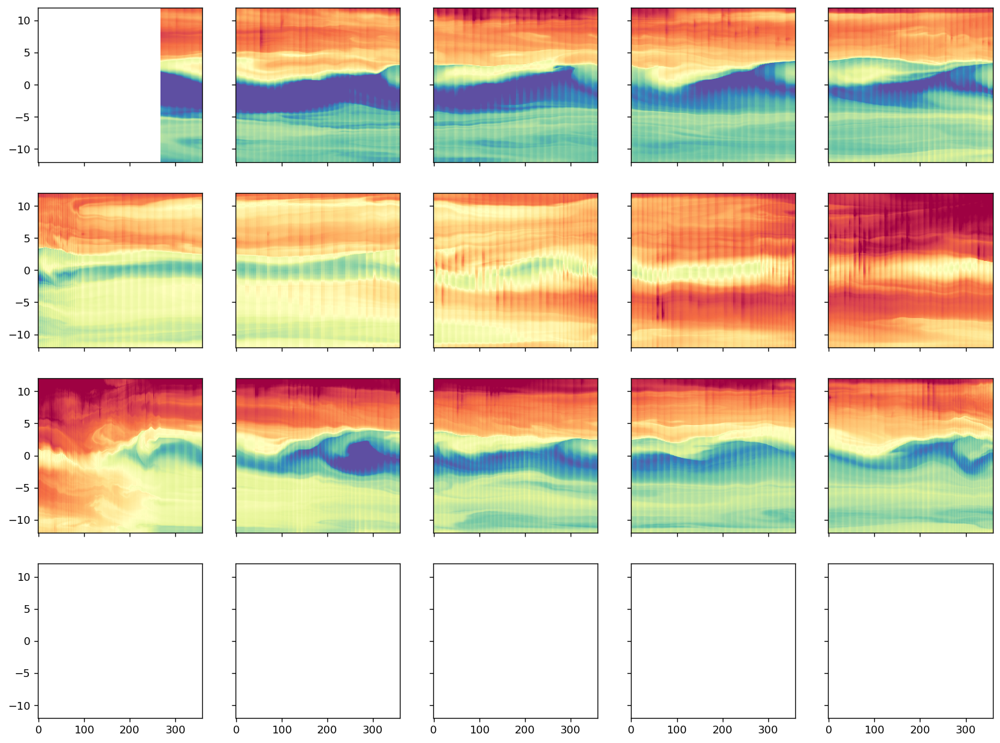

In [39]:
sst.load().groupby("period").plot(
    col="period", col_wrap=5, x="tiw_phase", sharex=True, sharey=True, robust=True, cmap=mpl.cm.Spectral_r,
)

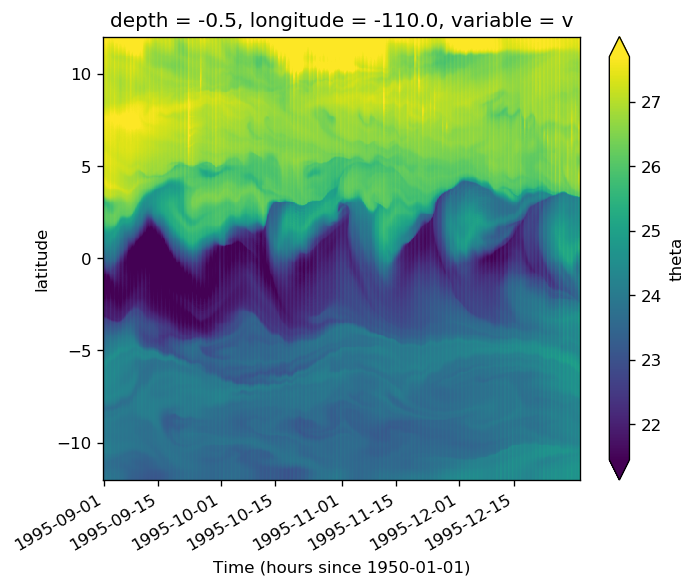

In [68]:
sst.sel(time="1995").plot(x="time", robust=True)

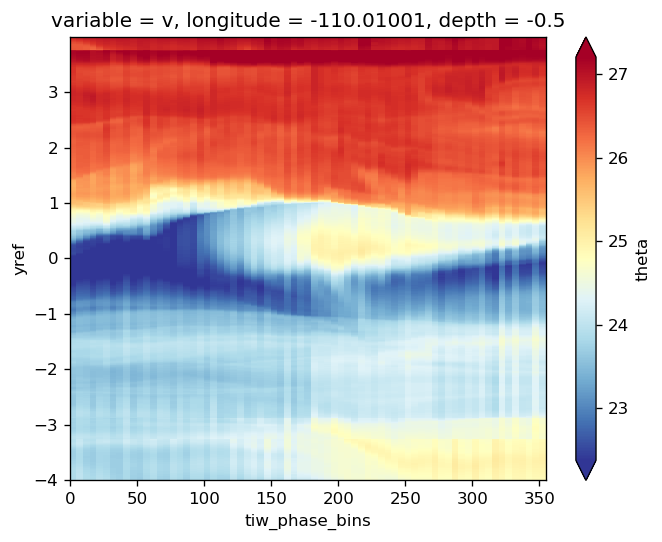

In [69]:
(composite.where((np.abs(composite) - error)/np.abs(composite) > 0.2)
 .theta.plot(y="yref", robust=True, cmap=mpl.cm.RdYlBu_r))

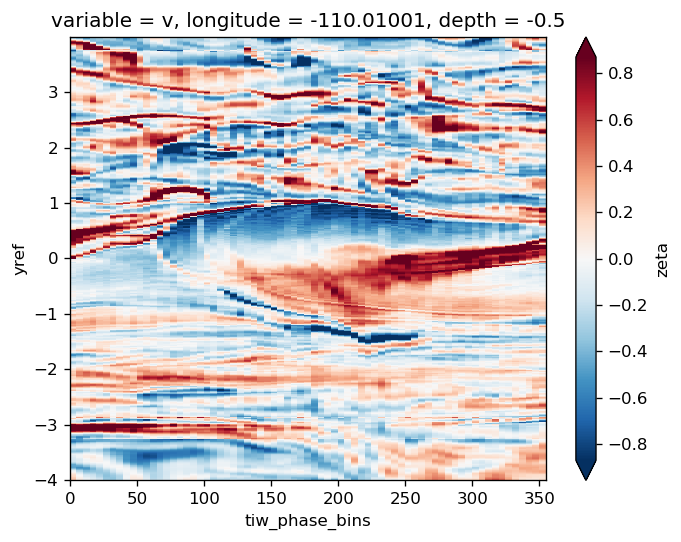

In [41]:
composite.zeta.plot(x="tiw_phase_bins", robust=True)

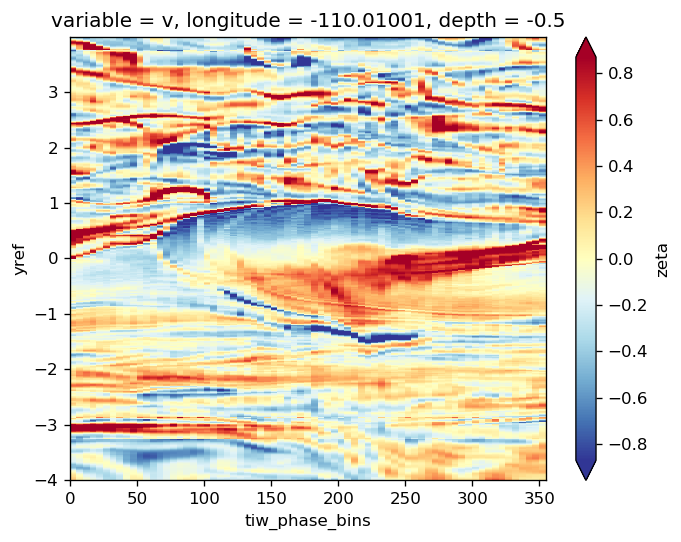

In [24]:
(
    
    .mean("time")
    .zeta
    .plot(y="yref", robust=True, cmap=mpl.cm.RdYlBu_r)
)

In [25]:
subset = surf110.theta.where(surf110.period.isin([4, 5, 6]), drop=True)
    
subset.groupby_bins("tiw_phase", np.arange(0, 360, 5)).mean("time")

<xarray.DataArray 'theta' (tiw_phase_bins: 71, latitude: 480)>
array([[24.02839 , 23.976442, 23.973637, ..., 27.767008, 27.778406,
        27.87533 ],
       [24.0917  , 24.11233 , 24.111015, ..., 27.784744, 27.815428,
        27.835466],
       [24.08908 , 24.072989, 24.073553, ..., 27.795588, 27.813833,
        27.848253],
       ...,
       [24.438179, 24.39509 , 24.387403, ..., 27.408218, 27.423044,
        27.477694],
       [24.544092, 24.578922, 24.572287, ..., 27.395113, 27.4082  ,
        27.446953],
       [24.442354, 24.41639 , 24.418417, ..., 27.413233, 27.42465 ,
        27.491432]], dtype=float32)
Coordinates:
  * tiw_phase_bins  (tiw_phase_bins) object (0, 5] (5, 10] ... (350, 355]
  * latitude        (latitude) float32 -12.0 -11.949896 ... 11.949896 12.0
    depth           float32 -0.5
    longitude       float32 -110.01001
    variable        <U1 'v'

/gpfs/u/home/dcherian/python/xarray/xarray/core/common.py:674: FutureWarning: This DataArray contains multi-dimensional coordinates. In the future, the dimension order of these coordinates will be restored as well unless you specify restore_coord_dims=False.
  self, group, squeeze=squeeze, restore_coord_dims=restore_coord_dims


ValueError: operands could not be broadcast together with remapped shapes [original->remapped]: (142,) and requested shape (142,480)

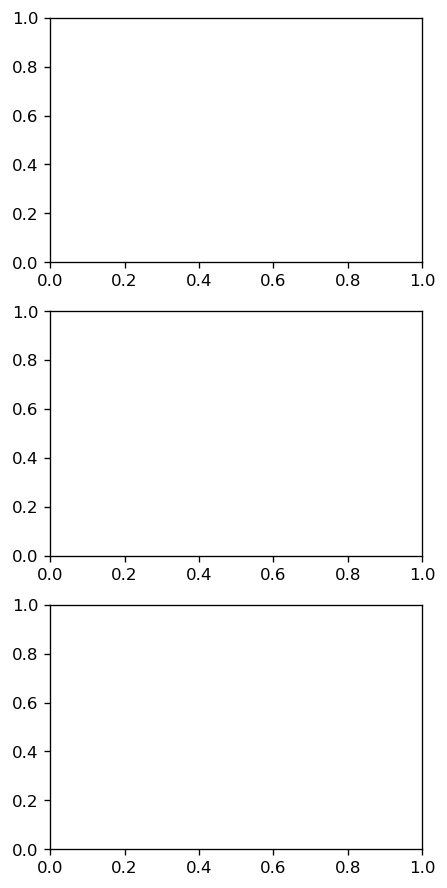

In [30]:
(data.theta
 .groupby("period")
 .apply(lambda x: x - x.mean("time"))
 .groupby("period")
 .plot.pcolormesh(row="period", x="time", y="yref", robust=True, add_colorbar=False, ylim=[-3, 3]))

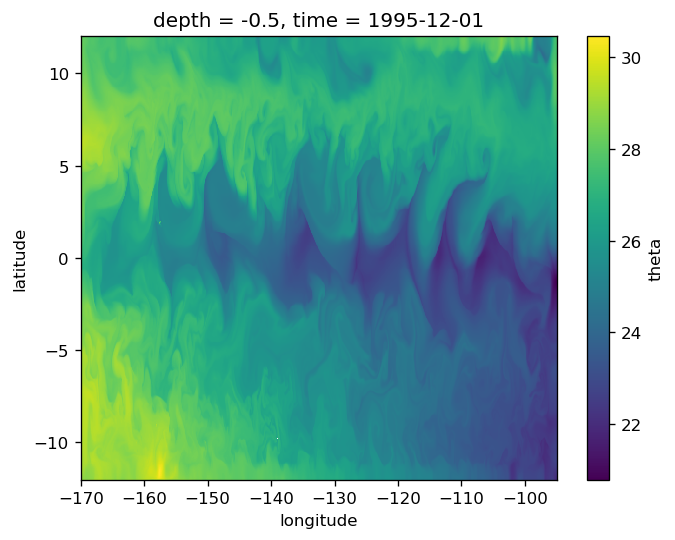

In [360]:
gcm1.surface.theta.sel(time="1995-12-01 00:00").plot()
dcpy.plots.liney(0)

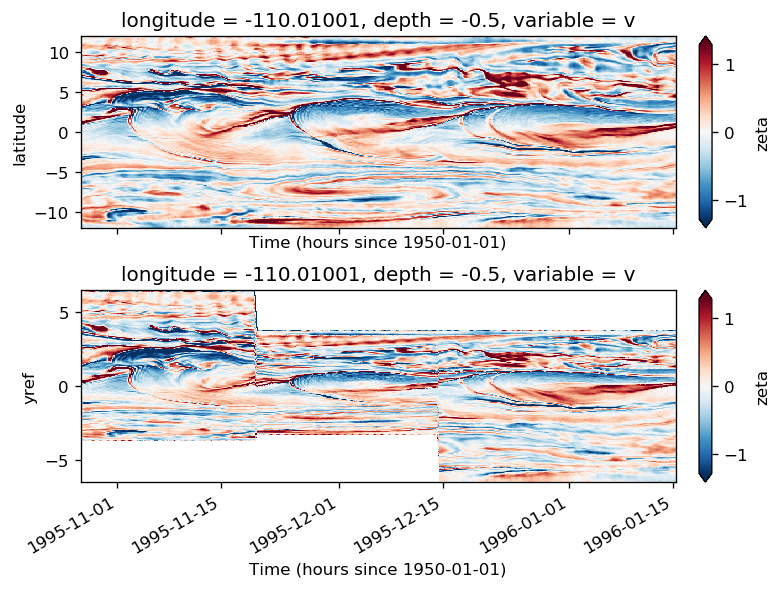

In [336]:
%matplotlib inline

surf110 = surf110.assign_coords(tmat=surf110.time.broadcast_like(surf110.theta))

f, ax = plt.subplots(2, 1, sharex=True, constrained_layout=True)
surf110.zeta.where(surf110.period.isin([4,5,6]), drop=True).plot(x="time", y="latitude", ax=ax[0], robust=True)
surf110.zeta.where(surf110.period.isin([4,5,6]), drop=True).plot(x="tmat", y="yref", ax=ax[1], robust=True)

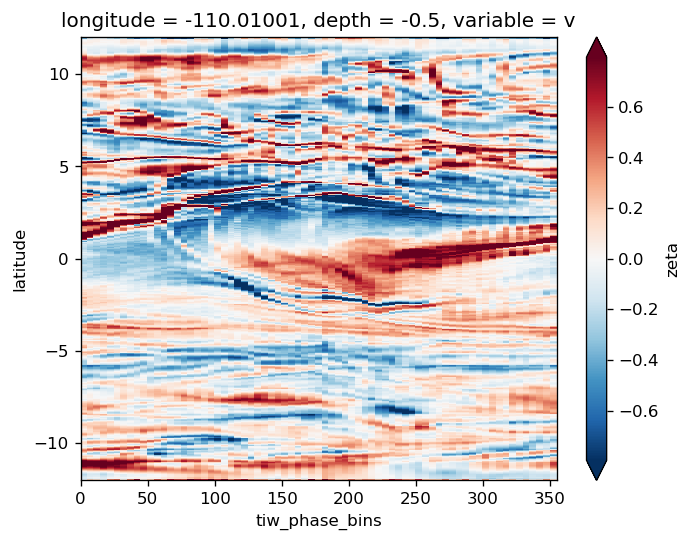

In [73]:
(surf110.zeta.where(surf110.period.isin([4, 5, 6]))
 .groupby_bins("tiw_phase", np.arange(0, 360, 5)).mean("time")
 .plot(y="latitude", robust=True))

In [ ]:
%matplotlib notebook

def mark_periods(period, ax=None):
    if ax is None:
        ax = plt.gca()
    unique_periods = np.unique(period.dropna('time'))
    for per in unique_periods:
        tstart = period.time.where(period == per, drop=True)[0].values
        tstop = period.time.where(period == per, drop=True)[-1].values
        ax.text(tstart, 5, f"{per:.0f}")
        ax.axvline(tstart, color='w', zorder=11)
        ax.axvline(tstop, color='w', zorder=11)
        
def plot_surface_fields(model, longitude, latitude=2):
    latlon = dict(longitude=longitude, latitude=latitude, method="nearest")
    tao = model.tao.sel(**latlon)
    
    phase = model.tao.tiw_phase.sel(**latlon)
    phase360 = phase.where(np.abs(phase-360) < 5, drop=True)
    
    f0 = dcpy.oceans.coriolis(model.surface.latitude)

    f, ax = plt.subplots(2, 1, sharex=True, sharey=True)

    plt.sca(ax[0])
    tao.sel(depth=slice(-25, -80)).mean("depth").v.plot(x="time")
    (f0 + model.surface.zeta).sel(**latlon).plot(x="time")
    (f0 + model.surface.sel(longitude=longitude, method="nearest").zeta).plot(
        x="time", robust=True, add_colorbar=False)
    
    plt.sca(ax[1])
    tao.sel(depth=slice(-25, -80)).mean("depth").v.plot(x="time")
    model.surface.zeta.sel(**latlon).plot(x="time")
    model.surface.sel(longitude=longitude, method="nearest").theta.plot(
        x="time", robust=True, cmap=mpl.cm.RdYlBu_r, add_colorbar=False)
    
    [mark_periods(model.tao.period.sel(**latlon), ax=aa) for aa in ax]
    #[dcpy.plots.linex(phase360.time.values, ax=aa, zorder=10) for aa in ax]
    
    return ax


ax = plot_surface_fields(gcm1, -110, 2)

In [80]:
gcm1.surface = gcm1.surface.chunk({"longitude": 150, "latitude": 120})

In [73]:
gcm1.surface.zeta.sel(longitude=-110, method="nearest").plot(x="time", robust=True, cbar_kwargs={"orientation": "horizontal"})

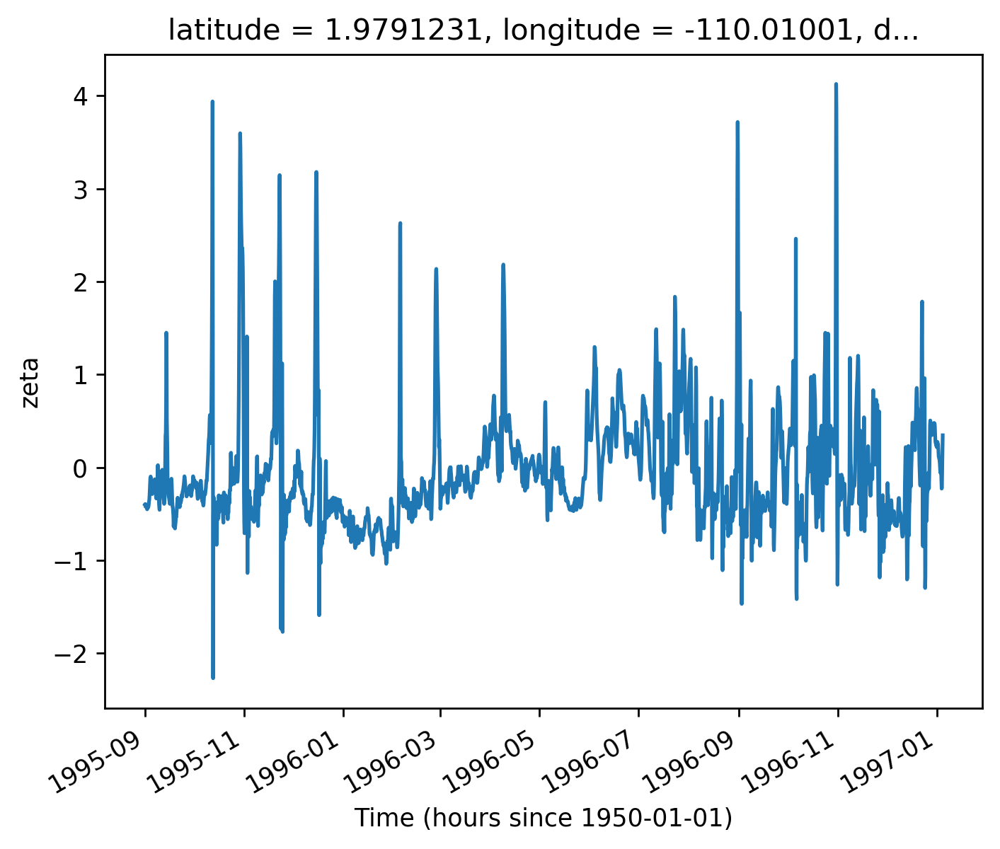

In [49]:
gcm1.surface.zeta.sel(longitude=-110, latitude=2, method="nearest").plot()
# gcm1.surface.zeta.sel(longitude=-125, latitude=2, method="nearest").plot()
# gcm1.surface.zeta.sel(longitude=-140, latitude=2, method="nearest").plot()

In [ ]:
surf140.zeta.plot(y="latitude", robust=True)
plt.figure()
surf140.v.plot(y="latitude")
surf140.zeta.where(surf140.zeta > 1).plot.contour(y="latitude", linewidths=0.5, colors='k')

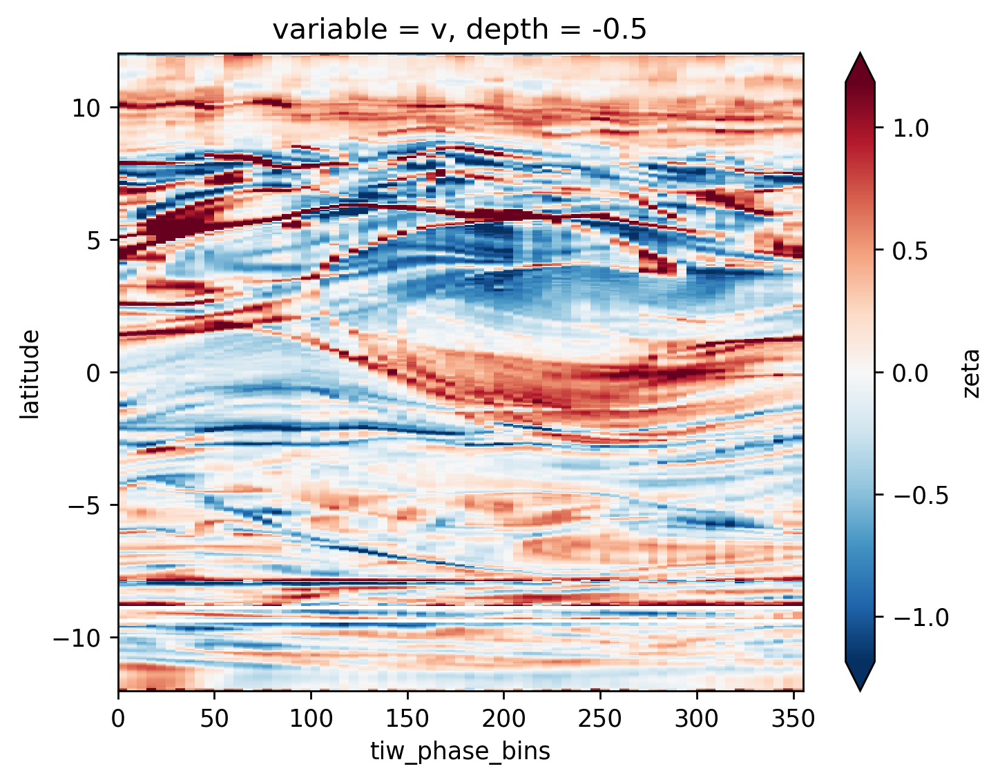

In [67]:
avg_surf.zeta.plot(x="tiw_phase_bins", robust=True)

In [ ]:
surf140.theta.plot(x="time")

KeyboardInterrupt: 

ERROR:asyncio:Task exception was never retrieved
future: <Task finished coro=<BaseTCPConnector.connect() done, defined at /glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/distributed/comm/tcp.py:349> exception=CommClosedError('in <distributed.comm.tcp.TCPConnector object at 0x2ac997f167f0>: ConnectionRefusedError: [Errno 111] Connection refused',)>
Traceback (most recent call last):
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/distributed/comm/tcp.py", line 356, in connect
    ip, port, max_buffer_size=MAX_BUFFER_SIZE, **kwargs
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/tornado/gen.py", line 1141, in run
    yielded = self.gen.throw(*exc_info)
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/tornado/tcpclient.py", line 232, in connect
    af, addr, stream = yield connector.start(connect_timeout=timeout)
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/pyt

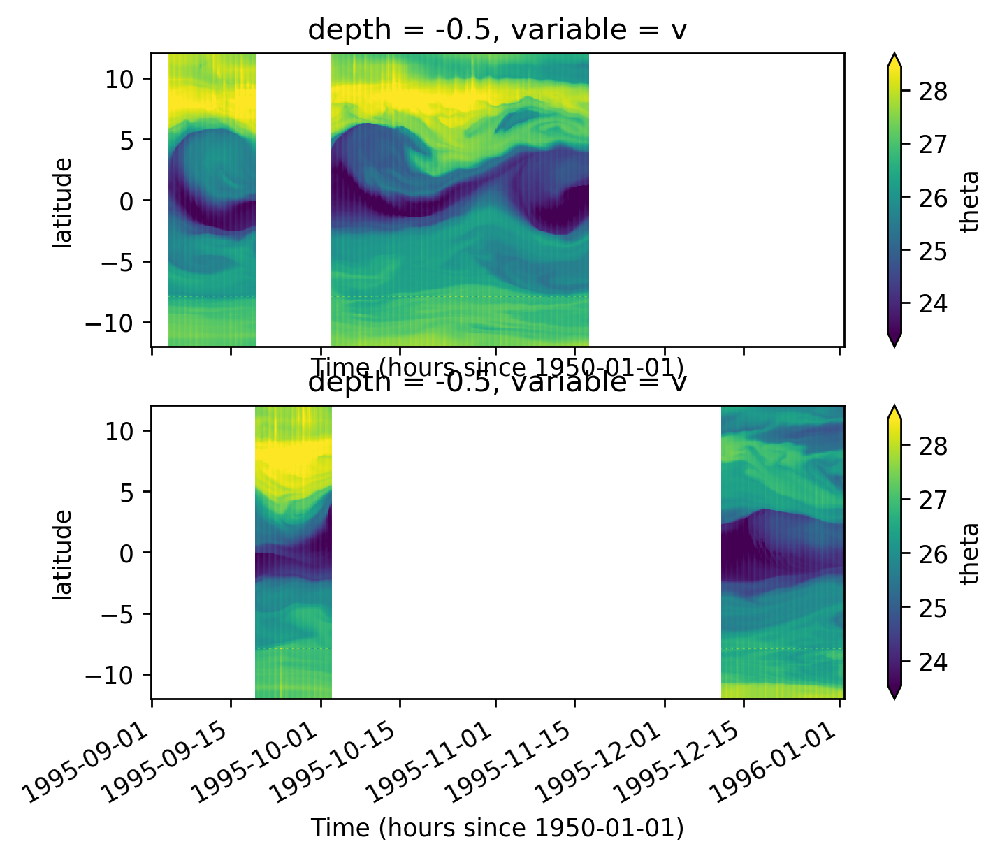

In [28]:
f, ax = plt.subplots(2, 1, sharex=True)
surf140.theta.where(tao0140.period.isin([1, 3, 4])).plot(x="time", robust=True, ax=ax[0])
surf140.theta.where(tao0140.period.isin([2, 6])).plot(x="time", robust=True, ax=ax[1])

(array([  36.,   29.,   38.,   55.,   63.,   88.,  114.,  121.,  133.,
         161.,  256.,  370.,  515.,  480.,  481.,  443.,  428.,  417.,
         338.,  323.,  311.,  303.,  330.,  318.,  281.,  312.,  317.,
         341.,  298.,  390.,  538.,  670.,  796., 1028., 1070.,  893.,
         793.,  674.,  688.,  689.,  742.,  618.,  499.,  330.,  265.,
         211.,  226.,  219.,  263.,  295.,  298.,  441.,  733.,  959.,
         987., 1583., 2132., 1875., 1542., 1295., 1072.,  921.,  863.,
         938., 1121., 1365., 1229., 1342., 1262., 1291., 1465., 1279.,
        1033.,  902.,  938., 1034., 1240., 1452., 1482., 1129.,  977.,
         802.,  689.,  547.,  537.,  443.,  543.,  665.,  840.,  898.,
         892.,  693.,  570.,  576.,  385.,  222.,   87.,   74.,   17.,
          23.]),
 array([22.681477, 22.743967, 22.806458, 22.86895 , 22.93144 , 22.99393 ,
        23.056421, 23.118912, 23.181404, 23.243895, 23.306385, 23.368876,
        23.431366, 23.493856, 23.556349, 23.61884 , 23

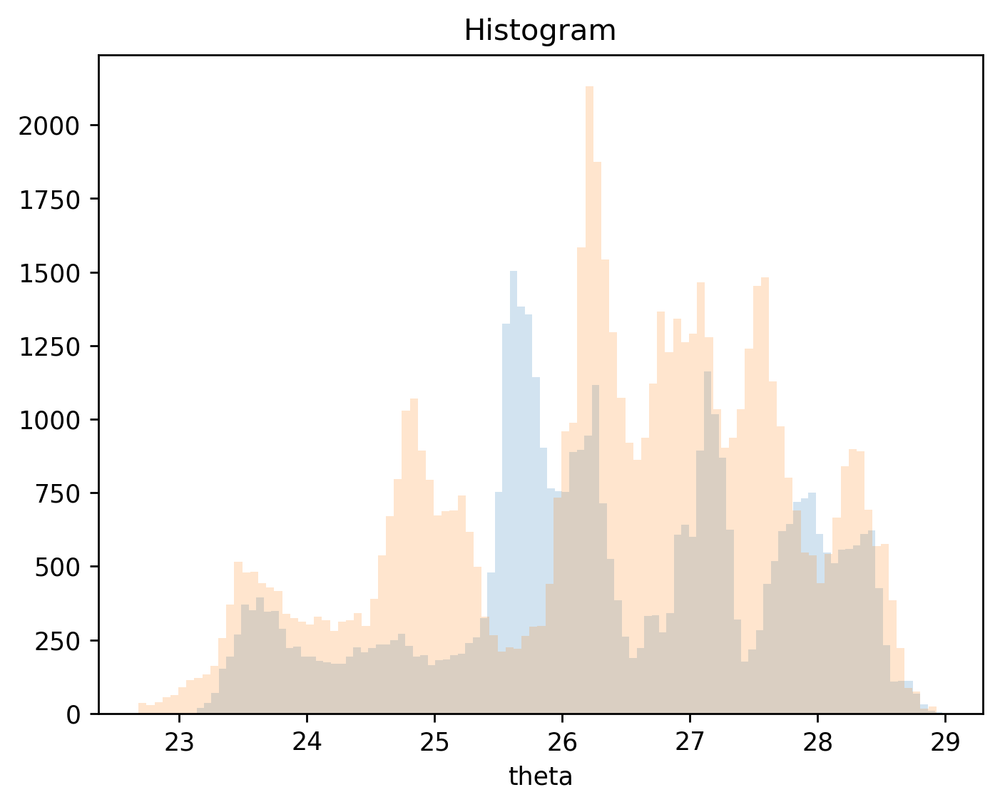

In [38]:
surf140.theta.where(tao0140.period == 1, drop=True).plot.hist(bins=100, alpha=0.2)
surf140.theta.where(tao0140.period == 3, drop=True).plot.hist(bins=100, alpha=0.2)

In [ ]:
surf140.zeta.load()

KeyboardInterrupt: 

In [17]:
surf140.theta.latitude

<xarray.DataArray 'latitude' (latitude: 480)>
array([-12.      , -11.949896, -11.899791, ...,  11.899791,  11.949896,
        12.      ], dtype=float32)
Coordinates:
  * latitude   (latitude) float32 -12.0 -11.949896 -11.899791 ... 11.949896 12.0
    longitude  float32 -139.97998
    depth      float32 -0.5

KeyboardInterrupt: 

Error in callback <function install_repl_displayhook.<locals>.post_execute at 0x2b107c9fe6a8> (for post_execute):


KeyboardInterrupt: 

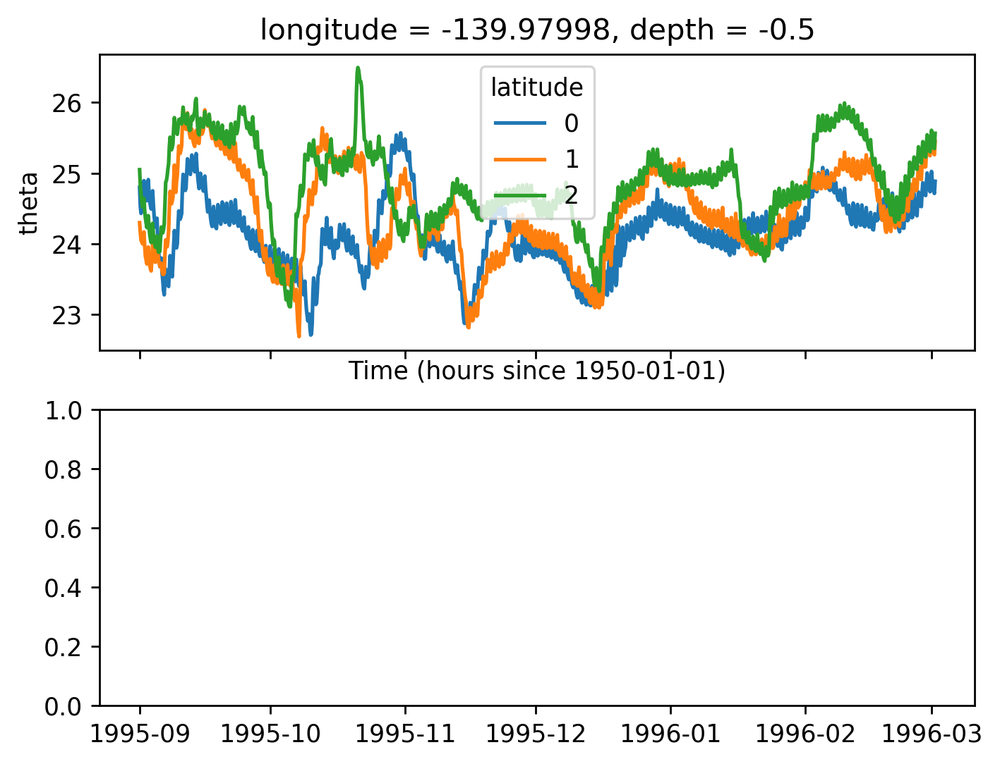

In [27]:
f, ax = plt.subplots(2, 1, sharex=True)

(surf140.theta
 .sel(latitude=[0, 1, 2,], method="nearest")
 .assign_coords({'latitude': [0, 1, 2, ]})
 .sel(time=slice(None, "1996-03-01"))
 # .where(tao0140.period.isin([1,  3, 5]))
 .plot(hue="latitude", ax=ax[0]))

(surf140.zeta
 .sel(latitude=[0, 1, 2,], method="nearest")
 .assign_coords({'latitude': [0, 1, 2, ]})
 .sel(time=slice(None, "1996-03-01"))
 # .where(tao0140.period.isin([1,  3, 5]))
 .plot(hue="latitude", ax=ax[1]))

In [37]:
surf140.coords.to_dataset().drop("time")

<xarray.Dataset>
Dimensions:    (latitude: 480)
Coordinates:
    depth      float32 ...
  * latitude   (latitude) float32 -12.0 -11.949896 -11.899791 ... 11.949896 12.0
    longitude  float32 -139.97998
Data variables:
    *empty*
Attributes:
    title:              daily snapshot from 1/20 degree Equatorial Pacific MI...
    easting:            longitude
    northing:           latitude
    field_julian_date:  400296
    julian_day_unit:    days since 1950-01-01 00:00:00

In [25]:
(surf140.v * (surf140.theta - surf140.theta.mean("time"))).sel(latitude=0, method="nearest").plot(x="time")
(surf140.v.sel(latitude=0, method="nearest")).plot()

NameError: name 'surf140' is not defined

# erko

In [45]:
import glob

path = "/glade/collections/cdg/data/cesmLE/CESM-CAM5-BGC-LE/atm/proc/tseries/monthly/"
filea001 = glob.glob(
    path + "TS/b.e11.B20TRC5CNBDRD.f09_g16.001.cam.h0.TS.185001-200512.nc"
)
filea = sorted(
    glob.glob(path + "TS/b.e11.B20TRC5CNBDRD.f09_g16.*.cam.h0.TS.192001-200512.nc")
)
fileb = sorted(
    glob.glob(path + "TS/b.e11.BRCP85C5CNBDRD.f09_g16.*.cam.h0.TS.200601-208012.nc")
)
filec = sorted(
    glob.glob(path + "TS/b.e11.BRCP85C5CNBDRD.f09_g16.*.cam.h0.TS.208101-210012.nc")
)


def add_ensemble_number(ds):
    import os
    filename = os.path.basename(ds.encoding["source"])
    num = int(filename.split(".")[4])
    return ds.expand_dims(M=[num])


dsbc = xr.open_mfdataset(
    fileb + filec,
    preprocess=add_ensemble_number,
    combine="by_coords",
    parallel=True,
)

In [50]:
dsa = xr.open_mfdataset(
    filea,
    preprocess=add_ensemble_number,
    combine="by_coords",
    parallel=True,
    coords="minimal",
    data_vars="minimal",
    compat="override",
)
dsa

<xarray.Dataset>
Dimensions:              (M: 41, cosp_ht: 40, cosp_htmisr: 16, cosp_prs: 7, cosp_scol: 10, cosp_sr: 15, cosp_sza: 5, cosp_tau: 7, cosp_tau_modis: 6, ilev: 31, lat: 289, lev: 30, lon: 288, nbnd: 2, slat: 256, slon: 288, time: 1032)
Coordinates:
  * M                    (M) int64 2 3 4 5 6 7 8 ... 101 102 103 104 105 106 107
  * lat                  (lat) float64 -90.0 -89.06 -88.12 ... 88.12 89.06 90.0
  * slat                 (slat) float64 -89.53 -88.59 -87.64 ... 88.59 89.53
  * cosp_tau             (cosp_tau) float64 0.15 0.8 2.45 6.5 16.2 41.5 219.5
  * ilev                 (ilev) float64 2.255 5.032 10.16 ... 967.5 985.1 1e+03
  * cosp_sza             (cosp_sza) float64 0.0 15.0 30.0 45.0 60.0
  * cosp_ht              (cosp_ht) float64 240.0 720.0 ... 1.848e+04 1.896e+04
  * time                 (time) object 1920-02-01 00:00:00 ... 2006-01-01 00:00:00
  * cosp_scol            (cosp_scol) float64 1.0 2.0 3.0 4.0 ... 8.0 9.0 10.0
  * cosp_htmisr          (cosp_htmisr) float64 -99.0 0.25 0.75 ... 16.0 58.0
  * lev                  (lev) float64 3.643 7.595 14.36 ... 957.5 976.3 992.6
  * cosp_prs             (cosp_prs) float64 900.0 740.0 620.0 ... 245.0 90.0
  * cosp_sr              (cosp_sr) float64 0.605 2.1 4.0 ... 539.5 1.004e+03
  * cosp_tau_modis       (cosp_tau_modis) float64 0.8 2.45 ... 41.5 5.003e+04
  * slon                 (slon) float64 -0.625 0.625 1.875 ... 355.6 356.9 358.1
  * lon                  (lon) float64 0.0 1.25 2.5 3.75 ... 356.2 357.5 358.8
Dimensions without coordinates: nbnd
Data variables:
    hyam                 (M, lev) float64 dask.array<chunksize=(33, 30), meta=np.ndarray>
    hybm                 (M, lev) float64 dask.array<chunksize=(33, 30), meta=np.ndarray>
    hyai                 (M, ilev) float64 dask.array<chunksize=(33, 31), meta=np.ndarray>
    hybi                 (M, ilev) float64 dask.array<chunksize=(33, 31), meta=np.ndarray>
    cosp_prs_bnds        (M, cosp_prs, nbnd) float64 dask.array<chunksize=(33, 7, 2), meta=np.ndarray>
    cosp_tau_bnds        (M, cosp_tau, nbnd) float64 dask.array<chunksize=(33, 7, 2), meta=np.ndarray>
    cosp_ht_bnds         (M, cosp_ht, nbnd) float64 dask.array<chunksize=(33, 40, 2), meta=np.ndarray>
    cosp_sr_bnds         (M, cosp_sr, nbnd) float64 dask.array<chunksize=(33, 15, 2), meta=np.ndarray>
    cosp_htmisr_bnds     (M, cosp_htmisr, nbnd) float64 dask.array<chunksize=(33, 16, 2), meta=np.ndarray>
    cosp_tau_modis_bnds  (M, cosp_tau_modis, nbnd) float64 dask.array<chunksize=(33, 6, 2), meta=np.ndarray>
    P0                   (M) float64 nan nan nan nan nan ... nan nan nan nan nan
    date                 (M, time) float64 dask.array<chunksize=(33, 1032), meta=np.ndarray>
    datesec              (M, time) float64 dask.array<chunksize=(33, 1032), meta=np.ndarray>
    w_stag               (M, slat) float64 dask.array<chunksize=(33, 256), meta=np.ndarray>
    time_bnds            (M, time, nbnd) object dask.array<chunksize=(33, 1032, 2), meta=np.ndarray>
    date_written         (M, time) object dask.array<chunksize=(33, 1032), meta=np.ndarray>
    time_written         (M, time) object dask.array<chunksize=(33, 1032), meta=np.ndarray>
    ntrm                 (M) float64 nan nan nan nan nan ... nan nan nan nan nan
    ntrn                 (M) float64 nan nan nan nan nan ... nan nan nan nan nan
    ntrk                 (M) float64 nan nan nan nan nan ... nan nan nan nan nan
    ndbase               (M) float64 nan nan nan nan nan ... nan nan nan nan nan
    nsbase               (M) float64 nan nan nan nan nan ... nan nan nan nan nan
    nbdate               (M) float64 nan nan nan nan nan ... nan nan nan nan nan
    nbsec                (M) float64 nan nan nan nan nan ... nan nan nan nan nan
    mdt                  (M) float64 nan nan nan nan nan ... nan nan nan nan nan
    nlon                 (M, lat) float64 dask.array<chunksize=(33, 289), meta=np.ndarray>
    wnummax              (M, lat) float64 dask.array<chunksiz

In [51]:
cluster.close()

distributed.client - ERROR - Failed to reconnect to scheduler after 10.00 seconds, closing client
distributed.utils - ERROR - 
Traceback (most recent call last):
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/distributed/utils.py", line 662, in log_errors
    yield
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/distributed/client.py", line 1290, in _close
    await gen.with_timeout(timedelta(seconds=2), list(coroutines))
concurrent.futures._base.CancelledError
distributed.utils - ERROR - 
Traceback (most recent call last):
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/distributed/utils.py", line 662, in log_errors
    yield
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/distributed/client.py", line 1019, in _reconnect
    await self._close()
  File "/glade/u/home/dcherian/miniconda3/envs/dcpy/lib/python3.6/site-packages/distributed/client.py", line 1290, 

In [48]:
dsbc

<xarray.Dataset>
Dimensions:       (M: 33, ilev: 31, lat: 192, lev: 30, lon: 288, nbnd: 2, slat: 191, slon: 288, time: 1140)
Coordinates:
  * ilev          (ilev) float64 2.255 5.032 10.16 18.56 ... 967.5 985.1 1e+03
  * lat           (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
  * slon          (slon) float64 -0.625 0.625 1.875 3.125 ... 355.6 356.9 358.1
  * M             (M) int64 1 2 3 4 5 6 7 8 9 10 ... 25 26 27 28 29 30 31 32 33
  * slat          (slat) float64 -89.53 -88.59 -87.64 ... 87.64 88.59 89.53
  * lev           (lev) float64 3.643 7.595 14.36 24.61 ... 957.5 976.3 992.6
  * lon           (lon) float64 0.0 1.25 2.5 3.75 ... 355.0 356.2 357.5 358.8
  * time          (time) object 2006-02-01 00:00:00 ... 2101-01-01 00:00:00
Dimensions without coordinates: nbnd
Data variables:
    P0            (time, M) float64 1e+05 1e+05 1e+05 ... 1e+05 1e+05 1e+05
    TS            (M, time, lat, lon) float32 dask.array<chunksize=(1, 900, 192, 288), meta=np.ndarray>
    ch4vmr        (M, time) float64 dask.array<chunksize=(1, 900), meta=np.ndarray>
    co2vmr        (M, time) float64 dask.array<chunksize=(1, 900), meta=np.ndarray>
    date          (M, time) int32 dask.array<chunksize=(1, 900), meta=np.ndarray>
    date_written  (M, time) |S8 dask.array<chunksize=(1, 900), meta=np.ndarray>
    datesec       (M, time) int32 dask.array<chunksize=(1, 900), meta=np.ndarray>
    f11vmr        (M, time) float64 dask.array<chunksize=(1, 900), meta=np.ndarray>
    f12vmr        (M, time) float64 dask.array<chunksize=(1, 900), meta=np.ndarray>
    gw            (time, M, lat) float64 dask.array<chunksize=(900, 1, 192), meta=np.ndarray>
    hyai          (time, M, ilev) float64 dask.array<chunksize=(900, 1, 31), meta=np.ndarray>
    hyam          (time, M, lev) float64 dask.array<chunksize=(900, 1, 30), meta=np.ndarray>
    hybi          (time, M, ilev) float64 dask.array<chunksize=(900, 1, 31), meta=np.ndarray>
    hybm          (time, M, lev) float64 dask.array<chunksize=(900, 1, 30), meta=np.ndarray>
    mdt           (time, M) int32 1800 1800 1800 1800 ... 1800 1800 1800 1800
    n2ovmr        (M, time) float64 dask.array<chunksize=(1, 900), meta=np.ndarray>
    nbdate        (time, M) int32 20060101 20060101 ... 20060101 20060101
    nbsec         (time, M) int32 0 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0
    ndbase        (time, M) int32 0 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0
    ndcur         (M, time) int32 dask.array<chunksize=(1, 900), meta=np.ndarray>
    nlon          (time, M, lat) int32 dask.array<chunksize=(900, 1, 192), meta=np.ndarray>
    nsbase        (time, M) int32 0 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0
    nscur         (M, time) int32 dask.array<chunksize=(1, 900), meta=np.ndarray>
    nsteph        (M, time) int32 dask.array<chunksize=(1, 900), meta=np.ndarray>
    ntrk          (time, M) int32 1 1 1 1 1 1 1 1 1 1 1 ... 1 1 1 1 1 1 1 1 1 1
    ntrm          (time, M) int32 1 1 1 1 1 1 1 1 1 1 1 ... 1 1 1 1 1 1 1 1 1 1
    ntrn          (time, M) int32 1 1 1 1 1 1 1 1 1 1 1 ... 1 1 1 1 1 1 1 1 1 1
    sol_tsi       (M, time) float64 dask.array<chunksize=(1, 900), meta=np.ndarray>
    time_bnds     (M, time, nbnd) object dask.array<chunksize=(1, 900, 2), meta=np.ndarray>
    time_written  (M, time) |S8 dask.array<chunksize=(1, 900), meta=np.ndarray>
    w_stag        (time, M, slat) float64 dask.array<chunksize=(900, 1, 191), meta=np.ndarray>
    wnummax       (time, M, lat) int32 dask.array<chunksize=(900, 1, 192), meta=np.ndarray>
Attributes:
    Conventions:               CF-1.0
    source:                    CAM
    case:                      b.e11.BRCP85C5CNBDRD.f09_g16.001
    title:                     UNSET
    logname:                   mai
    host:                      ys5218
    Version:                   $Name$
    revision_Id:               $Id$
    initial_file:              b.e11.B20TRC5CNBDRD.f09_g16.001.cam.i.2006-01-...
    topography_file:           /glade/p/ces